# Recommendation Analysis - MovieLens/DDD

This notebook will train 3 recommendation algorithms on the MovieLens 25M rating data: NormalPredictor, TopPop, and SVD. We generate accuracy metrics for each algorithm's rating predictions and recommendations for 1000 randomly chosen users. We look at the prevalence of https://www.doesthedogdie.com/ warnings in the users' histories vs their top recommendations.

## Set Up

In [1]:
# Install necessary packages. Uncomment following lines if the packages are not included in your environment.

# !pip install numpy
# !pip install pandas
# !pip install surprise
# !pip install matplotlib
# !pip install seaborn

from surprise import accuracy, Dataset, Reader, SVD, NormalPredictor
# from surprise.model_selection import train_test_split
from sklearn.model_selection import train_test_split

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


### Load Relevant Data Frames

In [20]:
# user_id | work_id | rating
interaction_table = pd.read_csv("data/ml-ddd_interaction_table.csv")

# work_id | one-hot encoded warnings (Clear Yes, Clear No, Unclear, No Votes) | n_ratings | av_rating | user_ratings | all_warnings
work_metadata = pd.read_csv("data/ml-ddd_sensitivity_table.csv")

### Select 1000 Random Users
These users will be used to generate recommendations for throughout the analysis

In [12]:
np.random.seed(42)
random_users = np.random.choice(interaction_table['user_id'].unique(), 1000, replace=False)

# Dictionary user_id : set(work_ids)
random_user_works_dict = {user : set(interaction_table[interaction_table["user_id"] == user]["work_id"].values) for user in random_users}

# Subset of user interaction dataframe for users in the 1000 randomly selected group
interaction_table_subset = interaction_table[interaction_table["user_id"].isin(random_user_works_dict.keys())]

### Initialize Surprise Tools

In [22]:
# Initialize surprise reader to process ratings.csv, the entirety of the MovieLens25M interactions, into a surprise Dataset
reader = Reader(line_format="user item rating timestamp", sep=',', rating_scale=(0.5, 5.0), skip_lines=1)

# Load the data into a 90-10 train-test split
data = Dataset.load_from_df(interaction_table[["user_id", "work_id", "rating"]], reader=reader)
full_trainset = data.build_full_trainset()

# Load user subset data to test on
data_subset = Dataset.load_from_df(interaction_table_subset, reader=reader).build_full_trainset()
data_subset_seen = data_subset.build_testset()

KeyboardInterrupt: 

### Helper Functions

In [ ]:
def get_liked_works(user_id, interactions_dict):
    """
    Gets the works liked by user_id. "Liked" is defined as having a rating in the top quartile of the user's ratings.
    """
    sorted_user_ratings = np.sort(interaction_table[interaction_table['user_id'] == user_id]['rating'])
    quartile_cutoff = np.percentile(sorted_user_ratings, 75)
    top_quartile_ratings = sorted_user_ratings[sorted_user_ratings >= quartile_cutoff]
    
    return set(top_quartile_ratings)


def metrics_at_k(recommendations, interactions_dict):
    """
    Calculates the Precision@k and Recall@k for the given recommendations with respect to the user histories in interactions_dict.
    Args:
        recommendations: dictionary of user_id : [recs].
        interactions_dict: dictionary of user_id : [work_ids]. Ground truth interactions. user_ids are the same as in recommendations.
    Returns:
        Precision@k = num recommended items @k that are relevant (i.e. were liked by user) / k.
        Recall@k = num recommended items @ k that are relevant (i.e. were liked by user) / num relevant items.
    
    """
    precisions = []
    recalls = []
    for user in random_users:
        liked_works = get_liked_works(user, interactions_dict)
        user_recs = recommendations[user]
        hits = liked_works.intersection(user_recs)
        precision = len(hits)/len(user_recs)
        recall = len(hits)/len(liked_works) if len(liked_works) > 0 else 0
        precisions.append(precision)
        recalls.append(recall)
    
    return sum(precisions)/len(precisions), sum(recalls)/len(recalls)


def train_test_split_user(df, test_size=0.1):
    """
    Splits df into a 90-10 train-test split from a user perspective.
    90% of each user's interactions are in the trainset and the other 10% are in the testset.
    """
    train_list = []
    test_list = []
    
    grouped = df.groupby('user_id')
    
    for user_id, group in grouped:
        train, test = train_test_split(group, test_size=test_size, random_state=36)
        train_list.append(train)
        test_list.append(test)
    
    # Concatenate all the train and test DataFrames
    train_df = pd.concat(train_list).reset_index(drop=True)
    test_df = pd.concat(test_list).reset_index(drop=True)
    
    return train_df, test_df

## Model Training

Create 90-10 train-test split of user interactions to generate accuracy metrics. The split is made with respect to each user, so 90% of a users ratings appear in the trainset and 10% appear in the testset.

In [ ]:
train_interactions, test_interactions = train_test_split_user(interaction_table)

In [ ]:
train_user_works_dict = train_interactions.groupby('user_id')['work_id'].apply(set).to_dict()
test_user_works_dict = test_interactions.groupby('user_id')['work_id'].apply(set).to_dict()

### Top Pop Algorithm
This algorithm recommends users the most popular works in the dataset. We consider popularity from an engagement stand point, ranking the most popular movies as those that have received the most ratings.

In [ ]:
def gen_top_pop_recs(top_pop_algo, k, interactions_dict, remove_seen):
    """
    Generates top k recommendations for the top pop algorithm.
    Args:
        top_pop_algo: list of potential works to recommend sorted by popularity in descending order (i.e. index 0 is most popular).
        k: number of recs to generate per user.
        interactions_dict: dictionary of user : [work_ids], the history of interactions for each user. Recommendations will be generated for the users in this dict.
        remove_seen: if True, do not include a user's historical interactions (i.e. interactions_dict[user_id]) in their recs.
    Returns:
        top_pop_recs: dictionary of user : [recommended work_ids], the k top recs for each user.
    """
    top_pop_recs = {}
    for user_id, seen_works in interactions_dict.items():
        if remove_seen:
            top_pop_recs[user_id] = []
            for i in range(len(top_pop_algo)):
                if top_pop_algo[i] not in seen_works:
                    top_pop_recs[user_id].append(top_pop_algo[i])
                if len(top_pop_recs[user_id]) == k:
                    break
        else:
            top_pop_recs[user_id] = top_pop_algo[:k]
    return top_pop_recs

Generate Precision, Recall, and F1 scores on the test split.

In [ ]:
# Group the ratings DataFrame by work_id and count the number of ratings for each work
work_ratings_count = interaction_table.groupby('work_id').size().reset_index(name='ratings_count')

# Sort the works based on the number of ratings in descending order to find the most popular works
top_popular_works = work_ratings_count.sort_values(by='ratings_count', ascending=False)['work_id']

# Store the sorted list of popular works as the Top Pop model
top_pop_algo = top_popular_works.tolist()

# Recommend k top ranked works to all users. 
# Remove seen is true so recs don't include items the user saw in the trainset. Evaluate recs against testset.
for k in [10, 50, 100]:
    top_pop_recs_test = gen_top_pop_recs(top_pop_algo, k, train_user_works_dict, True)
    precision, recall = metrics_at_k(top_pop_recs_test, test_user_works_dict)
    if recall + precision > 0:
        f1 = 2*recall*precision / (recall + precision)
    else:
        f1 = 0
    print(f"Precision@k={k}: {precision}")
    print(f"Recall@k={k}: {recall}")
    print(f"F1@k={k}: {f1}\n")

Precision@k=10: 0.0001
Recall@k=10: 0.0005

Precision@k=50: 2e-05
Recall@k=50: 0.0005

Precision@k=100: 2e-05
Recall@k=100: 0.00075



Train the algorithm on the entire dataset and generate recommendations for the 1000 users that do not appear in their history.

In [6]:
top_pop_recs = gen_top_pop_recs(top_pop_algo, 100, random_user_works_dict, True)

NameError: name 'gen_top_pop_recs' is not defined

### Random Algorithm
The Random recommendation algorithm chooses works from the interaction table at random following a uniform distribution.

In [11]:
def gen_random_recs(k, interactions_df, interactions_dict, remove_seen):
    """
    Generates k random recommendations for all users.
    Args:
        k: number of recs to generate per user.
        interactions_df: dataframe of user_id | work_id | rating. Defines potential work_ids for recommendation.
        interactions_dict: dictionary of user : [work_ids], the history of interactions for each user. Recommendations will be generated for the users in this dict.
        remove_seen: if True, do not include a user's historical interactions (i.e. interactions_dict[user_id]) in their recs.
    Returns:
        random_recs: dictionary of user : [recommended work_ids], the k random recs for each user.
    """
    random_recs = {}
    candidate_works = interactions_df["work_id"].unique()
    if remove_seen:
        for user_id, seen_works in interactions_dict.items():
            works_for_rec = list(set(candidate_works) - seen_works)
            random_recs[user_id] = set(np.random.choice(works_for_rec, size=k, replace=False))
    else:
        for user_id in interactions_dict.keys():
            random_recs[user_id] = set(np.random.choice(candidate_works, size=k, replace=False))
    return random_recs

Generate Precision, Recall, and F1 scores on the test split.

In [12]:
for k in [10, 50, 100]:
    # Recommend works not seen in the trainset
    test_random_recs = gen_random_recs(k, interaction_table, train_user_works_dict, True)
    # Evaluate on works in the testset
    precision, recall = metrics_at_k(test_random_recs, test_user_works_dict)
    if recall + precision > 0:
        f1 = 2*recall*precision / (recall + precision)
    else:
        f1 = 0
    print(f"Precision@k={k}: {precision}")
    print(f"Recall@k={k}: {recall}")
    print(f"F1@k={k}: {f1}\n")

Precision@k=10: 0.0001
Recall@k=10: 0.0005
F1@k=10: 0.00016666666666666666

Precision@k=50: 0.00012
Recall@k=50: 0.0026666666666666666
F1@k=50: 0.00022966507177033495

Precision@k=100: 4e-05
Recall@k=100: 0.0021666666666666666
F1@k=100: 7.85498489425982e-05



In [13]:
# Recommend 100 unseen works to the 1000 random users for analysis
random_recs = gen_random_recs(100, interaction_table, random_user_works_dict, True)

### Singular Value Decomposition (SVD) Algorithm
SVD is a model-based collaborative filtering recommendation method. We use the Surprise library implementation based on Simon Funk's method from the Netflix recommendation system contest https://surprise.readthedocs.io/en/stable/matrix_factorization.html

In [14]:
def gen_rating_table(algo):
    """
    Generates a rating table for a surprise recommendation algorithm.
    
    Args:
        algo: surprise recommendation algorithm.
    Returns:
        rating_table: pandas dataframe. Indices represent each user_id and there is a column for each work_id.
        Each cell contains the algorithm's predicted rating for user_id interacting with work_id.
    """
    # Create an empty DataFrame with user IDs as index and work IDs as columns
    rating_table = pd.DataFrame(index=random_users, columns=work_metadata['work_id'])

    # Apply predictions to each row of the rating_table
    for work_id in work_metadata['work_id']:
        rating_table[work_id] = rating_table.index.map(lambda user_id: algo.predict(str(user_id), str(work_id)).est)

    return rating_table


def gen_svd_recs(rating_table, k, interactions_dict, remove_seen):
    """
    Generates top k recommendations for each user in random_users.
    Args:
        rating_table: output from gen_rating_table. The work_id columns represent potential works to recommend.
        k: number or recommendations to generate for each user.
        interactions_dict: dictionary of user_id : [work_ids]. Ground truth historical interactions. Recs will be generated for all user_ids in the dict.
        remove_seen: if True, do not include works a user has already interacted with (i.e. interactions_dict[user_id]) in their recommendations.
    Returns:
        recs: dictionary of user_id : [recommended work_ids].
    """
    recs = {}
    for user_id, seen_works in interactions_dict.items():
        if remove_seen:
            masked_rating_table = rating_table.copy()
            masked_rating_table.loc[user_id, seen_works] = float('nan')
            recs[user_id] = masked_rating_table.loc[user_id].sort_values(ascending=False).head(k).index
        else:
            recs[user_id] = rating_table.loc[user_id].sort_values(ascending=False).head(k).index
    return recs

In [15]:
# Load the train and test sets into Surprise data objects
train_data = Dataset.load_from_df(train_interactions, reader=reader)
surprise_trainset = train_data.build_full_trainset()

test_data = Dataset.load_from_df(test_interactions, reader=reader).build_full_trainset()
surprise_testset = test_data.build_testset()

In [16]:
# Train the algorithm on the trainset
test_svd_algo = SVD(n_factors=100, n_epochs=100, lr_all=0.003, reg_all=0.04, biased=False)
test_svd_algo.fit(surprise_trainset)

# Test predictive accuracy on testset
predictions = test_svd_algo.test(surprise_testset)
accuracy.rmse(predictions)
accuracy.mae(predictions)
accuracy.mse(predictions)

RMSE: 0.7625
MAE:  0.5801
MSE: 0.5814


0.5813526921074872

In [17]:
test_svd_rating_table = gen_rating_table(test_svd_algo)

In [18]:
# Recommend k top ranked works to all users for classification accuracy metrics
# remove_seen is True so recommendations are unseen to the trainset and then evaluated against the testset.
for k in [10, 50, 100]:
    svd_recs_test = gen_svd_recs(test_svd_rating_table, k, random_user_works_dict, True)
    precision, recall = metrics_at_k(svd_recs_test, test_user_works_dict)
    if recall + precision > 0:
        f1 = 2*recall*precision / (recall + precision)
    else:
        f1 = 0
    print(f"Precision@k={k}: {precision}")
    print(f"Recall@k={k}: {recall}")
    print(f"F1@k={k}: {f1}\n")

Precision@k=10: 0.0021000000000000007
Recall@k=10: 0.008483333333333332
F1@k=10: 0.0033666141732283474

Precision@k=50: 0.0004400000000000001
Recall@k=50: 0.008816666666666667
F1@k=50: 0.0008381706877925822

Precision@k=100: 0.00022000000000000006
Recall@k=100: 0.008816666666666667
F1@k=100: 0.0004292880855772779



Retrain on the full dataset to generate recommendations used for the warning analysis.

In [19]:
# Retrain on the entire dataset
svd_algo = SVD(n_factors=100, n_epochs=100, lr_all=0.003, reg_all=0.04, biased=False)
svd_algo.fit(full_trainset)

# Test on 1000 user subset interactions
predictions = svd_algo.test(data_subset_seen)
accuracy.rmse(predictions)
accuracy.mae(predictions)
accuracy.mse(predictions)

RMSE: 0.6733
MAE:  0.5194
MSE: 0.4533


0.4533090252273892

In [20]:
svd_rating_table = gen_rating_table(svd_algo)

In [22]:
# Recommend 100 unseen works for analysis
svd_recs = gen_svd_recs(svd_rating_table, 100, random_user_works_dict, True)

## Warning Analysis

In [23]:
warnings = set()
for col in work_metadata.columns:
    if len(col) > 11 and col[:11] == "Clear Yes: ":
        warnings.add(col[11:])
warnings

{'Are animals abused',
 'Are any teeth damaged',
 'Are needles/syringes used',
 'Are there "Man in a dress" jokes',
 'Are there 9/11 depictions',
 'Are there abortions',
 'Are there anxiety attacks',
 'Are there babies or unborn children',
 'Are there bugs',
 'Are there clowns',
 'Are there fat jokes',
 'Are there fat suits',
 'Are there flashing lights or images',
 'Are there ghosts',
 'Are there homophobic slurs',
 'Are there incestuous relationships',
 'Are there jumpscares',
 'Are there mannequins',
 'Are there n-words',
 'Are there nude scenes',
 'Are there razors',
 'Are there snakes',
 'Are there spiders',
 'Does a baby cry',
 'Does a car crash',
 'Does a car honk or tires screech',
 'Does a cat die',
 'Does a dragon die',
 'Does a head get squashed',
 'Does a horse die',
 'Does a kid die',
 'Does a non-human character die',
 'Does a parent die',
 'Does a pet die',
 'Does a plane crash',
 'Does a pregnant person die',
 'Does an LGBT person die',
 'Does an animal die',
 'Does it 

### Graph Generation Functions

In [73]:
plt.rcParams.update({'font.size': 16})

def amplification_dfs(top_recommendations):
    warning_data_maps = {"warning": [], "data": []}
    for warning in warnings:
        warning_data_maps["warning"].append(warning)
        data = {'user_id': [], 'amplification_scores': [], 'history_warnings': [], 'recs_warnings': []}
        
        for user_id, work_ids in random_user_works_dict.items():
            # Count the fraction of works in user's history with warning
            user_history_warning_fraction = sum(work_metadata[work_metadata['work_id'].isin(work_ids)][f'Clear Yes: {warning}'])/(len(work_ids))

            # Count the fraction of works in user's top recommendations with warning
            try:
                user_recs_warning_fraction = sum(work_metadata[work_metadata['work_id'].isin(set(top_recommendations[user_id].astype(int)))][f'Clear Yes: {warning}']) / len(top_recommendations[user_id].astype(int))
            except:
                user_recs_warning_fraction = sum(work_metadata[work_metadata['work_id'].isin(set(top_recommendations[user_id]))][f'Clear Yes: {warning}']) / len(top_recommendations[user_id])

            # Calculate the ratio and append the data to the dictionary. Subtract 1 to normalize: amplification score = 0 means same fraction in both recs and history
            if user_history_warning_fraction == 0:
                # Hallucinate an item with the warning to avoid div by zero
                data["amplification_scores"].append(user_recs_warning_fraction/(1/len(top_recommendations[user_id])) - 1)
            else:
                data["amplification_scores"].append(user_recs_warning_fraction/user_history_warning_fraction - 1)
            data["user_id"] = user_id
            data["history_warnings"].append(user_history_warning_fraction)
            data["recs_warnings"].append(user_recs_warning_fraction)
        warning_data_maps["data"].append(data)
    return pd.DataFrame(warning_data_maps)


def single_warning_amplification(warning, warning_data_maps, name="", color="purple", xlim=4):
    data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])
    av_amp = data["amplification_scores"].mean()
    print(f"{name} av amp for {warning}: {av_amp}")
    fig, ax = plt.subplots(figsize=(6,6))
    ax.axvline(x = 0, ymin = 0, ymax = 1, color="black", linestyle="dashed")
    ax.set_xlim(-1, xlim)
    ax.text(0.75, 0.75, f"Av score: \n{av_amp:2f}", transform = ax.transAxes, fontsize=16)
    sns.histplot(data=data["amplification_scores"], bins=20, kde=True, line_kws={'lw':5}, color=color, label='Amplification Scores', alpha=0.3)
    plt.title(f'ML-DDD: {name} {warning} \nAmplification Scores', fontsize=18)
    plt.xlabel(f'Amplification of {warning}', fontsize=14)
    plt.ylabel('Frequency', fontsize=14)
#     plt.legend()
    fig = plt.gcf()
    plt.show()
    plt.close()
                                          

def warning_distribution_plots(warning_data_maps):
    for warning in warnings:
        data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])

        fig, ax = plt.subplots()
        sns.histplot(data=data["history_warnings"], bins=20, kde=True, color='blue', label='User History', alpha=0.5)
        sns.histplot(data=data["recs_warnings"], bins=20, color='red', label='Top Recommendations', alpha=0.5)
        plt.title(f'{warning} in History vs Recommendations')
        plt.xlabel(f'Percent of Works with {warning}')
        plt.ylabel('Frequency')
        plt.legend()
        fig = plt.gcf()
        plt.show()
        plt.close()


def warning_amplification_plots(warning_data_maps):
    for warning in warnings:
        single_warning_amplification(warning, warning_data_maps)
        

def user_amplification_plots(warning_data_maps):
    summed_amplifications = np.zeros(len(random_user_works_dict))
    for warning in warnings:
        data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])
        summed_amplifications += np.array(data["amplification_scores"])
        
    fig, ax = plt.subplots()
    sns.histplot(data=summed_amplifications/len(warnings), bins=20, kde=True, color='green', label='Average Amplification', alpha=0.5)
    plt.title('Average Warning Amplification Over All Users')
    plt.xlabel(f'Average Amplification')
    plt.ylabel('Frequency')
    plt.legend()
    fig = plt.gcf()
    plt.show()
    plt.close()
    

def overlay_user_amplifications(dms):
    fig, ax = plt.subplots()
    for name, warning_data_maps, color in dms:
        summed_amplifications = np.zeros(len(random_user_works_dict))
        for warning in warnings:
            data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])
            summed_amplifications += np.array(data["amplification_scores"])
        print(f"{name} av amp: {summed_amplifications.sum()/(len(warnings)*len(random_user_works_dict))}")
        sns.histplot(data=summed_amplifications/len(warnings), bins=20, kde=True, edgecolor=color, line_kws={'lw':3}, label=f'{name}', color=color, alpha=0.3)
    ax.axvline(x = 0, ymin = 0, ymax = 1, color="black", linestyle="dashed")
    plt.title('ML/DDD: User Average Amplification Scores \nOver All Warnings', fontsize=18)
    plt.xlabel(f'Average Amplification', fontsize=14)
    plt.xlim(-1, 2)
    plt.ylabel('Frequency', fontsize=14)
    plt.legend(fontsize=14)
    fig = plt.gcf()
    plt.show()
    plt.close()

    
def overlay_single_warning_amps(warning, dms):
    fig, ax = plt.subplots()
    for name, warning_data_maps, color in dms:
        data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])
        sns.histplot(data=data["amplification_scores"], bins=20, kde=True, color=color, label=f'{name}', alpha=0.5)
        av_amp = data["amplification_scores"].mean()
        print(f"{name} av amp for {warning}: {av_amp}")
    ax.axvline(x = 1, ymin = 0, ymax = 1, color="black", linestyle="dashed")
    ax.set_xlim(0, 6)
    plt.title(f'{warning} Amplification Scores')
    plt.xlabel(f'Amplification of {warning}')
    plt.ylabel('Frequency')
    plt.legend()
    fig = plt.gcf()
    plt.show()
    plt.close()

### Top Pop Algorithm

In [25]:
top_pop_amplification_dfs = amplification_dfs(top_pop_recs)

 av amp for Is there blood/gore: 0.2881515170635059


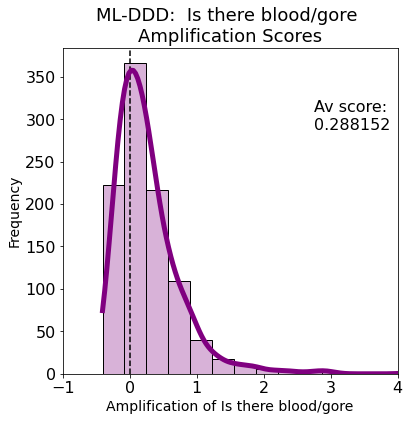

In [54]:
single_warning_amplification("Is there blood/gore", top_pop_amplification_dfs)

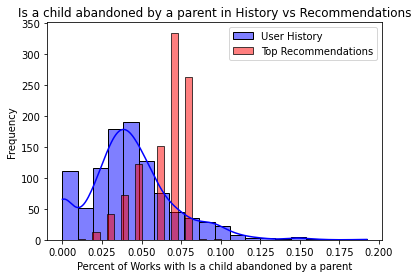

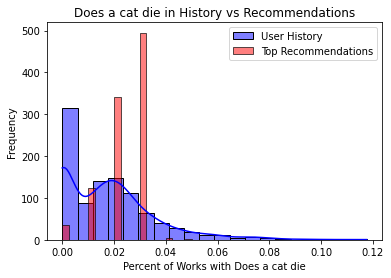

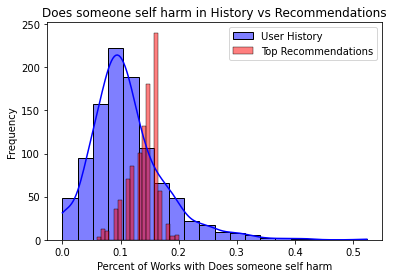

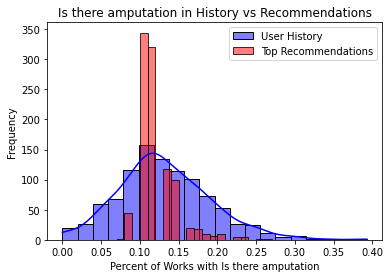

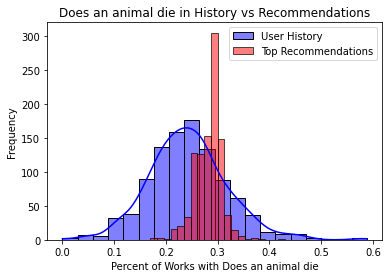

...

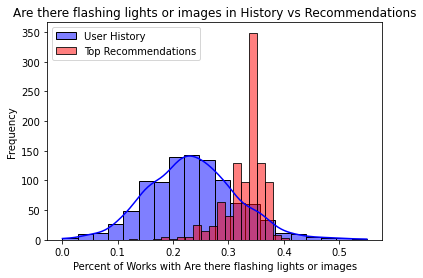

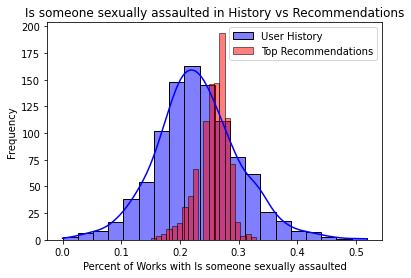

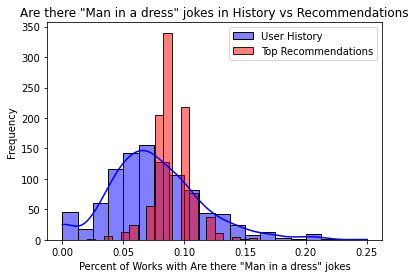

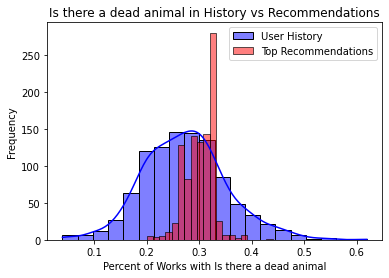

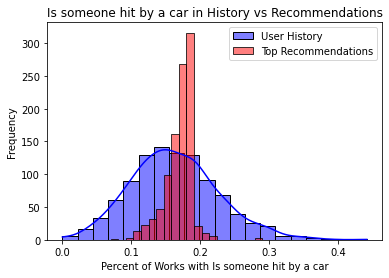

In [30]:
warning_distribution_plots(top_pop_amplification_dfs)

 av amp for Is a child abandoned by a parent: 1.3828817369201132


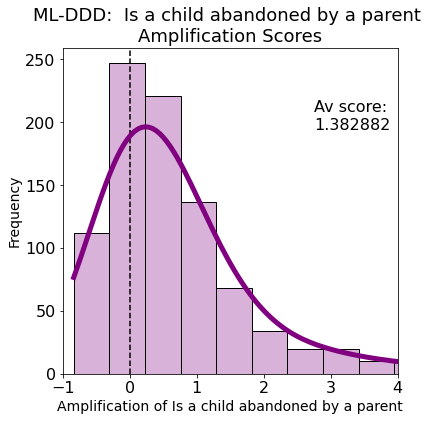

 av amp for Does a cat die: 0.7082778444866151


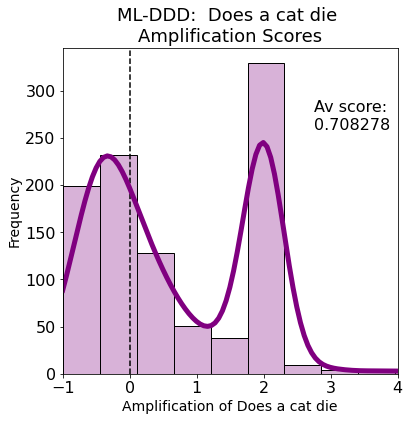

 av amp for Does someone self harm: 1.2244344777489564


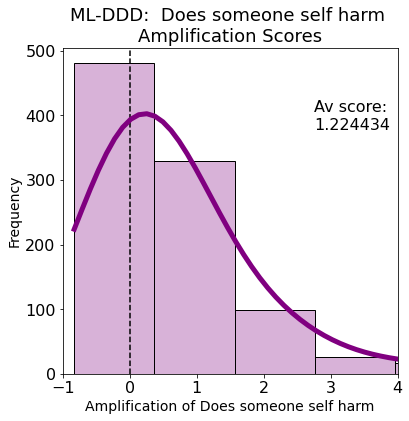

 av amp for Is there amputation: 0.37293153721836153


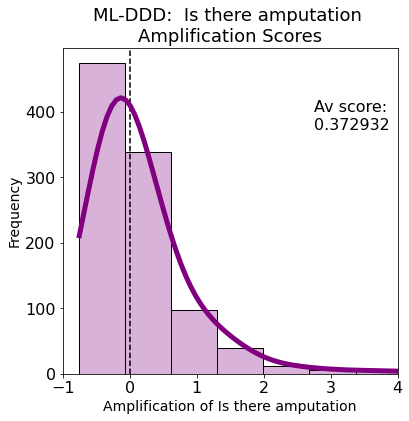

 av amp for Does an animal die: 0.39754929863452365


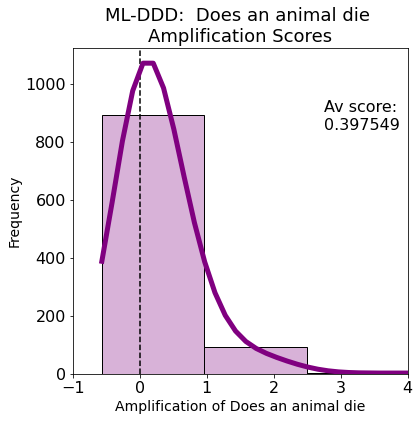

 av amp for Does someone overdose: 0.723803305724372


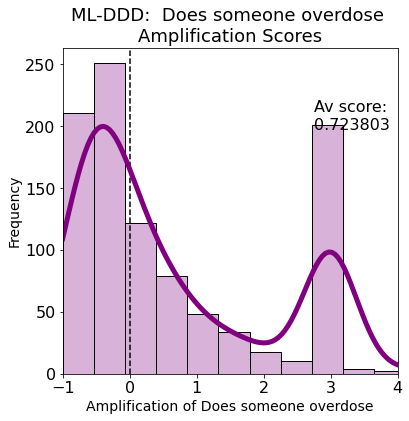

 av amp for Are there snakes: 0.8731183014988517


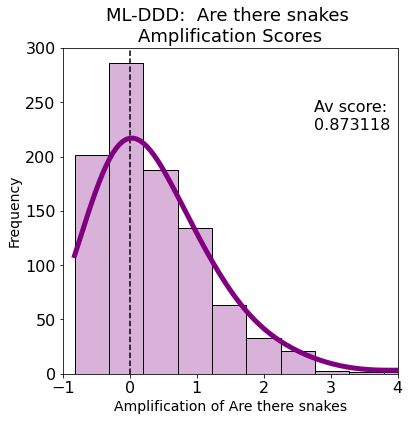

 av amp for Is there Achilles Tendon injury: -0.09741299999999996


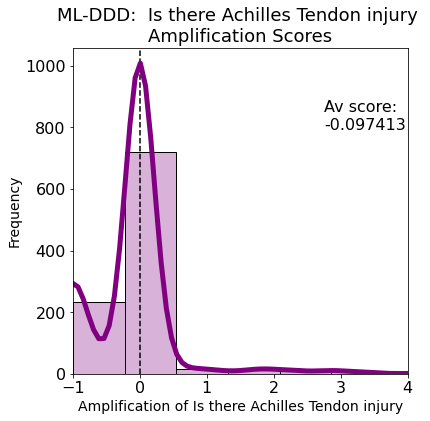

 av amp for Is there a large age gap: 0.8318792805665639


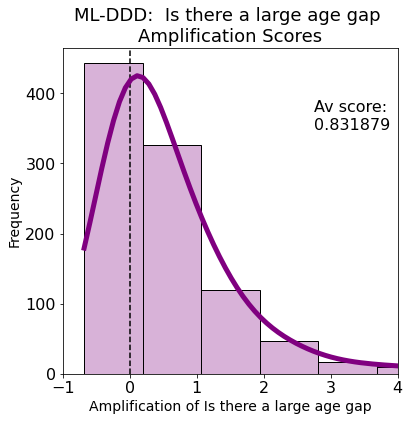

 av amp for Does someone becomes unconscious: 1.6264656788018295


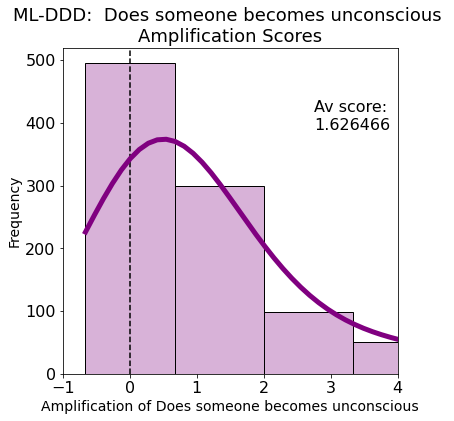

 av amp for Is a baby stillborn: -0.968835


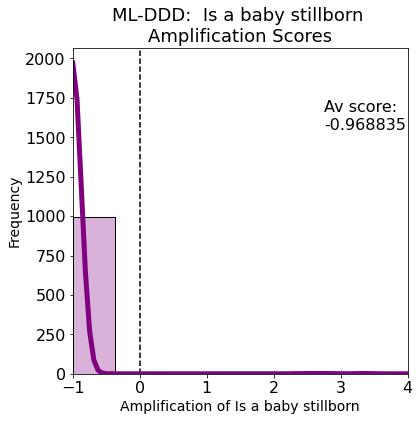

 av amp for Is there eye mutilation: 1.0181483177260757


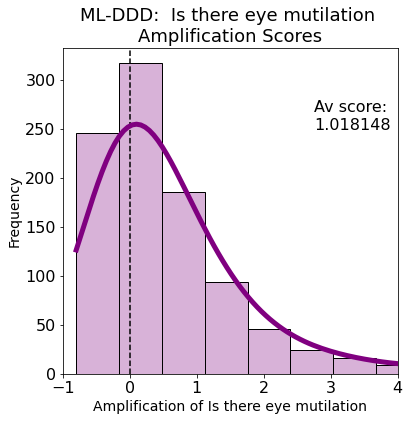

 av amp for Does someone cheat: 0.14650433880123942


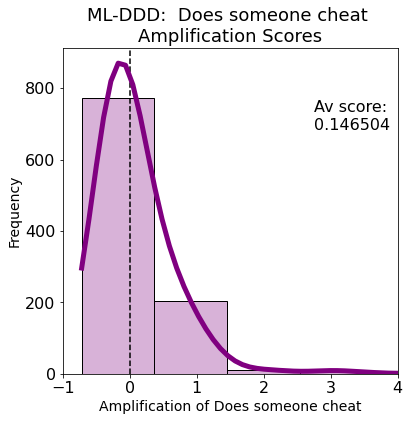

 av amp for Are there 9/11 depictions: 0.5884887619047616


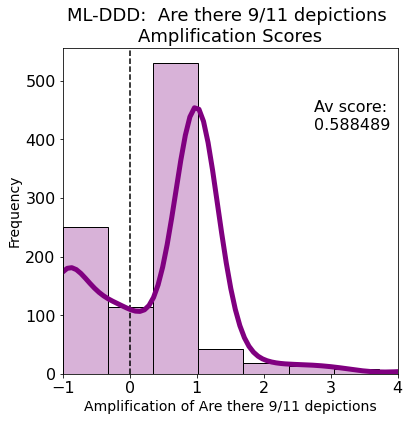

 av amp for Is there childbirth: 0.10184543726623306


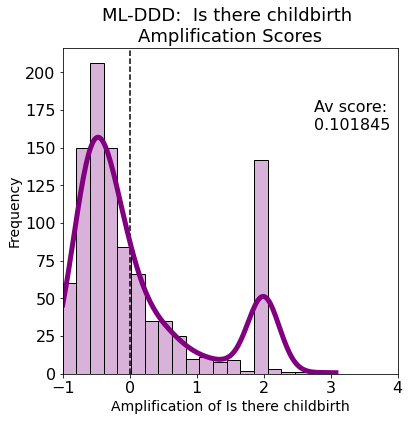

 av amp for Is someone misgendered: 0.6320487981205318


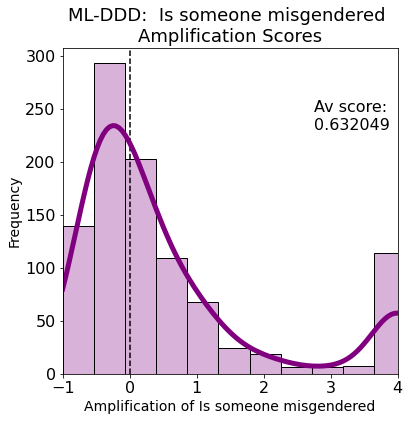

 av amp for Is a minority is misrepresented: 1.6212773230535322


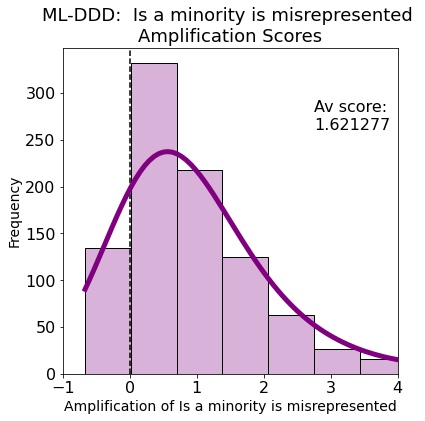

 av amp for Are there fat jokes: 0.3152335274610466


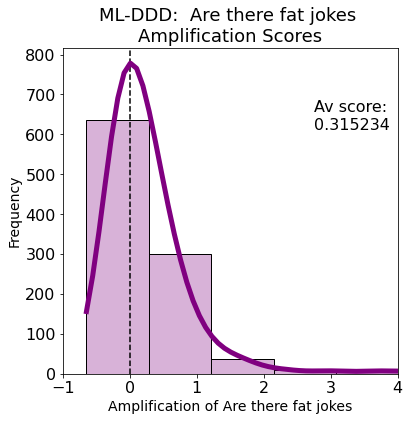

 av amp for Are there anxiety attacks: 0.9954796510401981


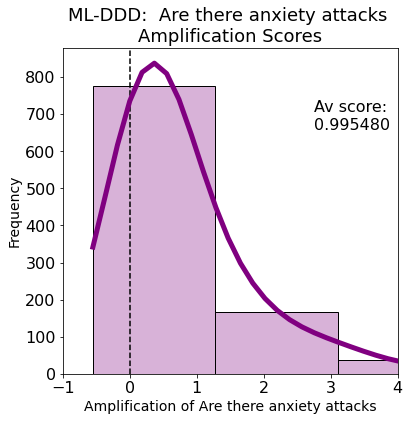

 av amp for Are there spiders: 1.4351171069762965


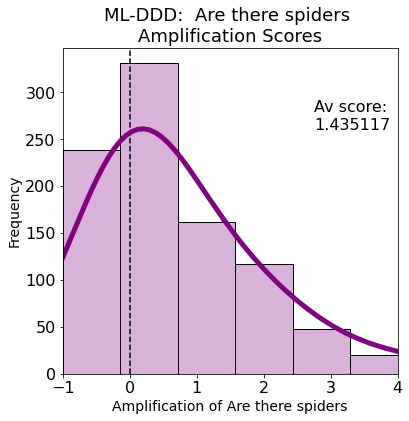

 av amp for Does a car crash: 0.4754362714814953


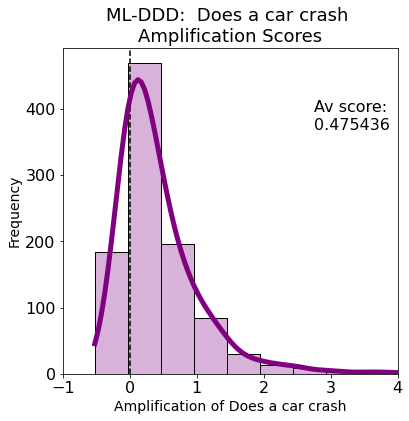

 av amp for Is there domestic violence: 0.6369345964839002


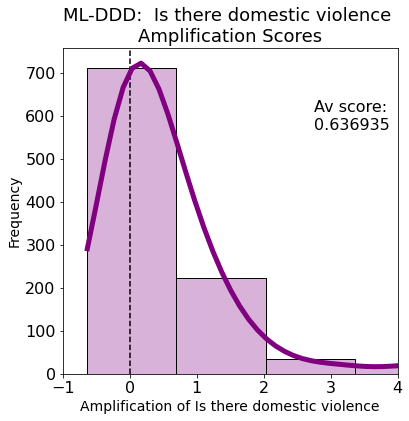

 av amp for Does someone struggle to breathe: 0.5341566978092952


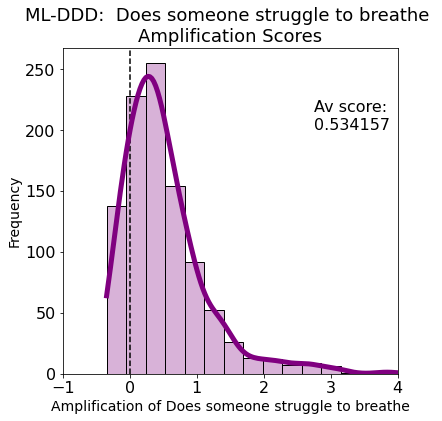

 av amp for Does the abused become the abuser: -0.2053316666666667


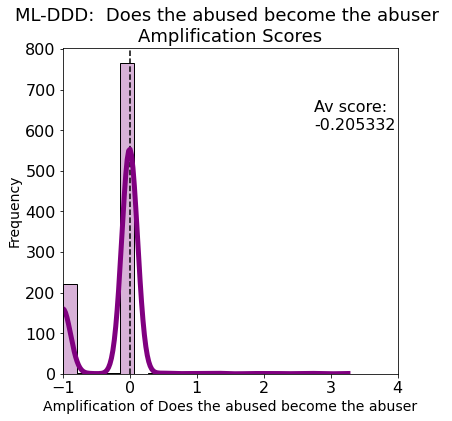

 av amp for Is there a mental institution scene: 1.416605971233157


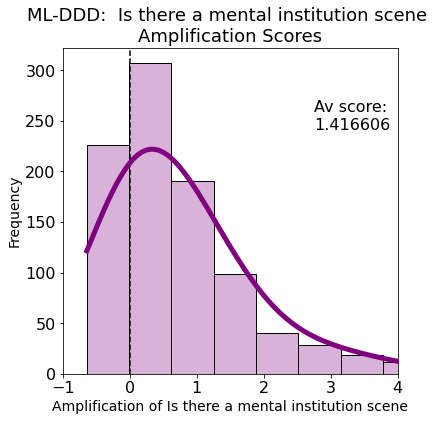

 av amp for Does someone asphyxiate: 1.4085559836554722


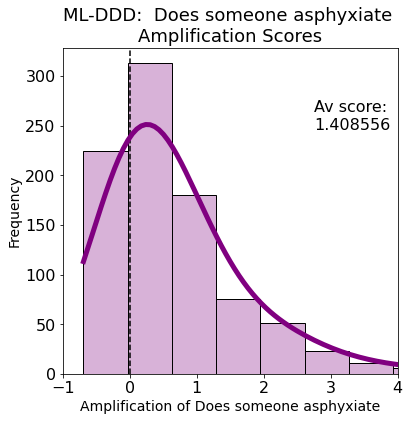

 av amp for Is a child abused: 0.6461972971496643


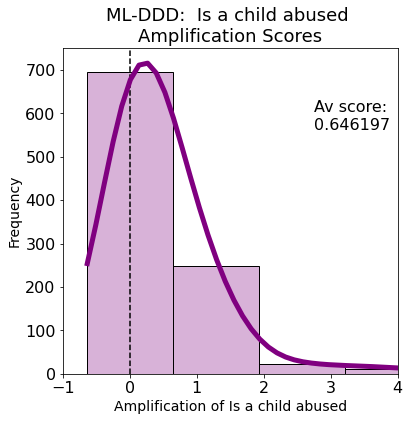

 av amp for Does someone miscarry: 0.05883548633169093


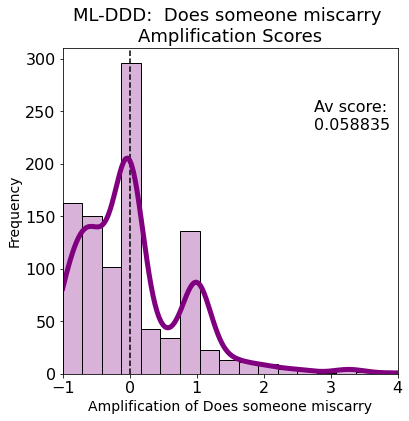

 av amp for Does a pet die: 0.7573723912023079


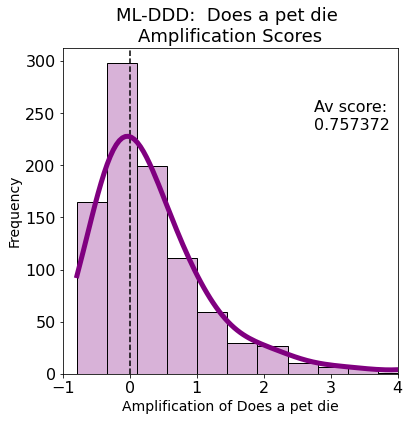

 av amp for Is someone possessed: 1.0092833861556407


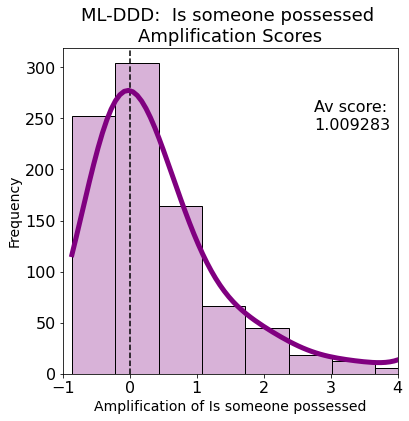

 av amp for Does someone have an eating disorder: -0.231167638082237


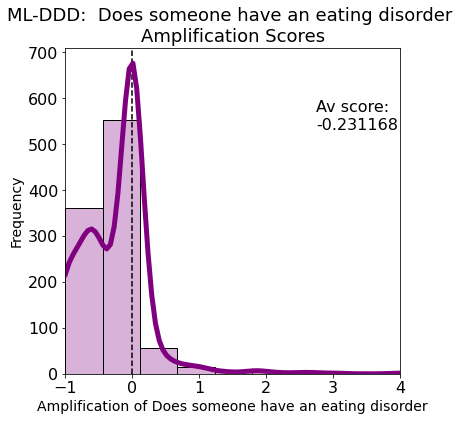

 av amp for Is there body dysphoria: -0.7658050000000001


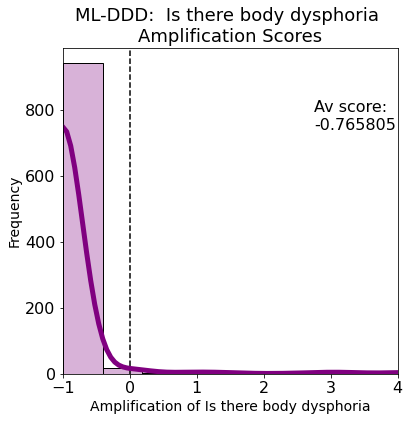

 av amp for Does a horse die: 0.9549664840230696


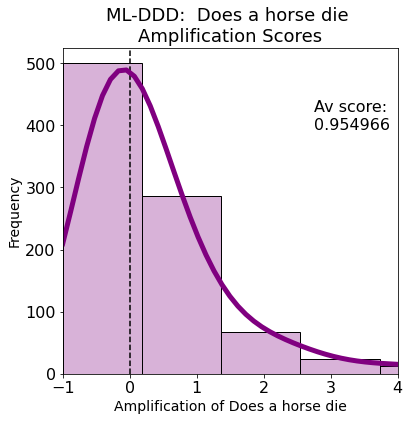

 av amp for Does someone attempt suicide: 1.3985726219738146


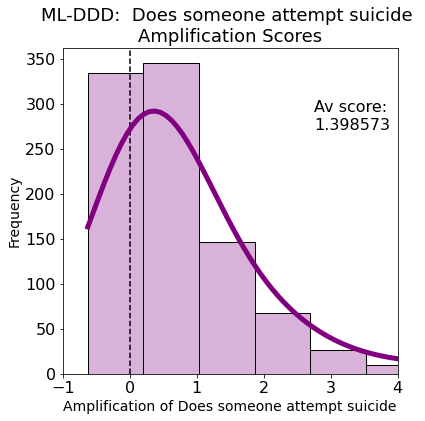

 av amp for Is there a claustrophobic scene: 0.6689269684977942


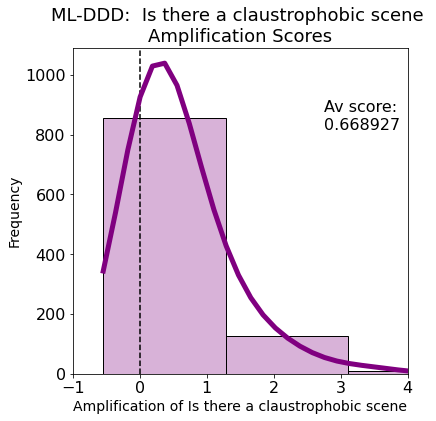

 av amp for Does someone wet/soil themselves: 1.725077296487789


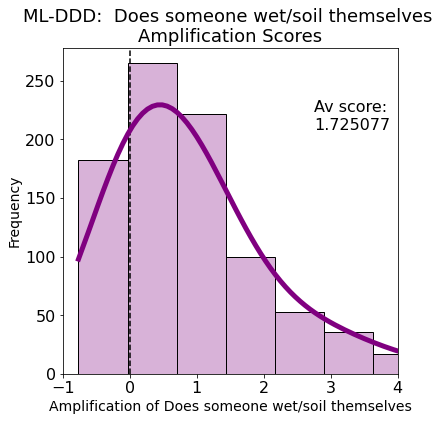

 av amp for Is there obscene language/gestures: 1.2698884479640171


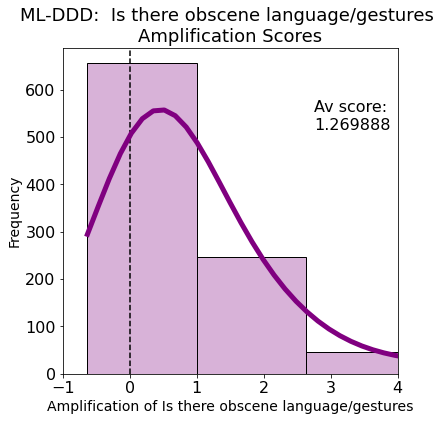

 av amp for Is there shakey cam: 0.7563436249073686


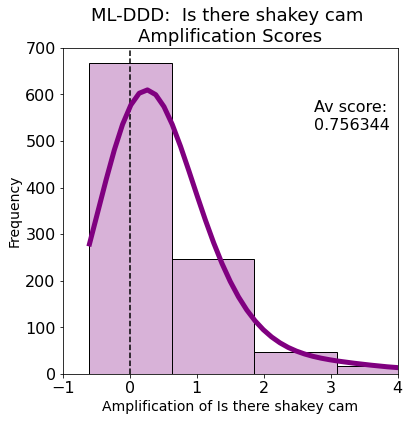

 av amp for Is there misophonia: 1.0675074780754021


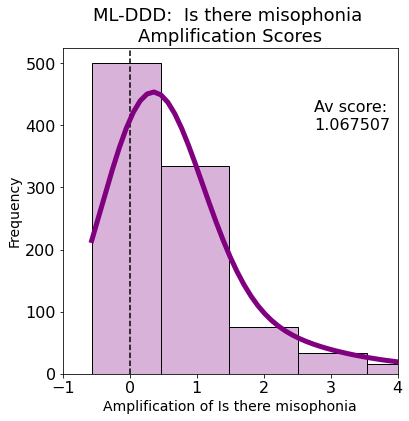

 av amp for Is there a hanging: 0.9298608250024741


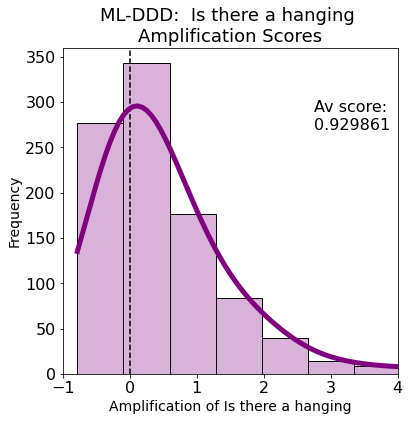

 av amp for Is there blood/gore: 0.2881515170635059


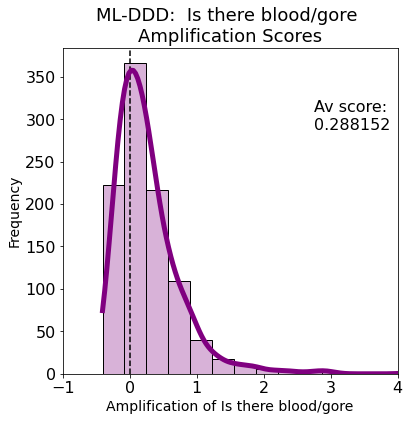

 av amp for Is there genital trauma/mutilation: 0.9860833207078734


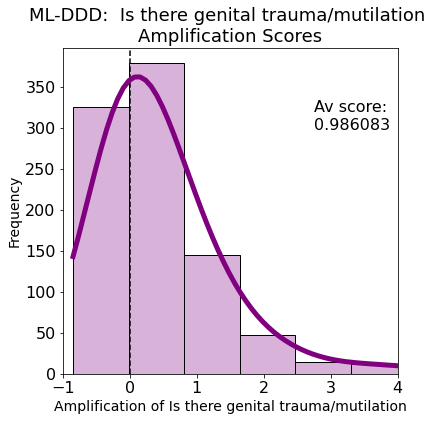

 av amp for Is there dog fighting: -0.33758693086978364


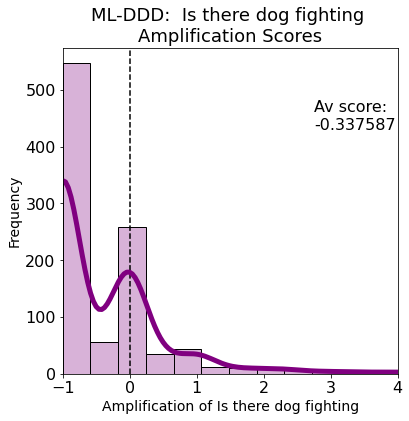

 av amp for Is there addiction: 0.5925766384356562


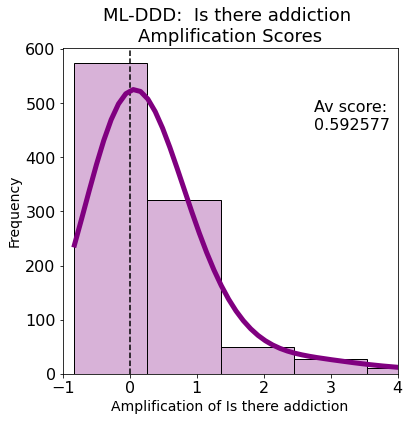

 av amp for Does someone break a bone: 0.6292662627979129


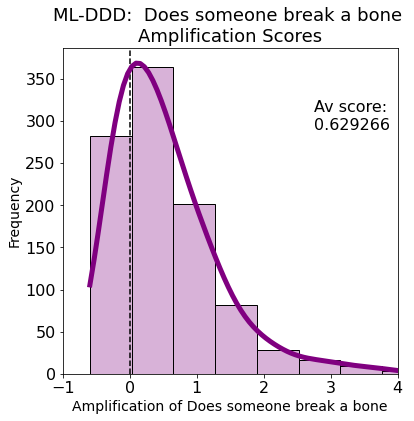

 av amp for Are there abortions: -0.03273394144086905


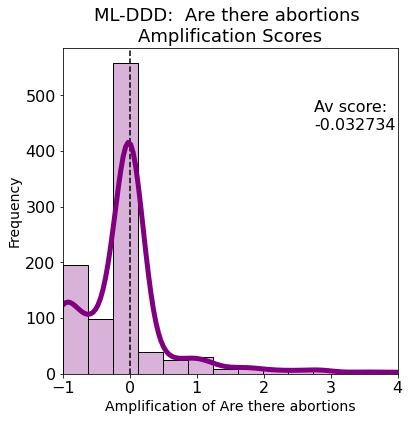

 av amp for Does someone have a chronic illness: 1.244820942247701


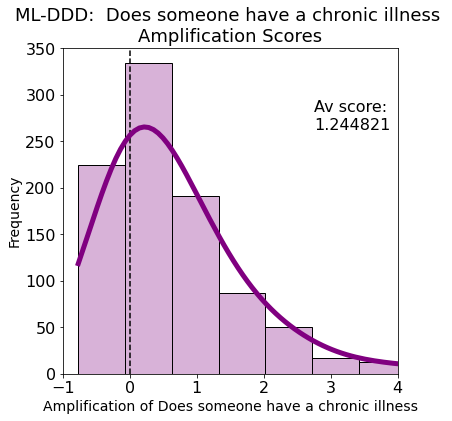

 av amp for Is the R word used: 1.4859628369450741


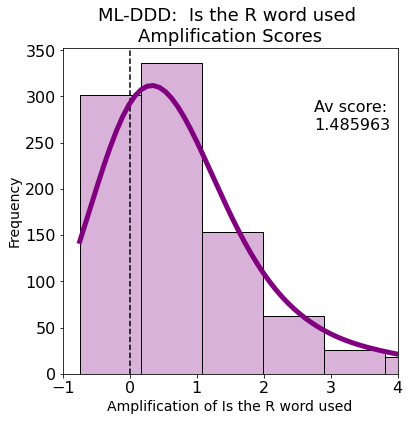

 av amp for Is there finger/toe mutilation: 0.9575508460524446


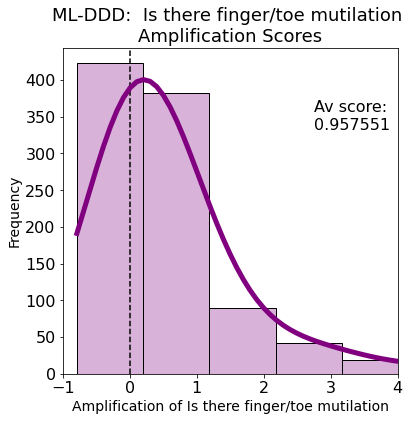

 av amp for Does someone have a seizure: 2.212936778831727


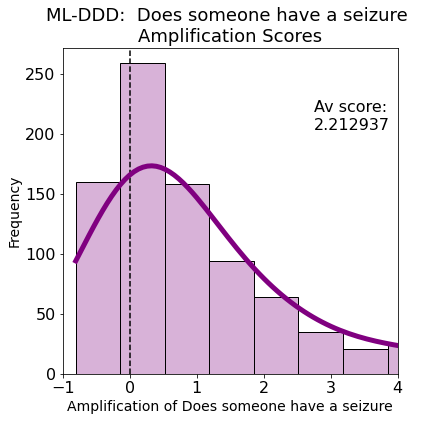

 av amp for Is someone raped onscreen: 0.6853305358178239


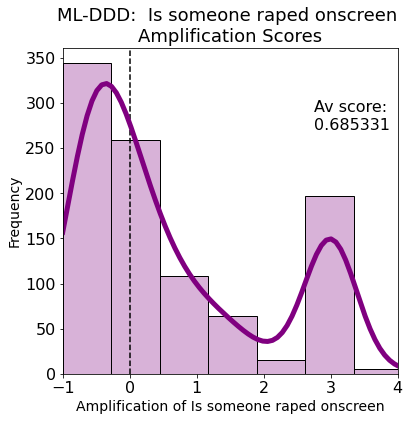

 av amp for Are there clowns: 0.8787879961115325


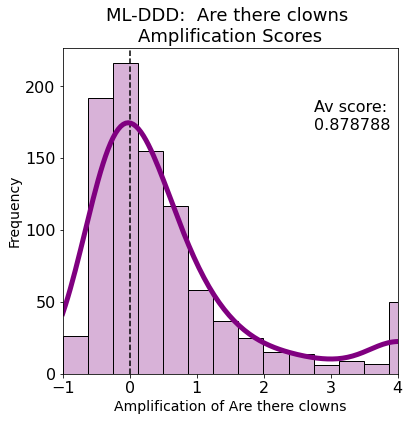

 av amp for Are any teeth damaged: 1.3556436396432567


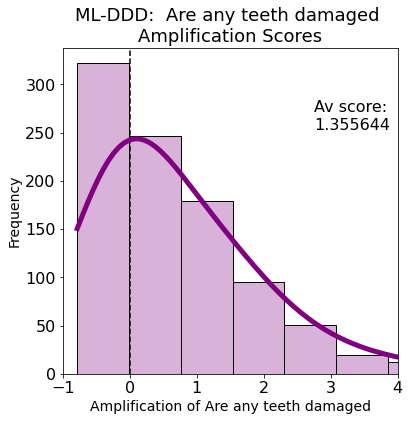

 av amp for Does a parent die: 0.3639603160341813


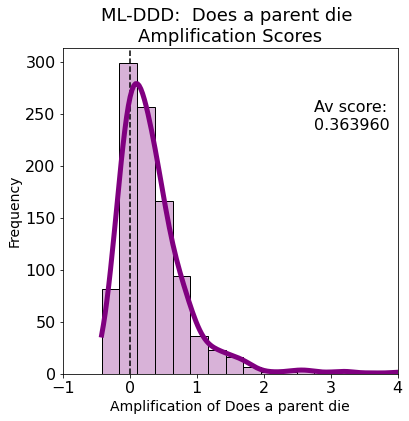

 av amp for Does the dog die: 0.46264739869529825


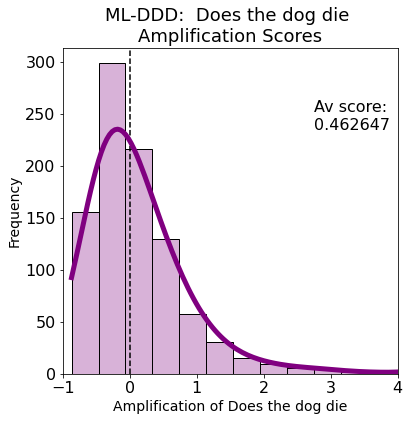

 av amp for Is there body horror: 2.2006658983642695


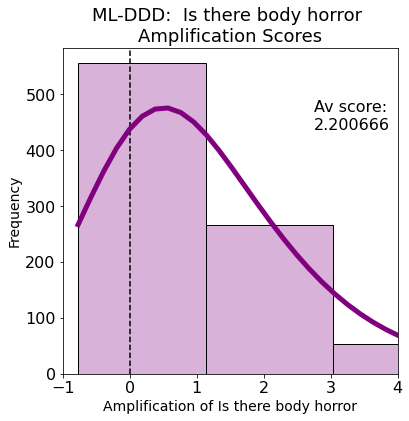

 av amp for Does someone have cancer: 0.3302905907844089


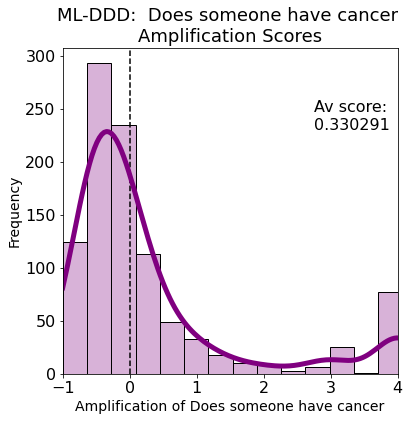

 av amp for Does someone suffer from PTSD: 0.9544285249174996


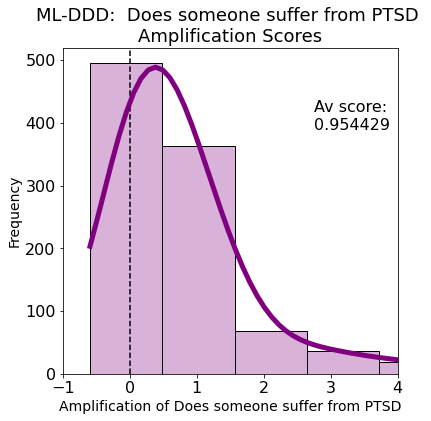

 av amp for Is someone homeless: 1.103052768271052


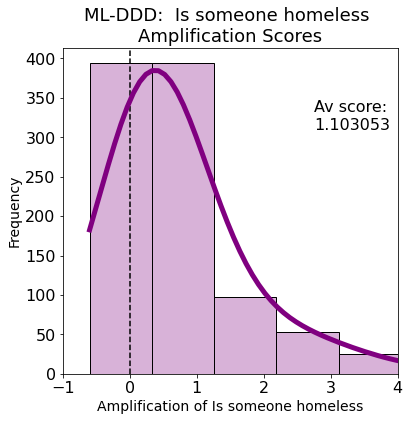

 av amp for Does a head get squashed: 1.0936510023714126


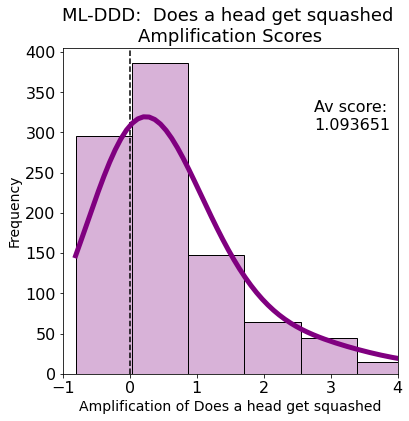

 av amp for Is there autism specific abuse: 0.8218454047336462


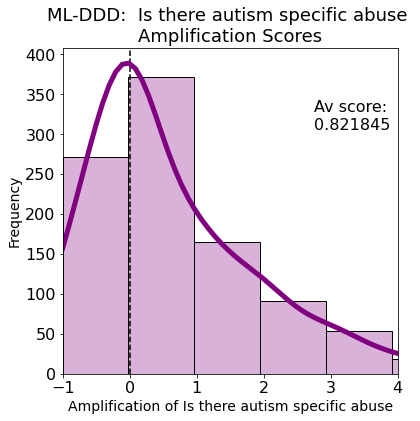

 av amp for Is there a nuclear explosion: 1.3749152794017756


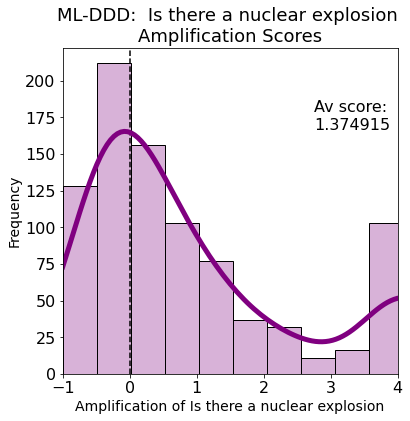

 av amp for Is there a hospital scene: 0.2399516122911855


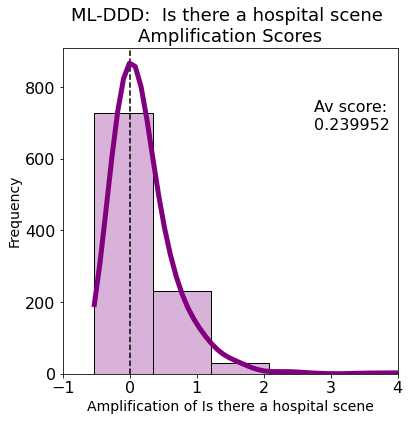

 av amp for Does a plane crash: 1.3968209477107032


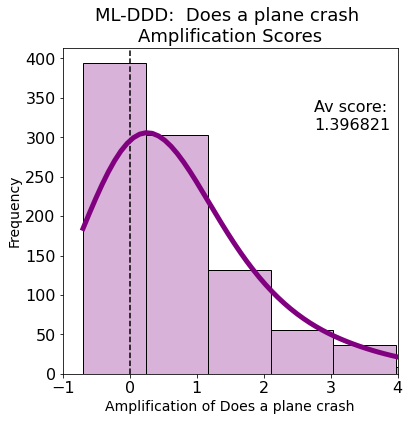

 av amp for Is a child's toy destroyed: 1.642478823941472


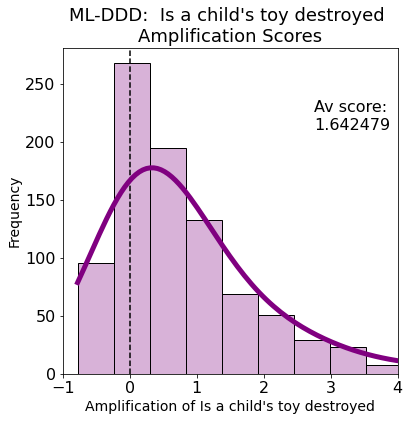

 av amp for Does someone use drugs: 0.2992250014701081


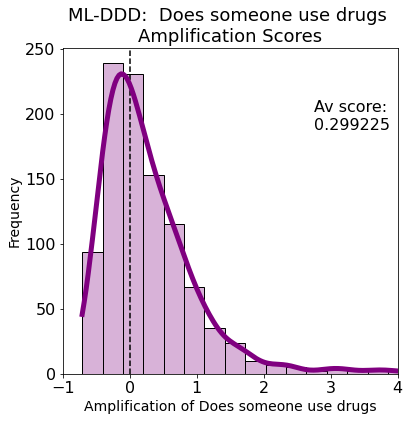

 av amp for Is there ableist language or behavior: 0.6593696864204192


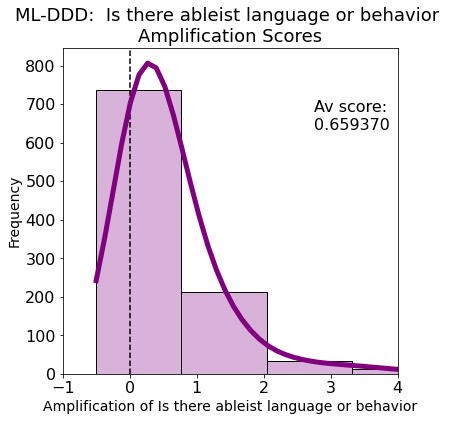

 av amp for Are there fat suits: -0.2895758993783995


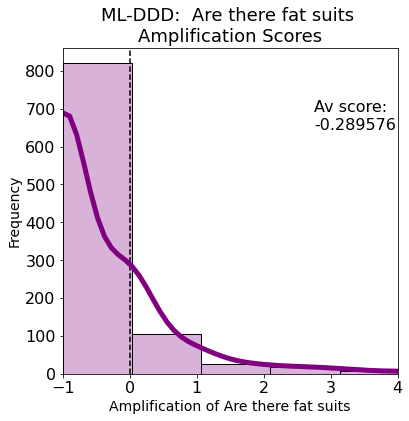

 av amp for Does the black guy die first: 0.6858958932751358


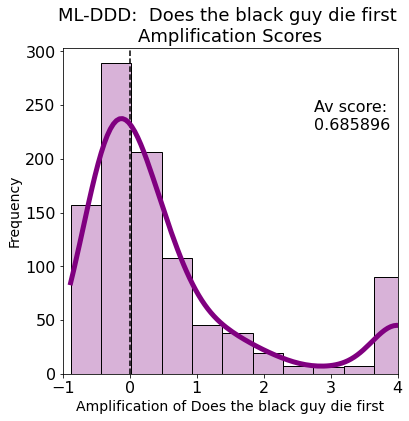

 av amp for Are there jumpscares: 1.045337105841255


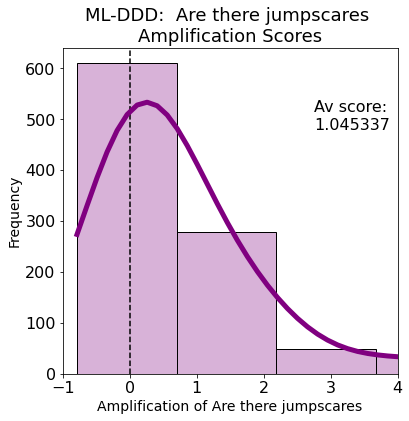

 av amp for Is there D.I.D. misrepresentation: 0.5925826904761907


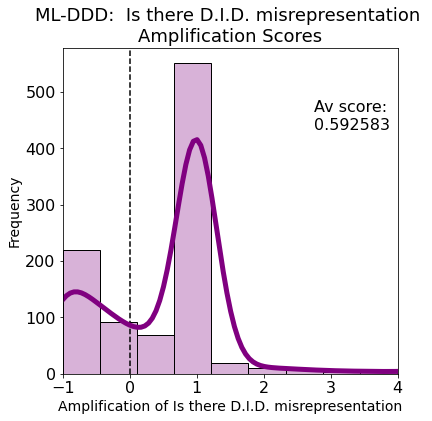

 av amp for Is electro-therapy used: 2.1871594640367826


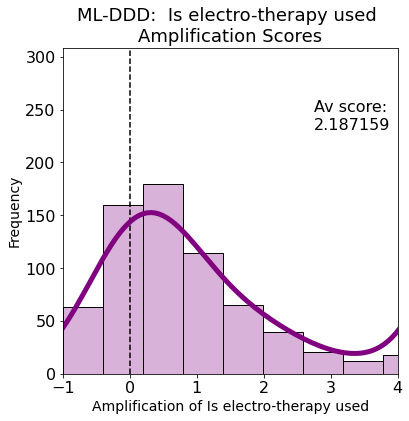

 av amp for Are animals abused: 0.41200024026487786


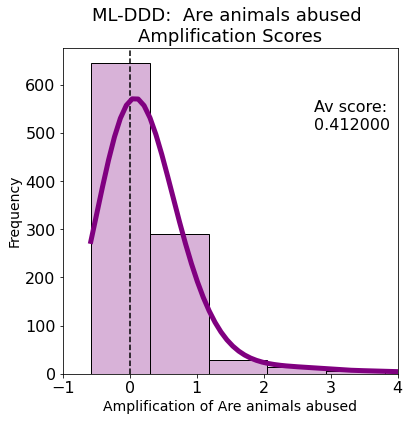

 av amp for Does someone have a stroke: -0.26716271771284267


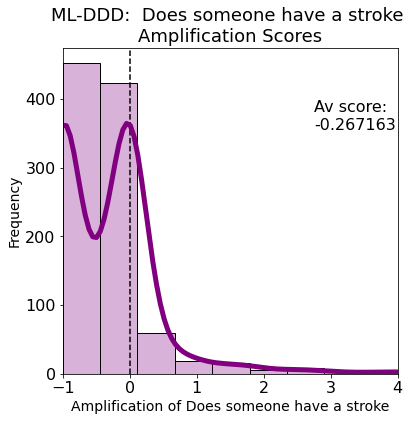

 av amp for Is there bisexual cheating: -0.99238


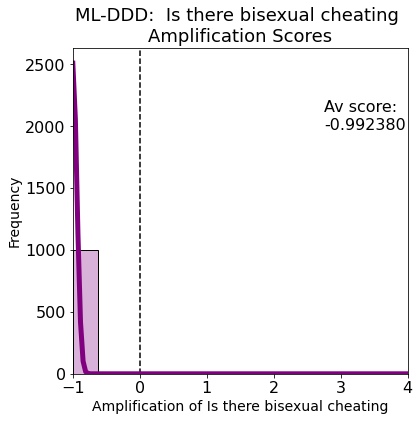

 av amp for Is there body dysmorphia: 0.46060502215572713


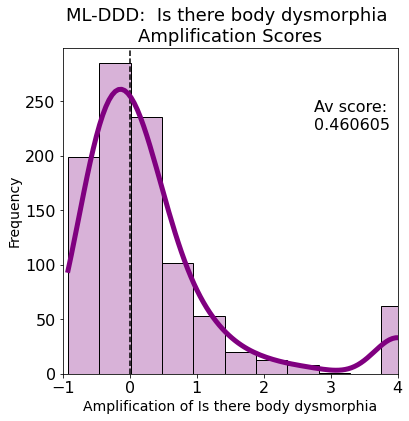

 av amp for Is someone sexually objectified: 0.9626599168925221


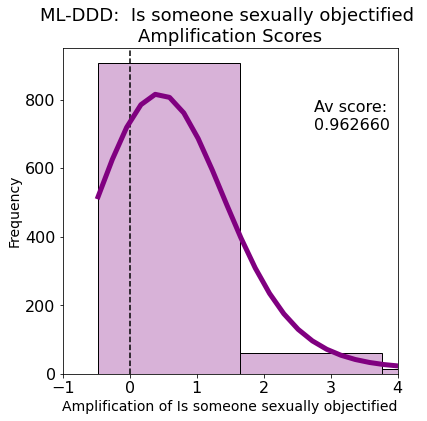

 av amp for Is the fourth wall broken: 1.9465375219545507


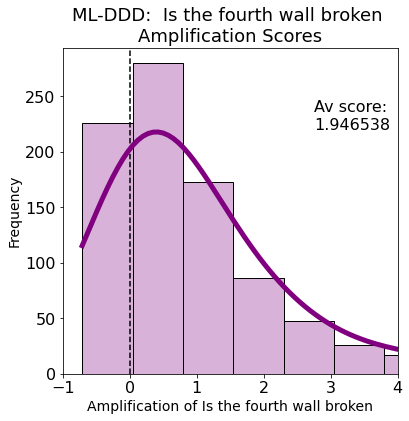

 av amp for Is someone burned alive: 0.5856629424638478


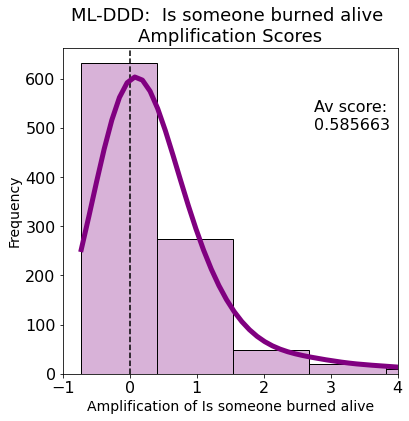

 av amp for Is there aphobia: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


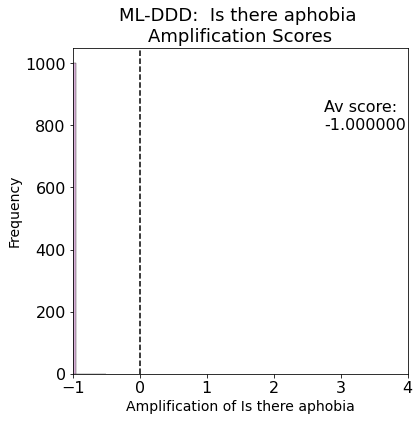

 av amp for Is there dementia/Alzheimer's: 1.0510391037296034


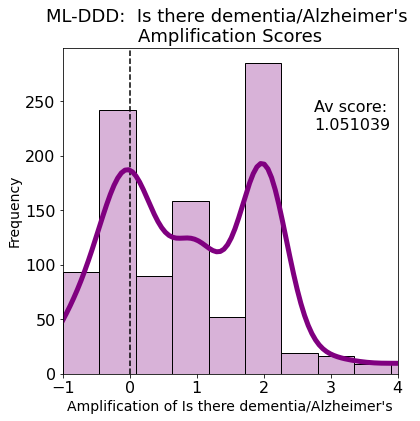

 av amp for Does someone drown: 0.5043555084092477


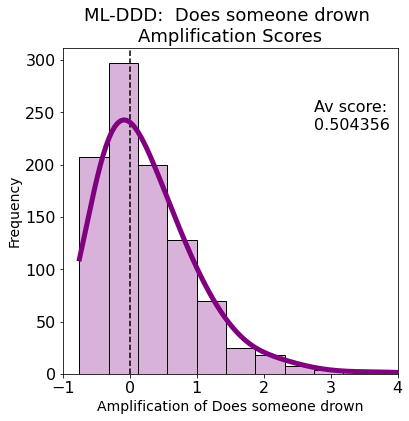

 av amp for Are there razors: 2.0821256007454774


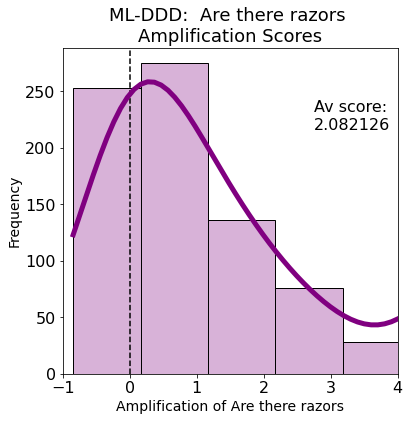

 av amp for Does a kid die: 0.6307588503222129


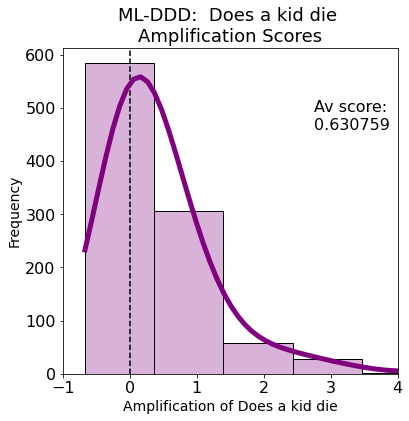

 av amp for Are there ghosts: 1.7170388302843451


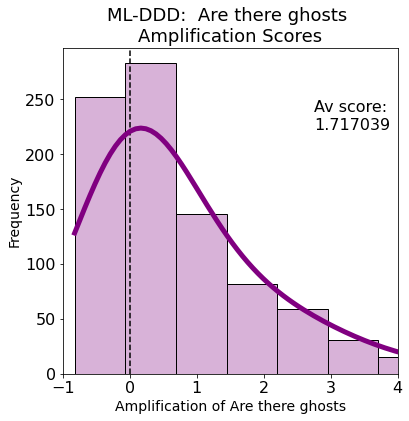

 av amp for Is there hate speech: 0.411096825237987


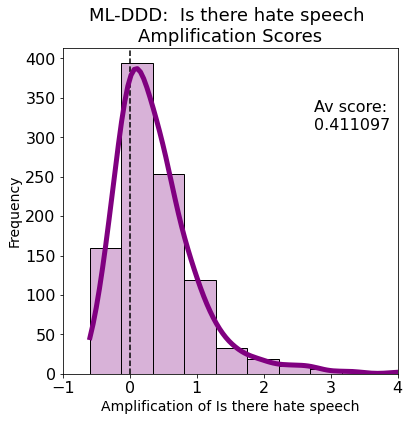

 av amp for Is a minor sexualized: 1.1896983869131772


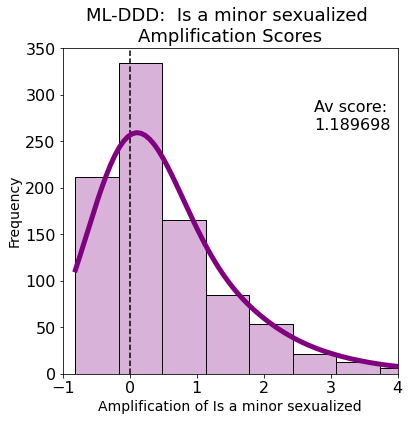

 av amp for Are there homophobic slurs: 0.8849367330423584


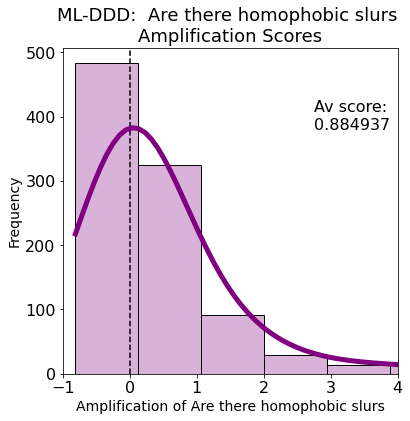

 av amp for Is there audio gore: 0.7717675237507814


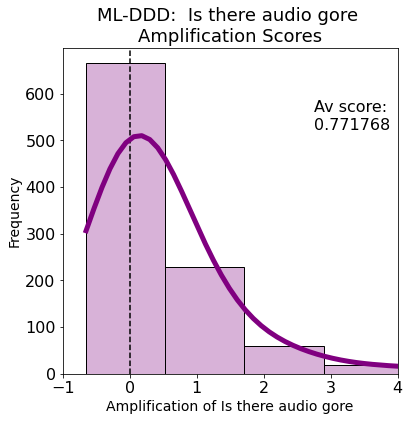

 av amp for Does someone fall down stairs: 1.3335559209330095


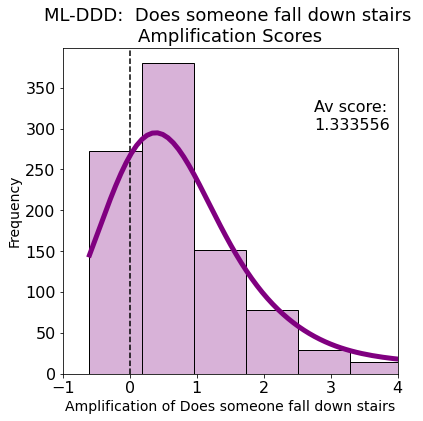

 av amp for Is someone tortured: 0.3683130024176335


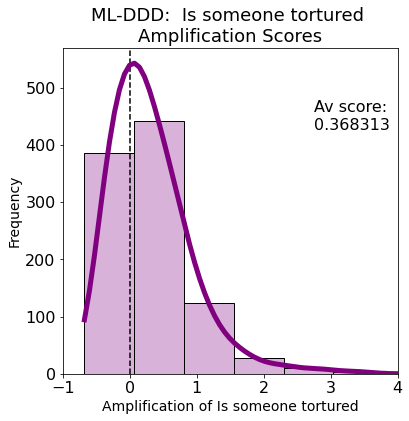

 av amp for Does a baby cry: 0.7598245840458383


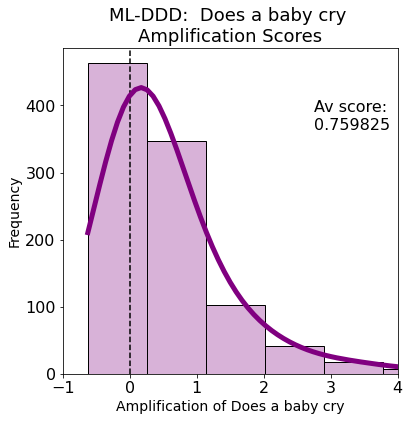

 av amp for Are there bugs: 0.5708350336712948


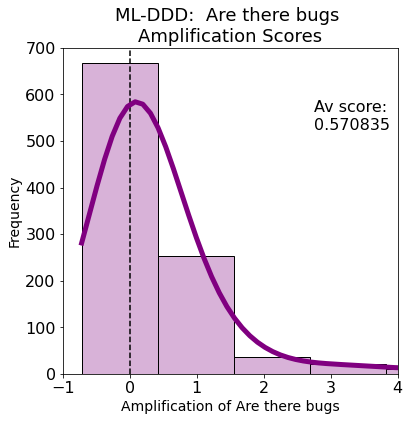

 av amp for Does a car honk or tires screech: 0.6665101602865422


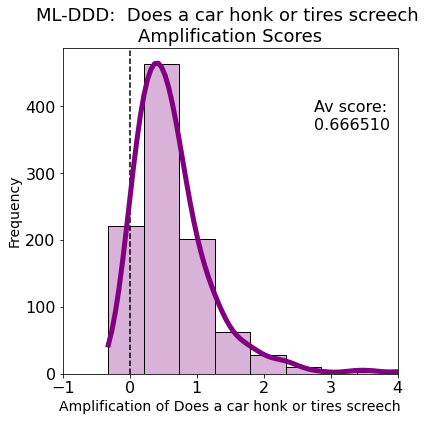

 av amp for Does someone fall to their death: 0.7363775283720475


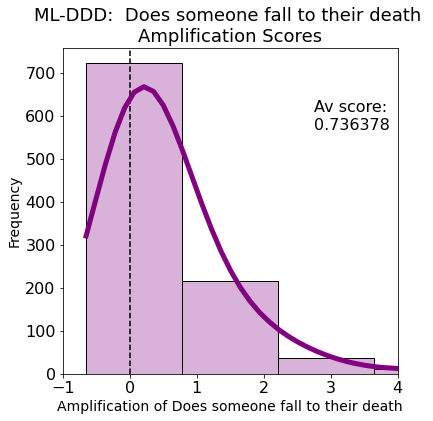

 av amp for Are there babies or unborn children: 0.9007859800392699


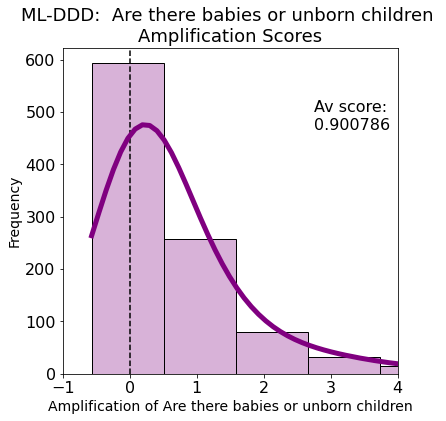

 av amp for Is there bestiality: -0.2586


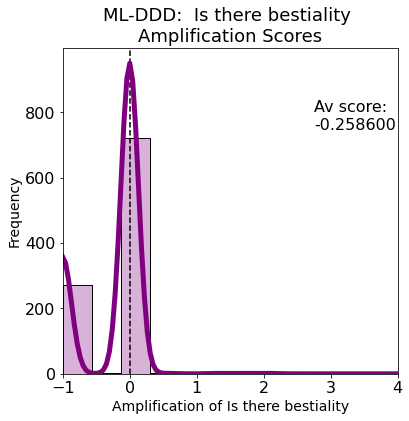

 av amp for Is there shaving/cutting: 0.5055472388294999


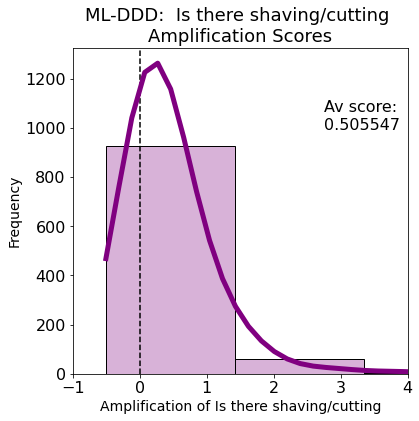

 av amp for Is there excessive gore: 1.3239450404554325


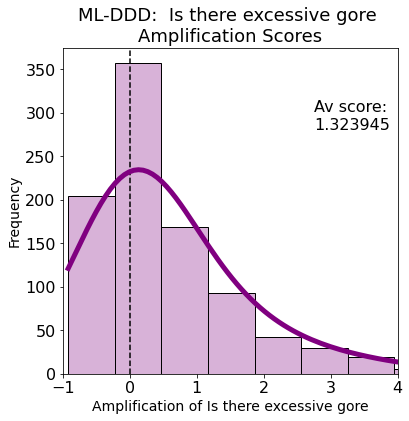

 av amp for Does someone fart or spit: 0.5076244885673138


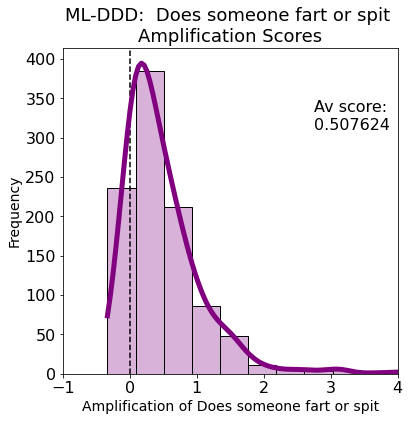

 av amp for Does a pregnant person die: -0.29603319176052717


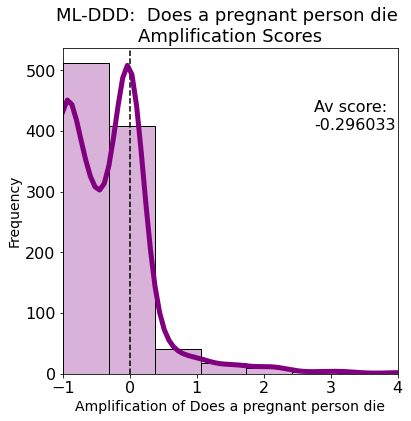

 av amp for Is there cannibalism: 0.2538840371941838


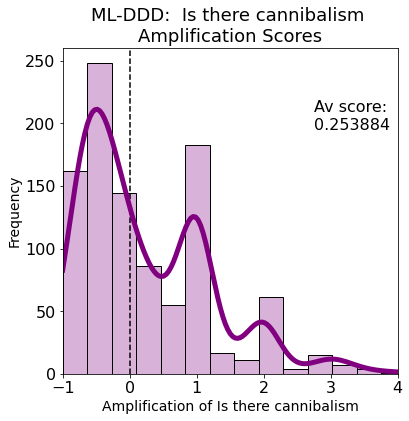

 av amp for Is someone kidnapped: 0.5088403062075852


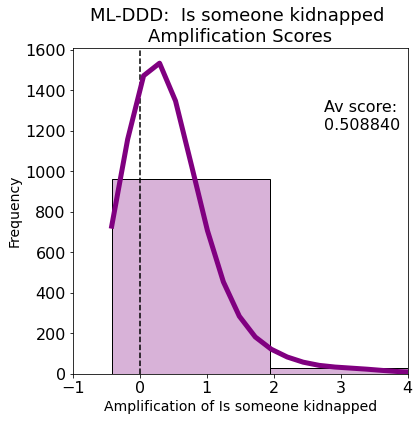

 av amp for Are there mannequins: 2.1079414715358986


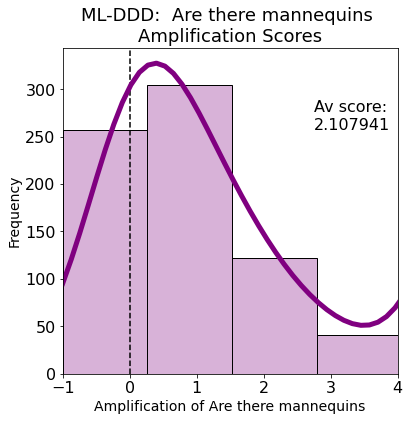

 av amp for Are needles/syringes used: 0.5252108119969906


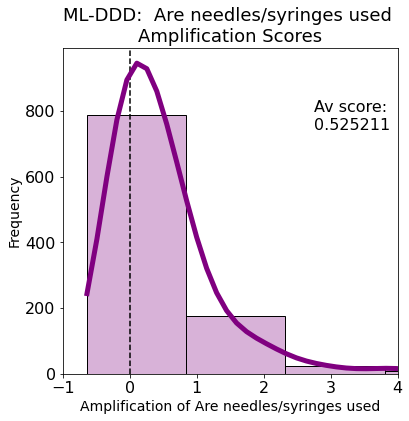

 av amp for Is someone drugged: 2.468468318379194


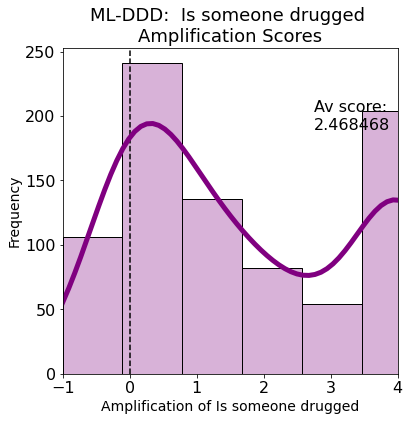

 av amp for Is someone gaslighted: 0.509500292067774


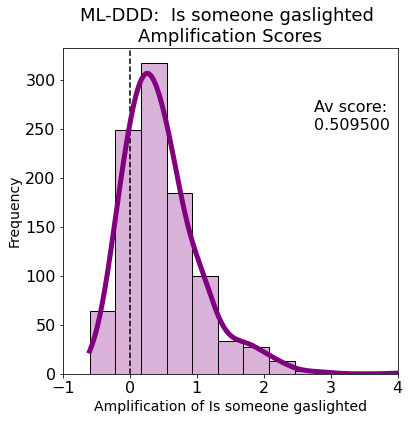

 av amp for Is an infant abducted: 1.281422754485381


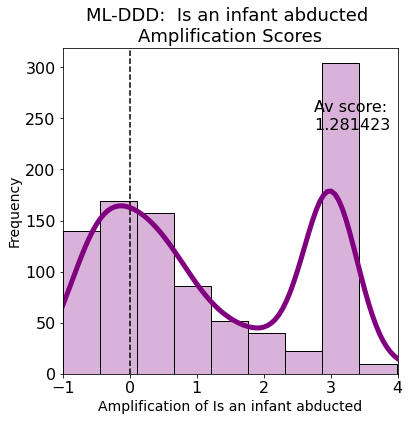

 av amp for Is someone crushed to death: 1.4908543053879757


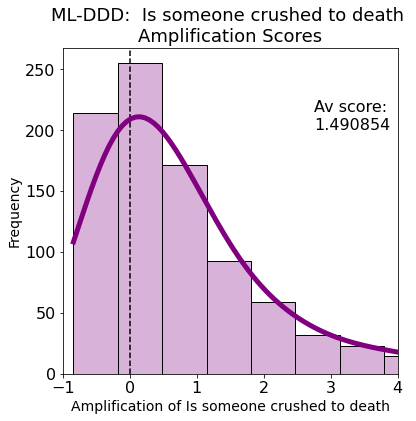

 av amp for Are there nude scenes: 0.7625266558326541


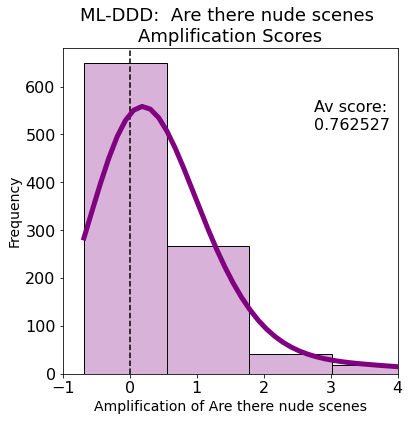

 av amp for Does it have a sad ending: 0.6985226264557121


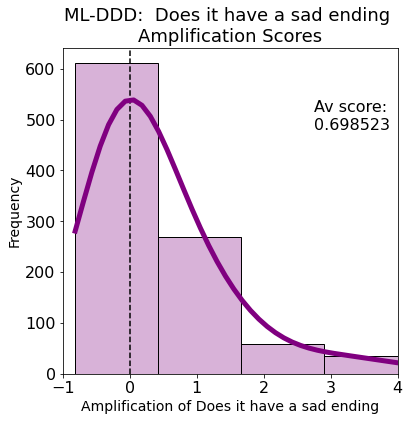

 av amp for Does someone say "I'll kill myself": 0.6688707504175535


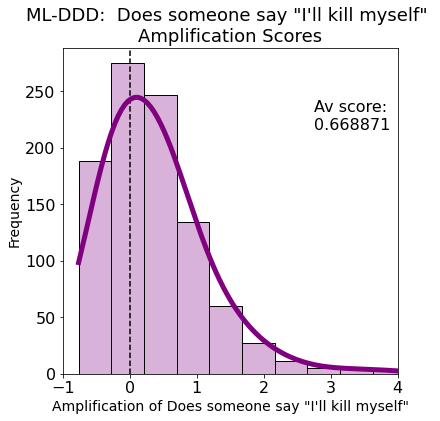

 av amp for Are there n-words: 1.2791433996963046


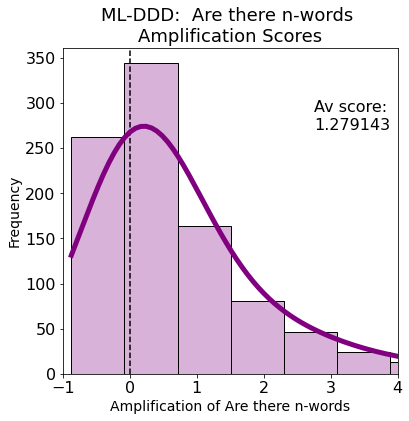

 av amp for Is someone restrained: 0.6334291113252273


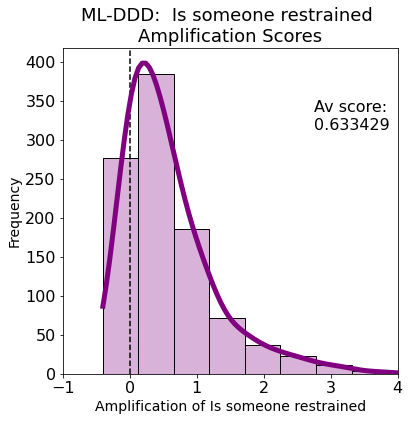

 av amp for Does a dragon die: 0.18308017063492066


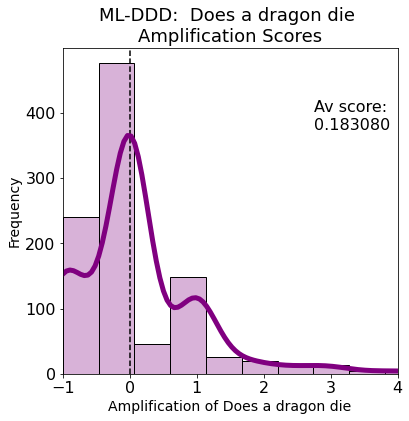

 av amp for Is there copaganda: 1.502092780666837


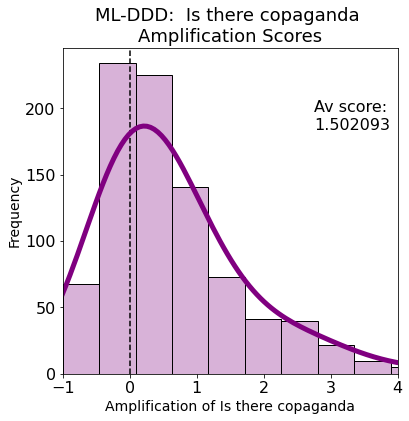

 av amp for Is there gun violence: 0.3239560111868003


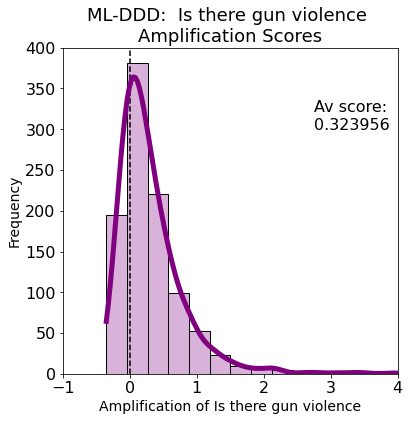

 av amp for Does someone vomit: 0.20567206108433


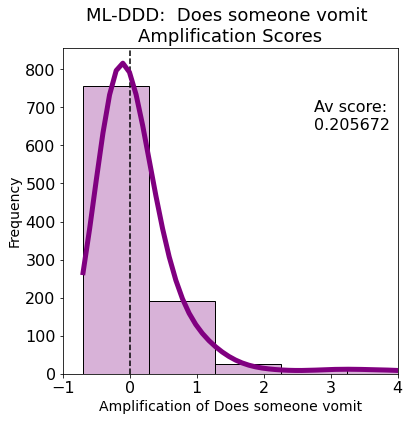

 av amp for Does an LGBT person die: 0.7541762490142375


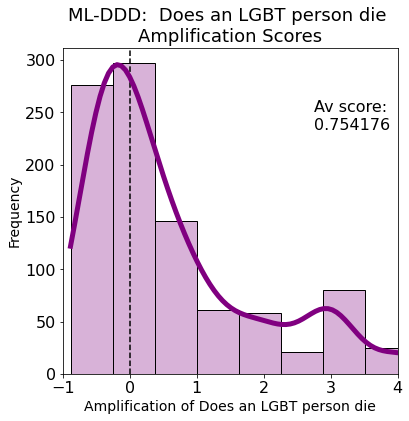

 av amp for Is someone stalked: 0.47931207535824866


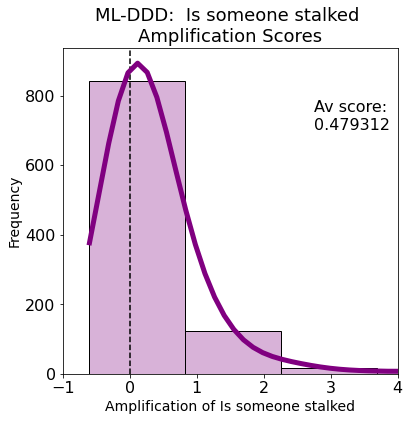

 av amp for Does a non-human character die: -0.16622416666666665


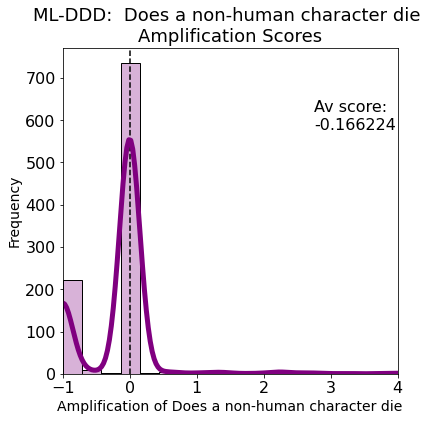

 av amp for Is there antisemitism: 1.1446404026415635


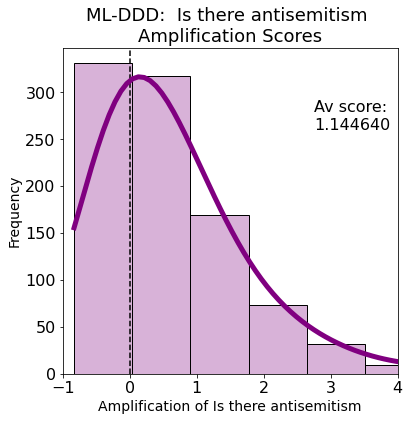

 av amp for Is there a shower scene: 0.47077389044110424


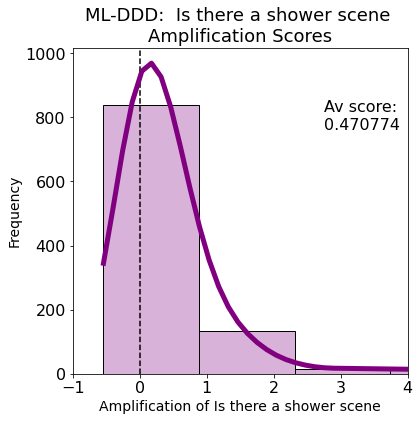

 av amp for Is Santa (et al) spoiled: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


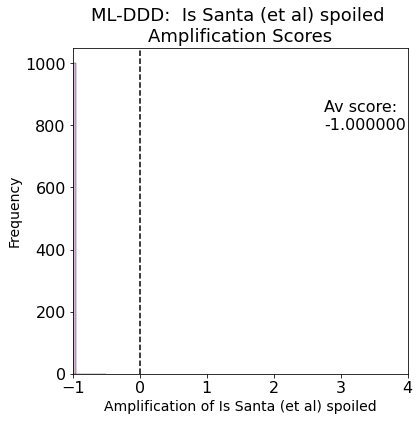

 av amp for Does someone die by suicide: 0.6677609385319597


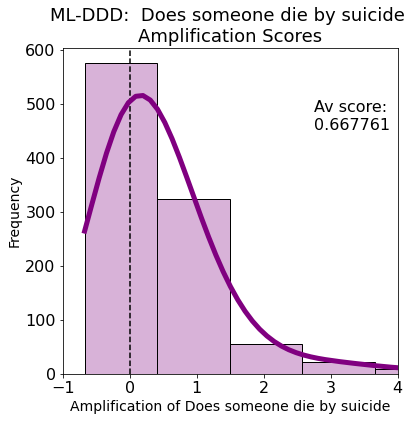

 av amp for Is a male character ridiculed for crying: 0.1805789518362017


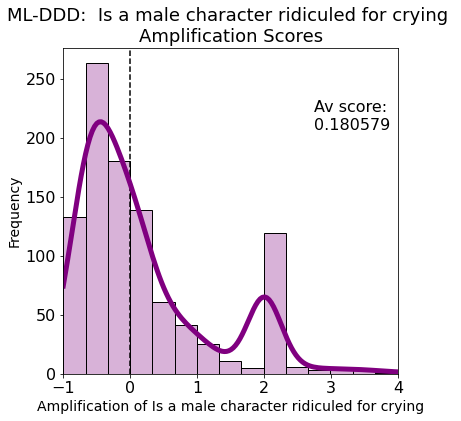

 av amp for Is someone buried alive: 0.38257103625220784


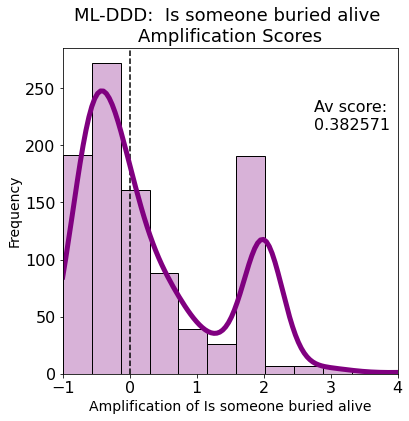

 av amp for Does someone sacrifice themselves: 1.8164012386814492


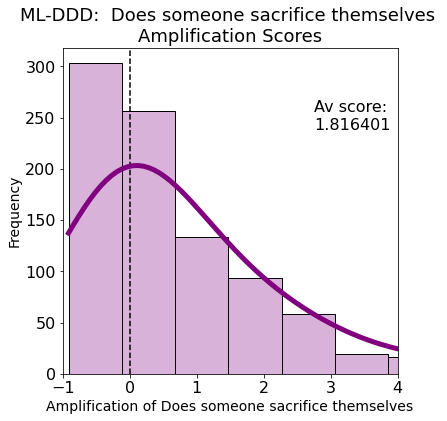

 av amp for Is there sexual content: 0.2494272186733639


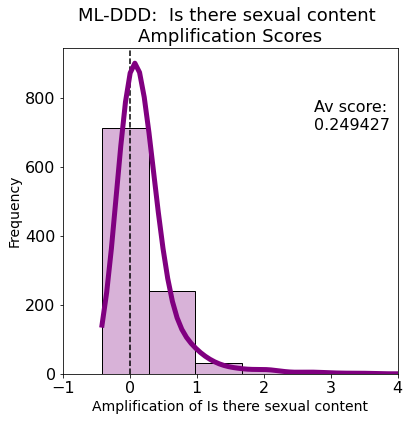

 av amp for Are there incestuous relationships: 0.04828318674347782


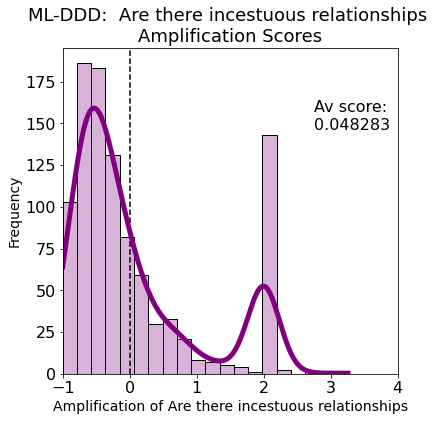

 av amp for Does someone abuse alcohol: 0.22756502576170143


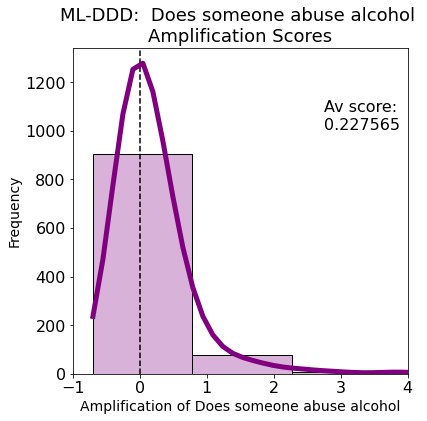

 av amp for Is a mentally ill person violent: 1.234217200833897


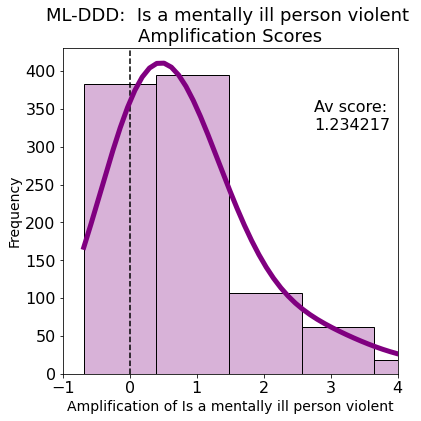

 av amp for Are there flashing lights or images: 0.7562727267853637


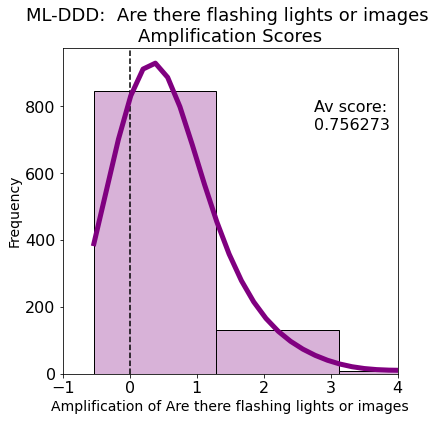

 av amp for Is someone sexually assaulted: 0.3255202919101894


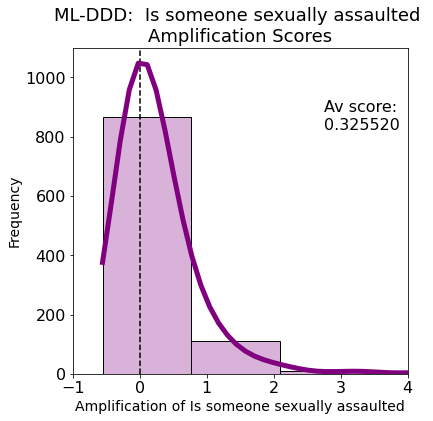

 av amp for Are there "Man in a dress" jokes: 0.8370177314520824


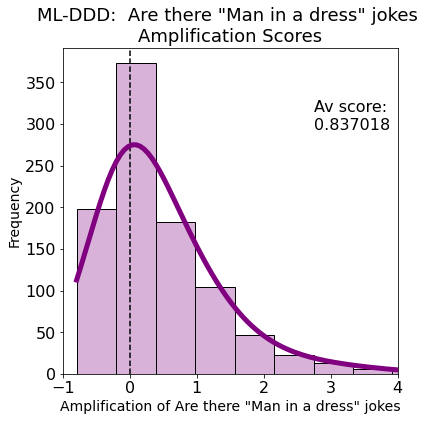

 av amp for Is there a dead animal: 0.24376876883395002


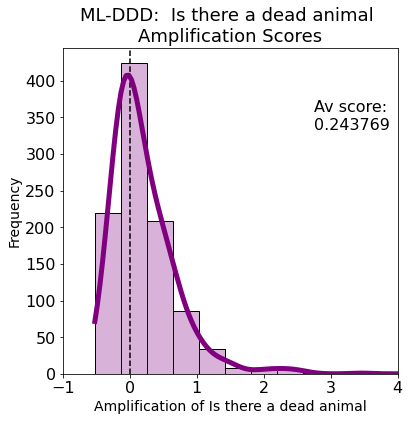

 av amp for Is someone hit by a car: 0.3685587161195898


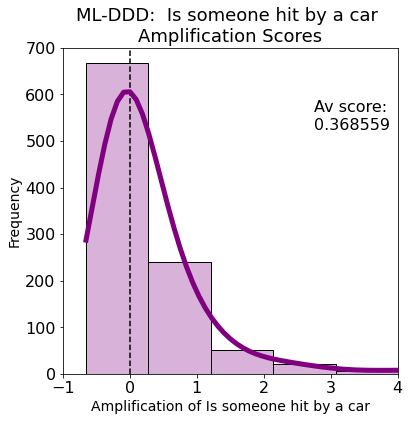

In [55]:
warning_amplification_plots(top_pop_amplification_dfs)

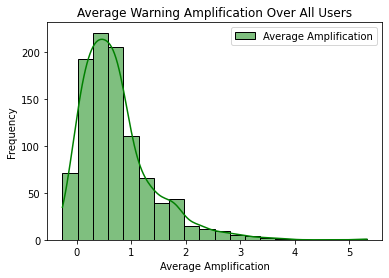

In [28]:
user_amplification_plots(top_pop_amplification_dfs)

### Random Algorithm

In [58]:
random_amplification_dfs = amplification_dfs(random_recs)

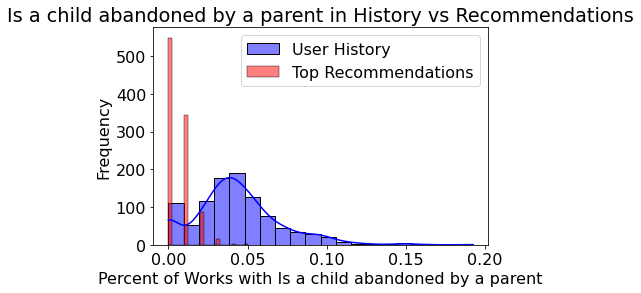

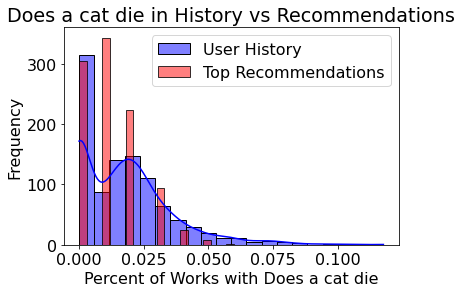

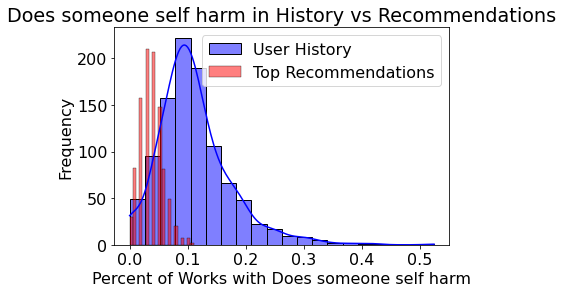

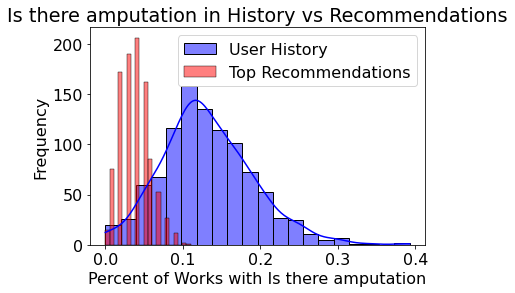

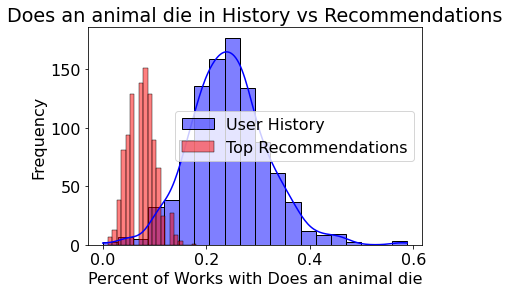

...

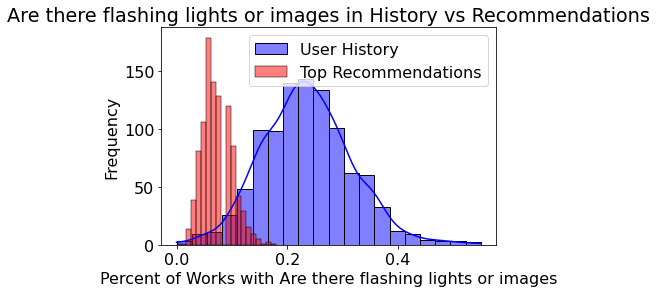

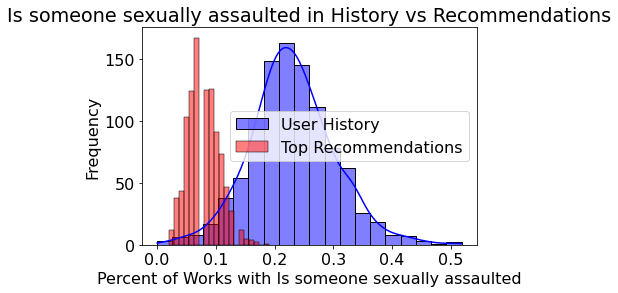

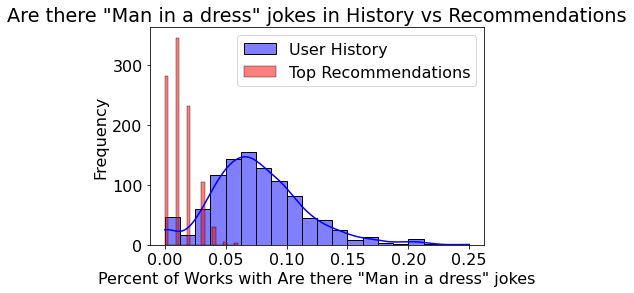

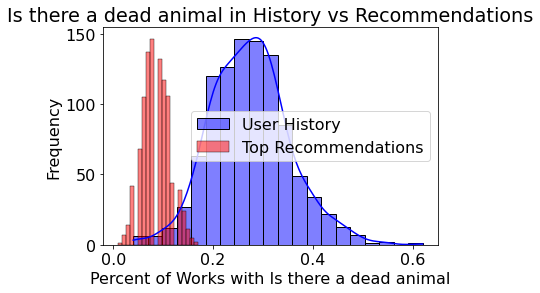

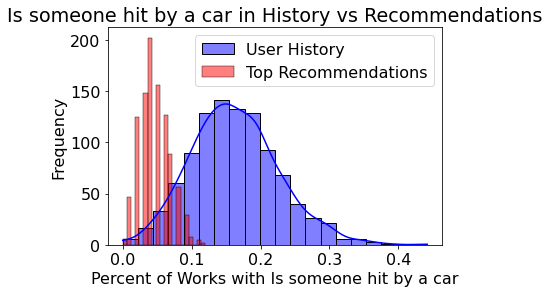

In [59]:
warning_distribution_plots(random_amplification_dfs)

 av amp for Is a child abandoned by a parent: -0.7962564230483006


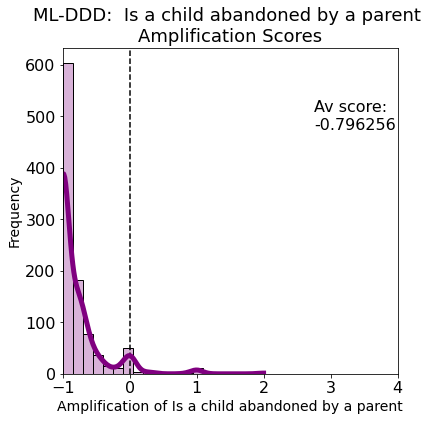

 av amp for Does a cat die: -0.15716108132566664


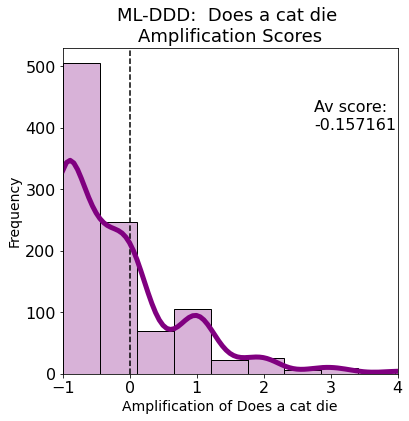

 av amp for Does someone self harm: -0.4441501237649962


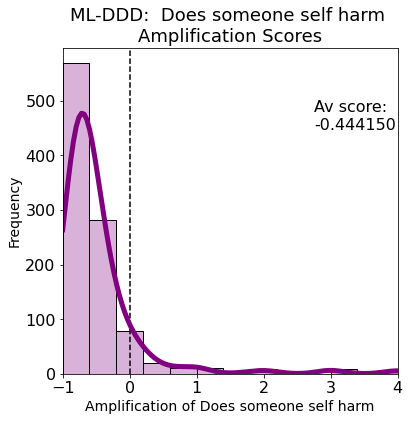

 av amp for Is there amputation: -0.5867257678678807


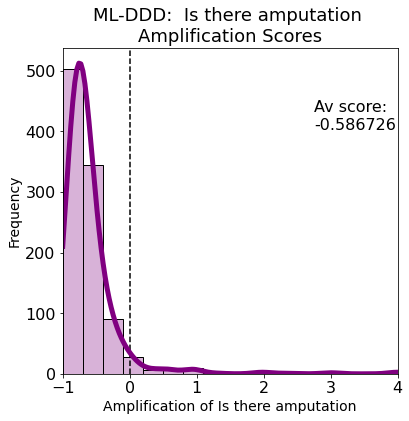

 av amp for Does an animal die: -0.6353844581470767


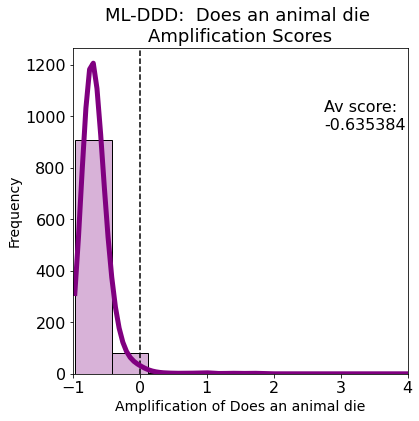

 av amp for Does someone overdose: -0.7435247056429409


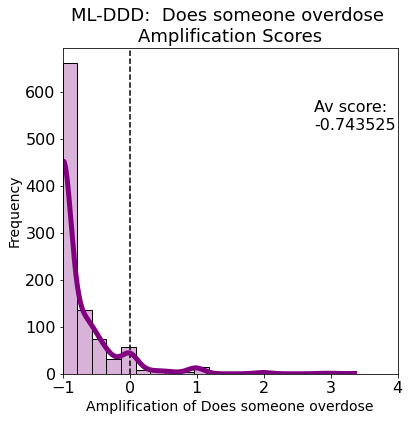

 av amp for Are there snakes: -0.5924169787558222


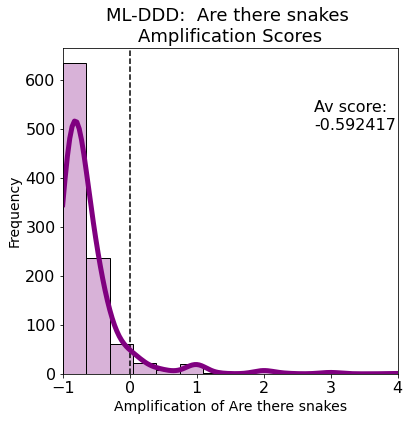

 av amp for Is there Achilles Tendon injury: -0.8255948333333331


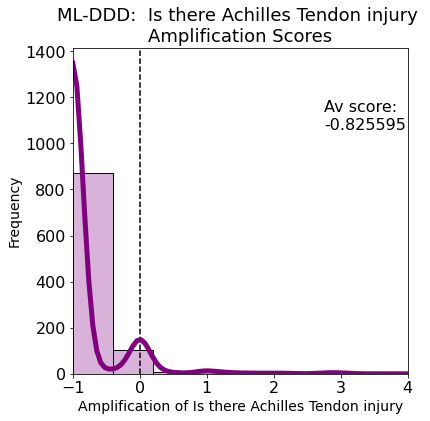

 av amp for Is there a large age gap: -0.7489389346373205


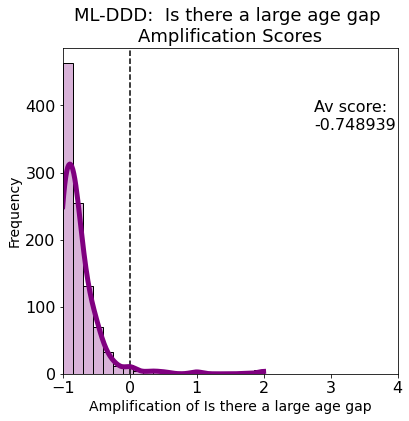

 av amp for Does someone becomes unconscious: -0.8041063410027078


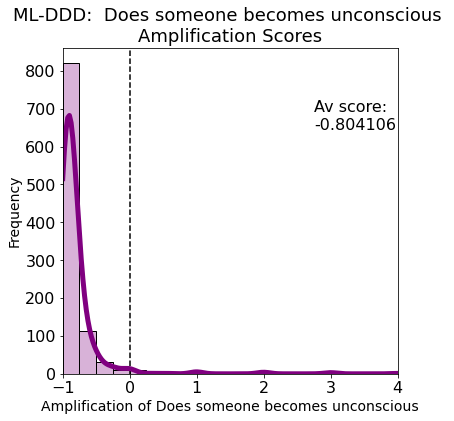

 av amp for Is a baby stillborn: -0.8009707142857141


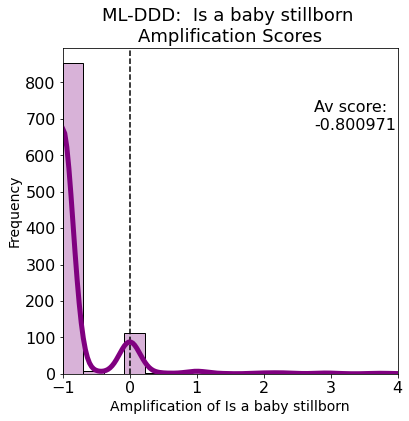

 av amp for Is there eye mutilation: -0.41697920405895306


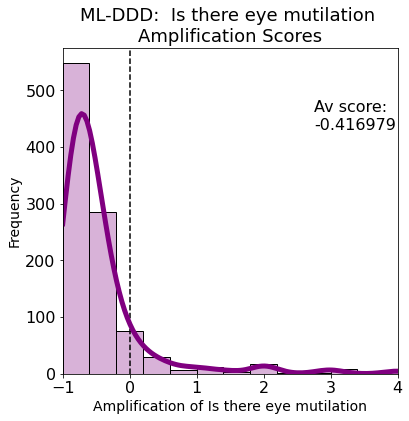

 av amp for Does someone cheat: -0.5615065856172701


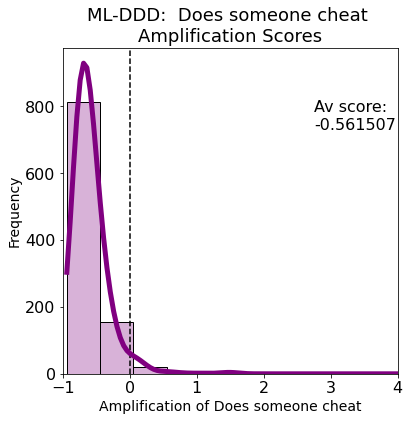

 av amp for Are there 9/11 depictions: -0.8882700000000001


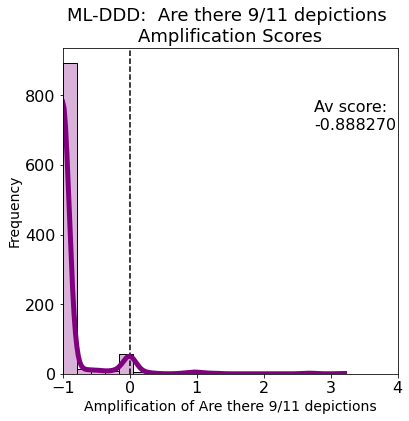

 av amp for Is there childbirth: -0.3463573413547308


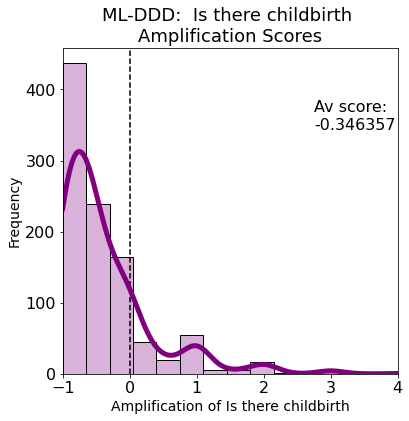

 av amp for Is someone misgendered: -0.6217991324438349


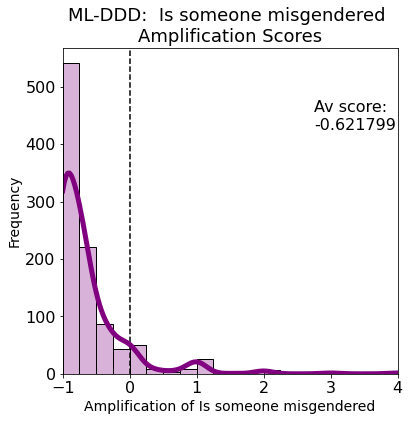

 av amp for Is a minority is misrepresented: -0.8647458903008762


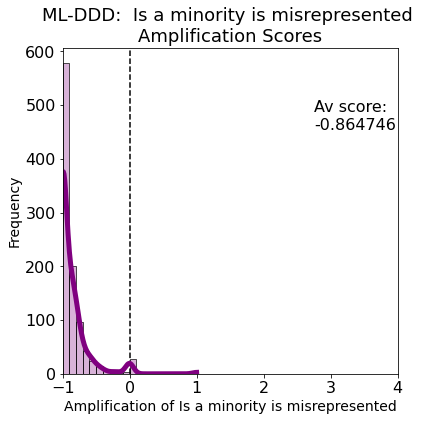

 av amp for Are there fat jokes: -0.7493953964558596


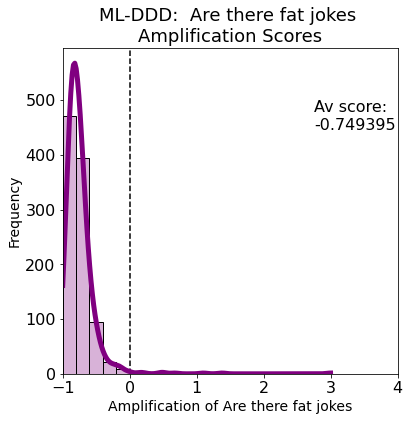

 av amp for Are there anxiety attacks: -0.5584794173031299


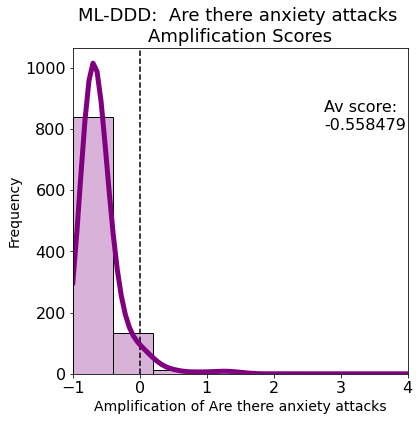

 av amp for Are there spiders: -0.6259722630579954


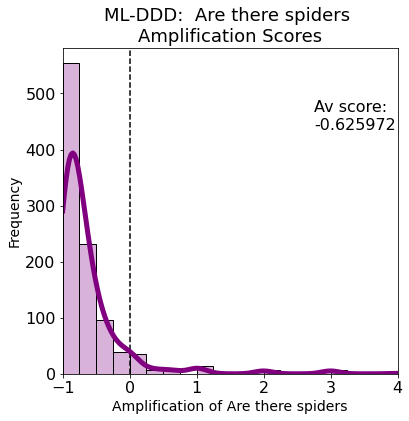

 av amp for Does a car crash: -0.7213169901680178


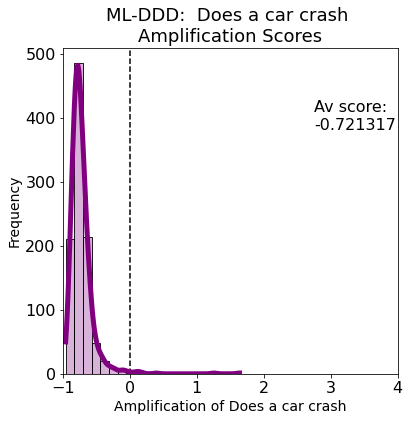

 av amp for Is there domestic violence: -0.5447458763447891


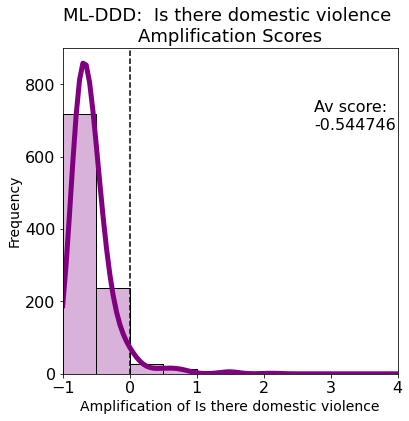

 av amp for Does someone struggle to breathe: -0.7091812535302544


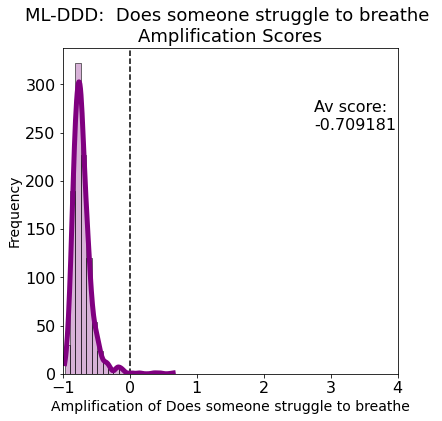

 av amp for Does the abused become the abuser: -0.96676


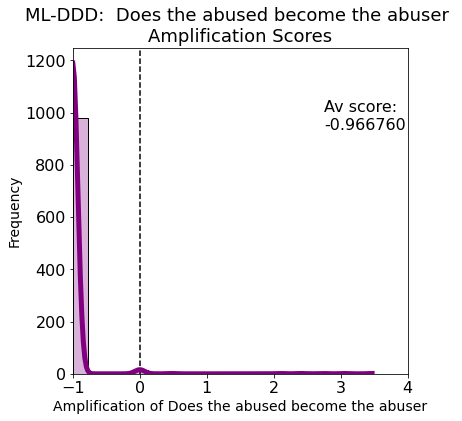

 av amp for Is there a mental institution scene: -0.5114276609792427


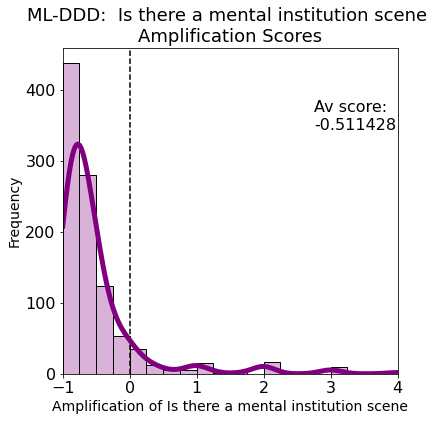

 av amp for Does someone asphyxiate: -0.6843421506443583


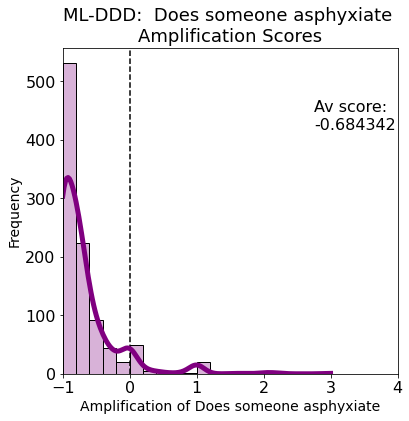

 av amp for Is a child abused: -0.5184100920707446


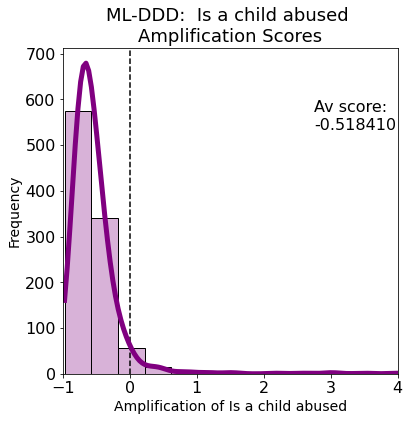

 av amp for Does someone miscarry: -0.41471801635862526


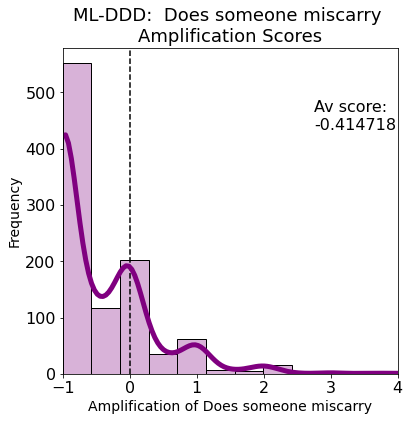

 av amp for Does a pet die: -0.636871886955391


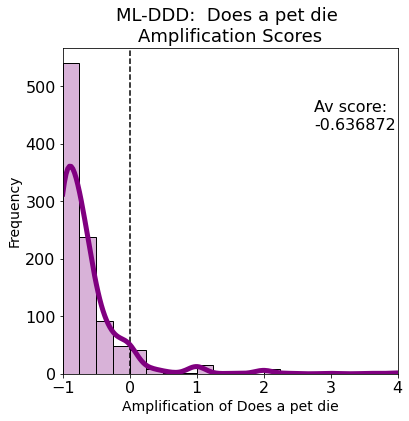

 av amp for Is someone possessed: -0.2751389947371593


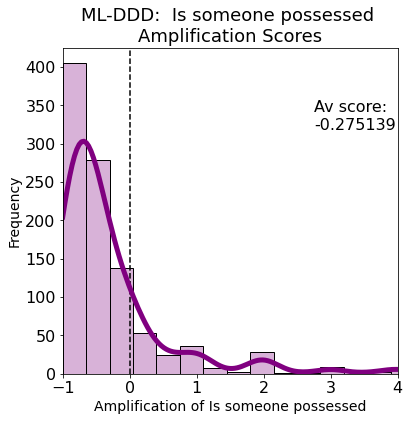

 av amp for Does someone have an eating disorder: -0.432134257065245


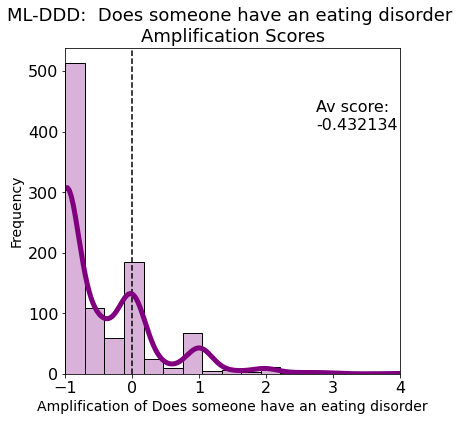

 av amp for Is there body dysphoria: -0.9814449999999999


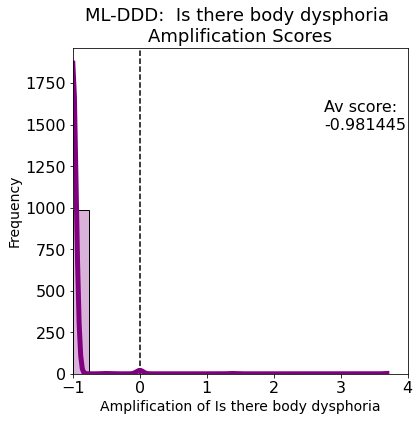

 av amp for Does a horse die: -0.6309057683317374


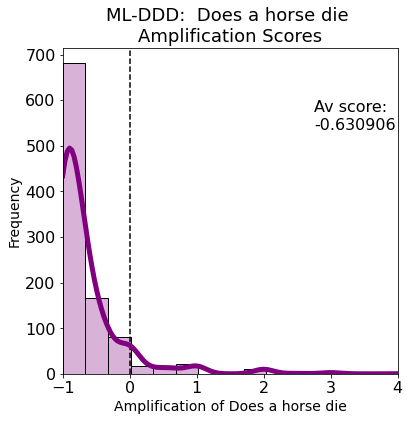

 av amp for Does someone attempt suicide: -0.7587237772780849


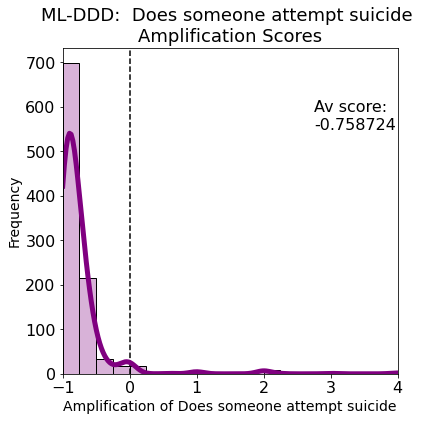

 av amp for Is there a claustrophobic scene: -0.7165770683675341


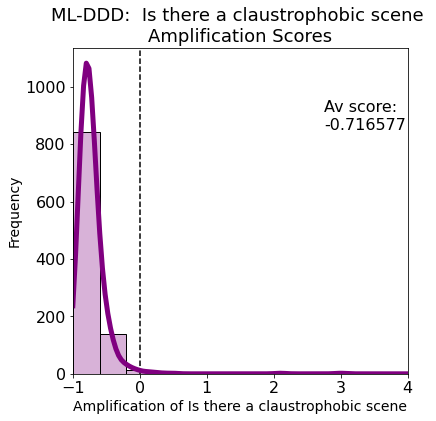

 av amp for Does someone wet/soil themselves: -0.5698045926317697


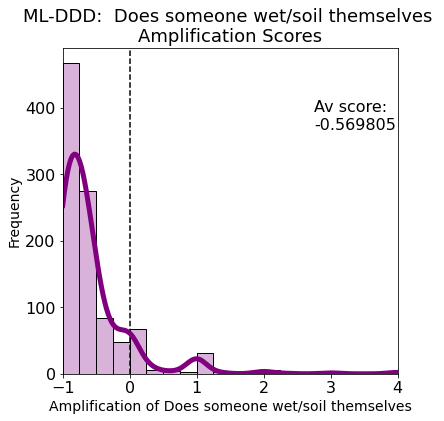

 av amp for Is there obscene language/gestures: -0.8167231296612317


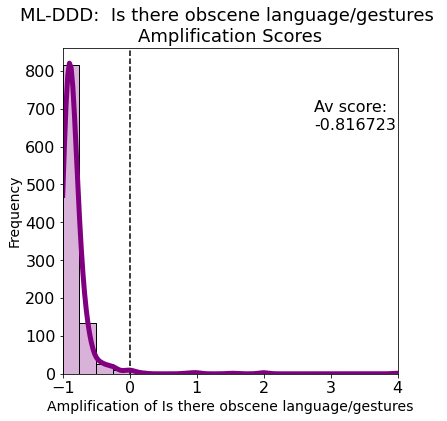

 av amp for Is there shakey cam: -0.5023911105561233


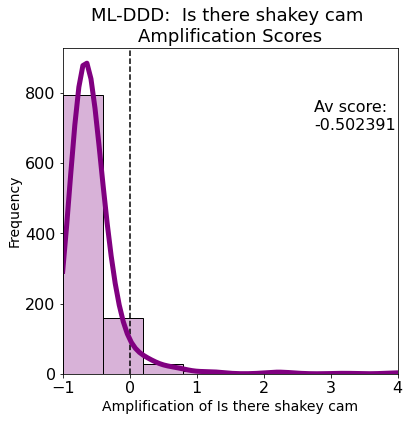

 av amp for Is there misophonia: -0.6755309663214808


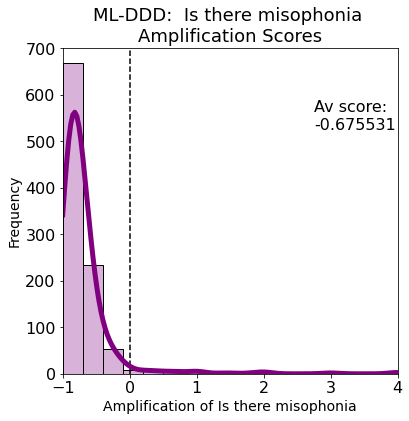

 av amp for Is there a hanging: -0.5245900705910064


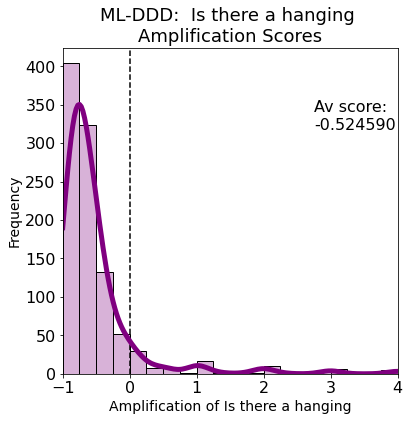

 av amp for Is there blood/gore: -0.6221856227676763


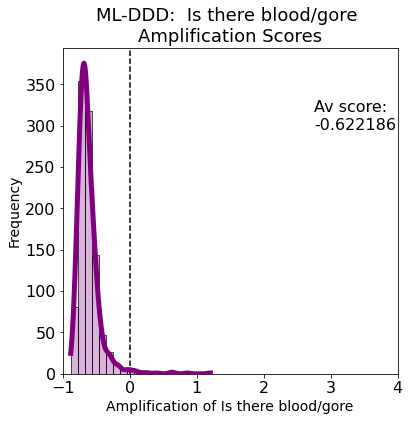

 av amp for Is there genital trauma/mutilation: -0.6370778983211801


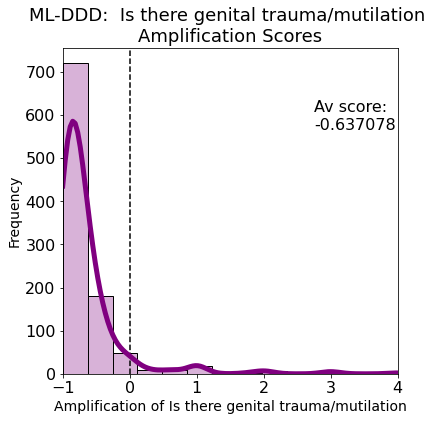

 av amp for Is there dog fighting: -0.6868152658730156


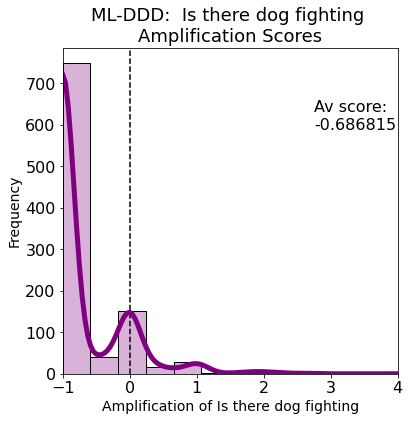

 av amp for Is there addiction: -0.5202536390710913


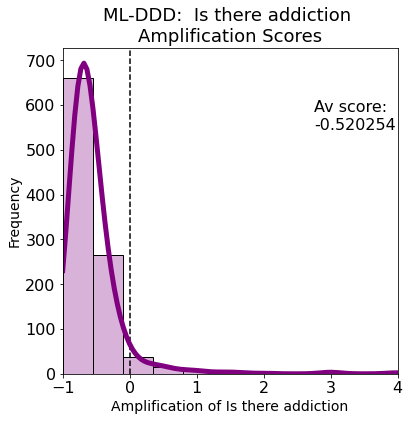

 av amp for Does someone break a bone: -0.7230148570648595


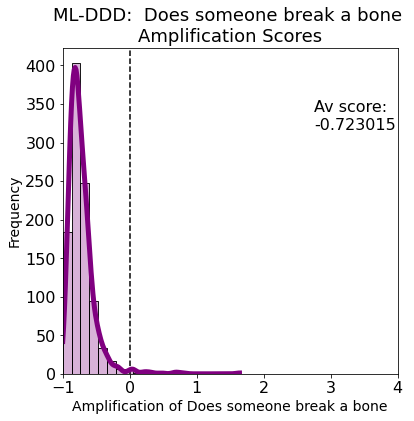

 av amp for Are there abortions: -0.46569064983084557


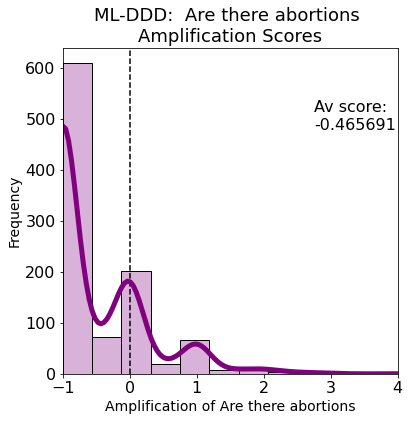

 av amp for Does someone have a chronic illness: -0.8005278874662557


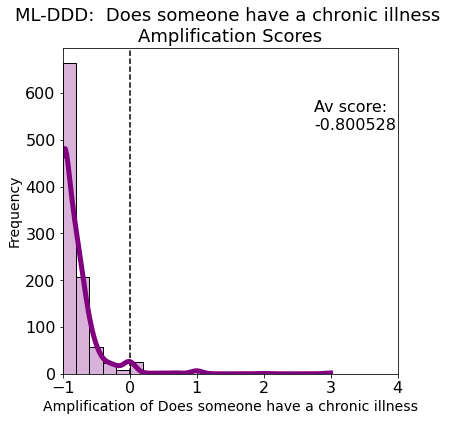

 av amp for Is the R word used: -0.7024288104697496


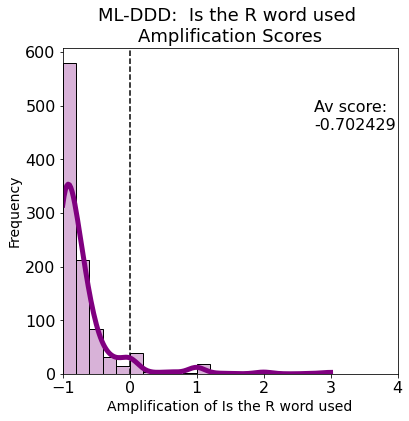

 av amp for Is there finger/toe mutilation: -0.5541786326578069


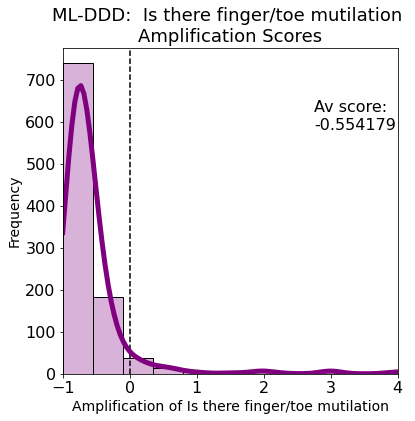

 av amp for Does someone have a seizure: -0.4958382878388832


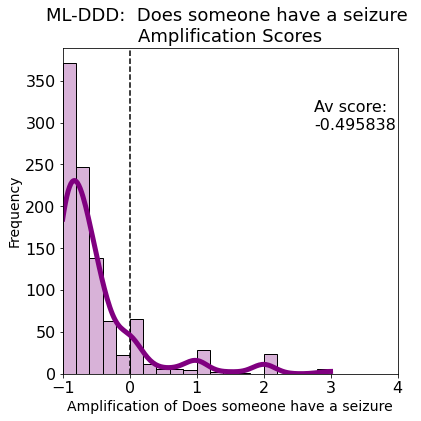

 av amp for Is someone raped onscreen: -0.706012181167818


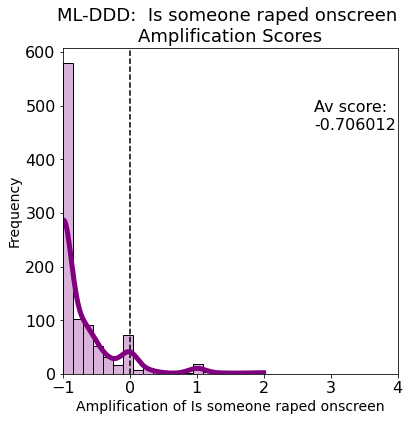

 av amp for Are there clowns: -0.5794414448672561


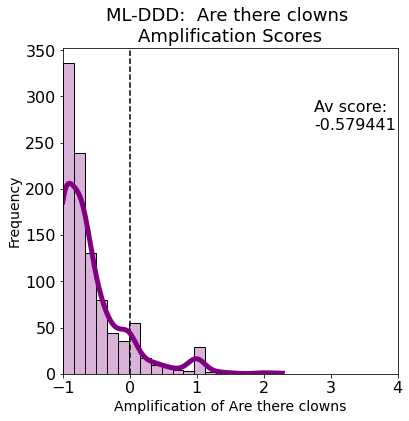

 av amp for Are any teeth damaged: -0.4644507809728892


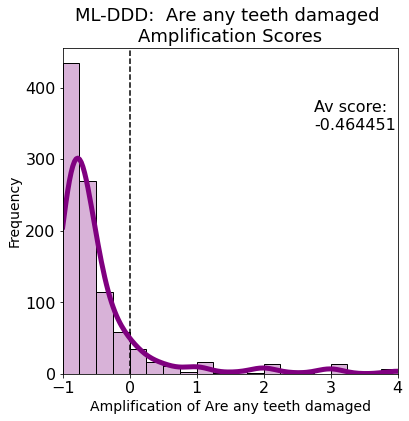

 av amp for Does a parent die: -0.6157436763135395


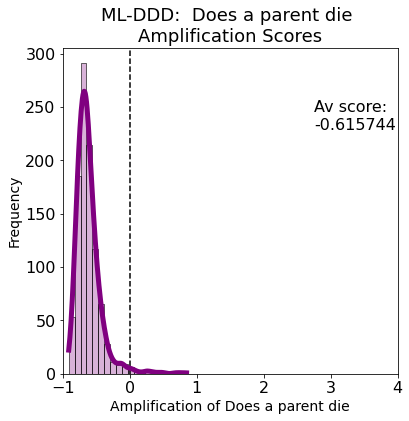

 av amp for Does the dog die: -0.04091364262254545


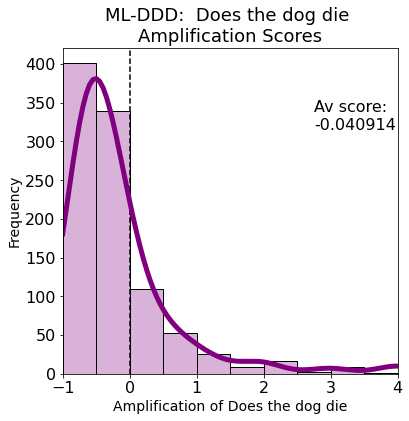

 av amp for Is there body horror: -0.7562623502913454


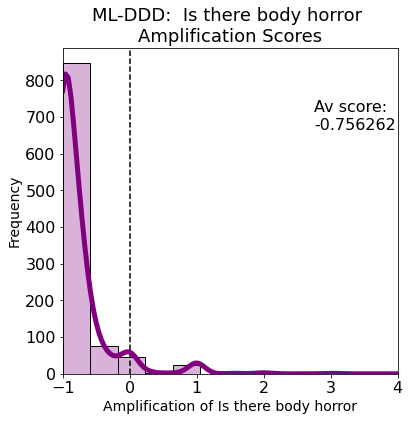

 av amp for Does someone have cancer: -0.46152307782361957


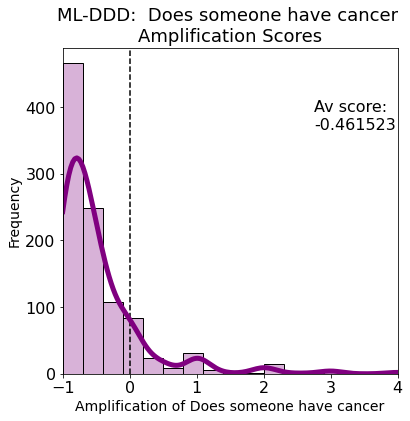

 av amp for Does someone suffer from PTSD: -0.7709244654341687


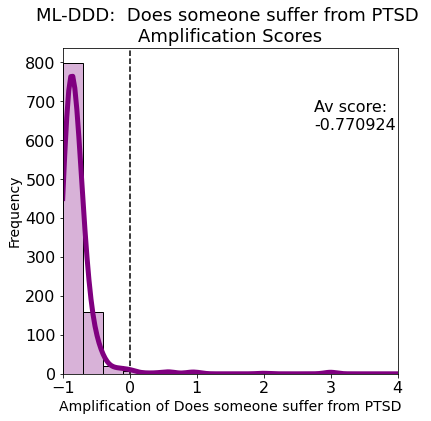

 av amp for Is someone homeless: -0.7516583321715737


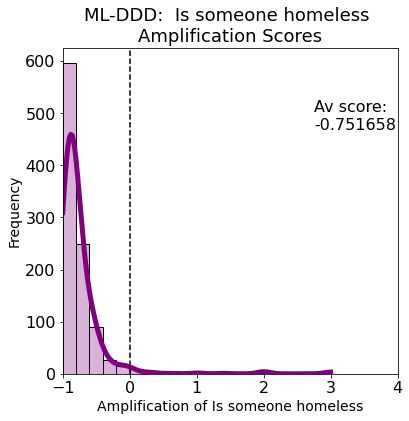

 av amp for Does a head get squashed: -0.5430458167010701


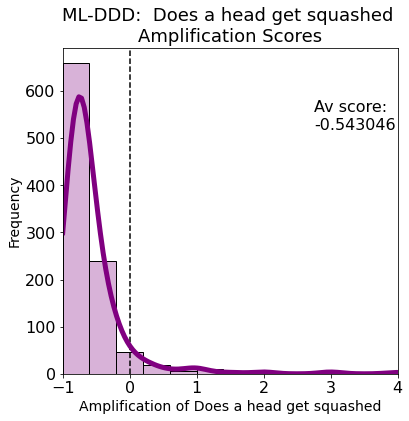

 av amp for Is there autism specific abuse: -0.7143254094516597


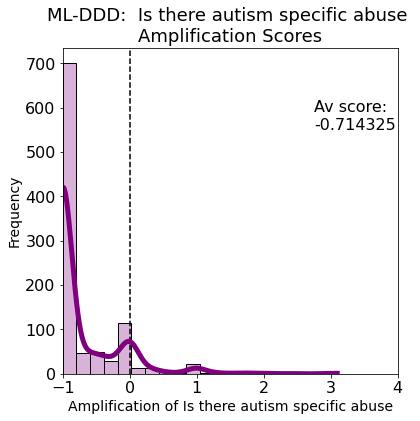

 av amp for Is there a nuclear explosion: -0.6726462848409024


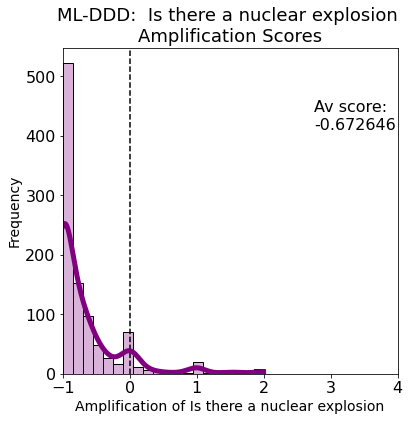

 av amp for Is there a hospital scene: -0.6406880436290988


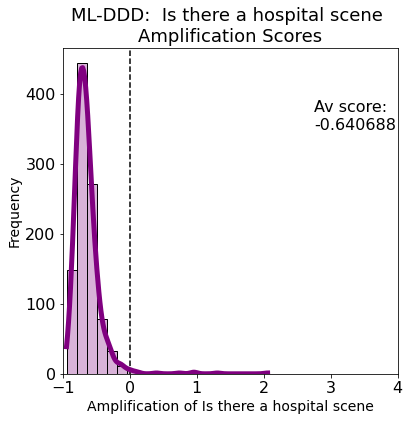

 av amp for Does a plane crash: -0.7272249707370363


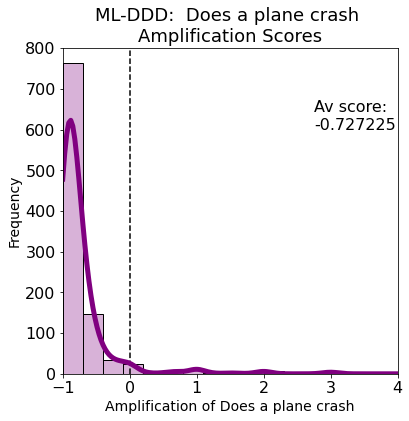

 av amp for Is a child's toy destroyed: -0.6027816963614054


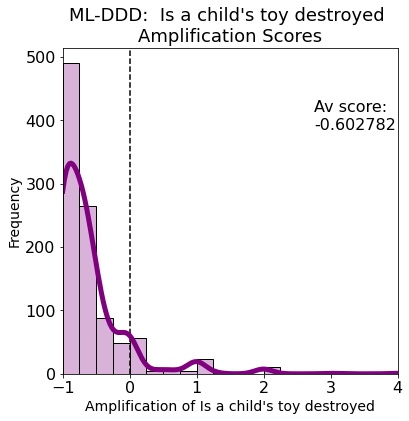

 av amp for Does someone use drugs: -0.5600479373697062


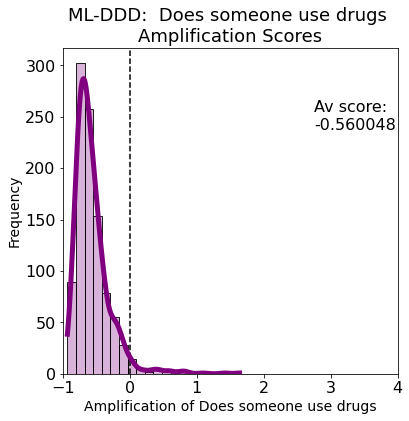

 av amp for Is there ableist language or behavior: -0.6768746443640391


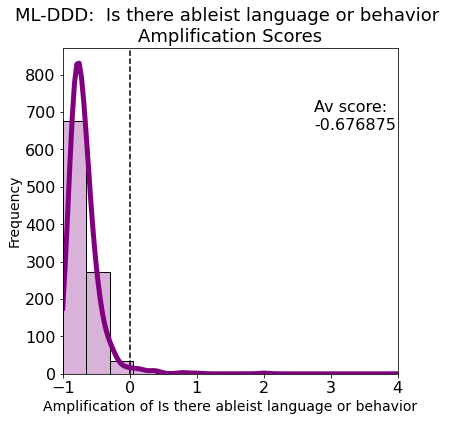

 av amp for Are there fat suits: -0.9545946666666666


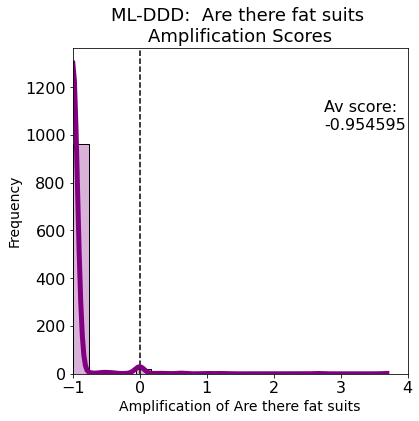

 av amp for Does the black guy die first: -0.6417412259362182


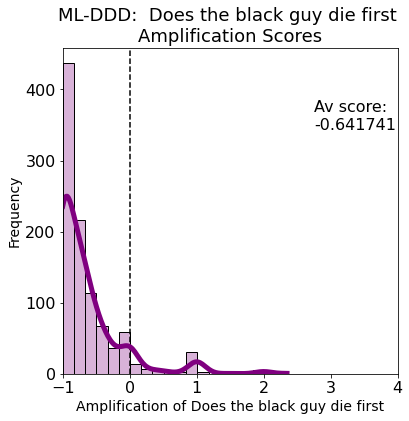

 av amp for Are there jumpscares: -0.4859831171032236


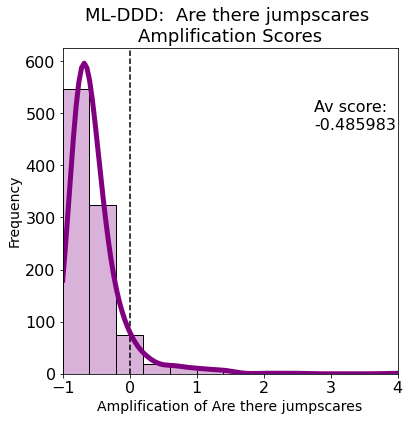

 av amp for Is there D.I.D. misrepresentation: -0.9618430952380954


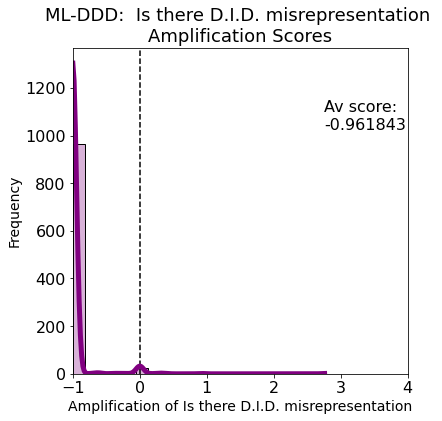

 av amp for Is electro-therapy used: -0.6201949814915524


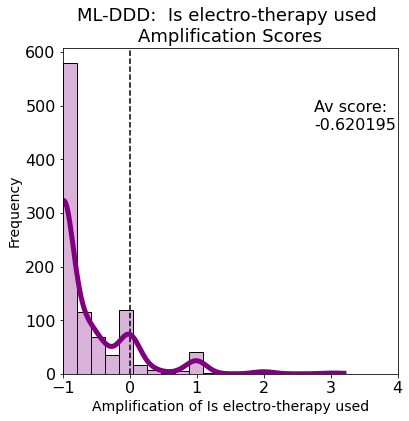

 av amp for Are animals abused: -0.6145979077763096


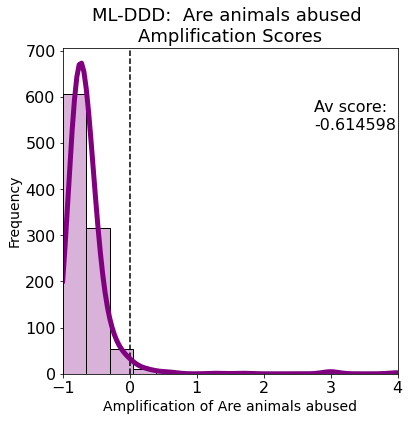

 av amp for Does someone have a stroke: -0.8019723475690976


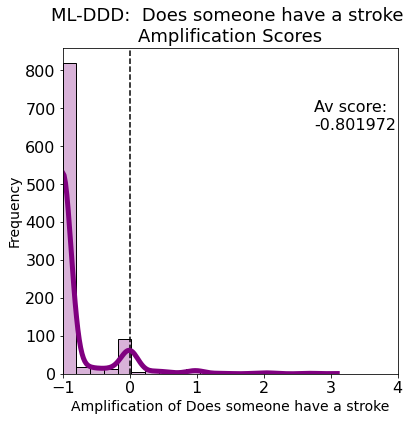

 av amp for Is there bisexual cheating: -0.9353616666666668


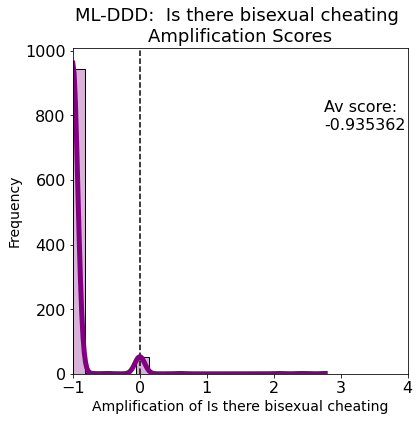

 av amp for Is there body dysmorphia: -0.5811492515214521


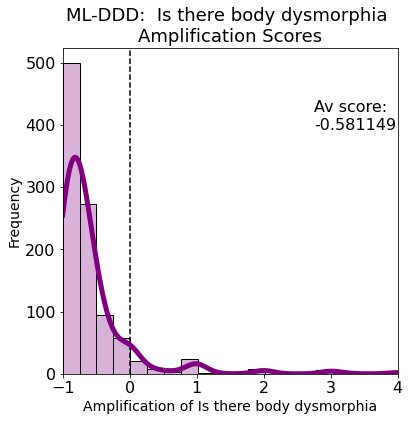

 av amp for Is someone sexually objectified: -0.79688939166771


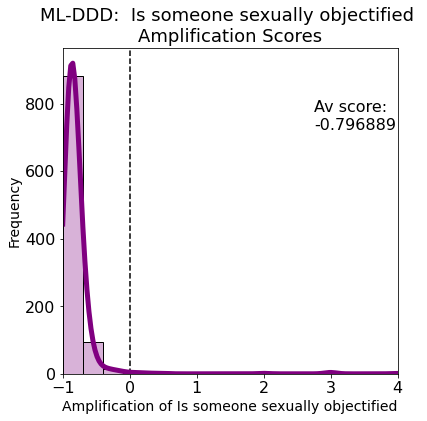

 av amp for Is the fourth wall broken: -0.6718003766831704


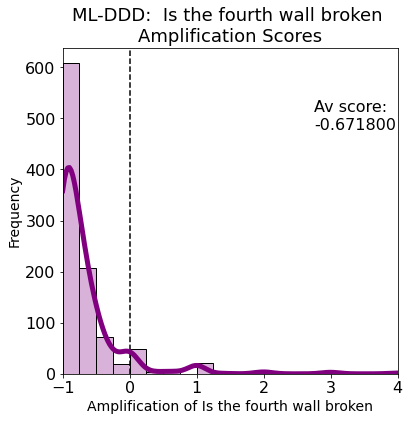

 av amp for Is someone burned alive: -0.6579204030672263


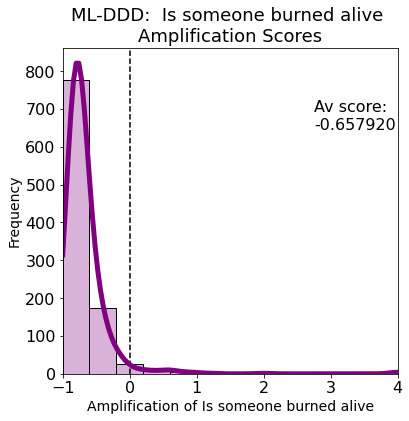

 av amp for Is there aphobia: -0.996


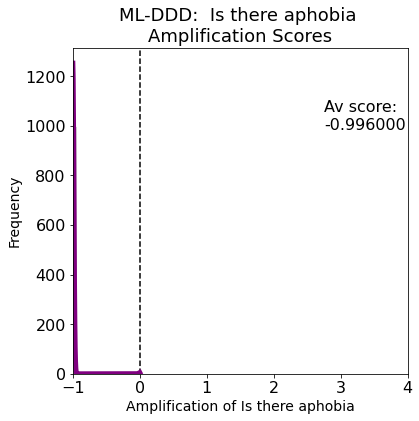

 av amp for Is there dementia/Alzheimer's: -0.8219585476190474


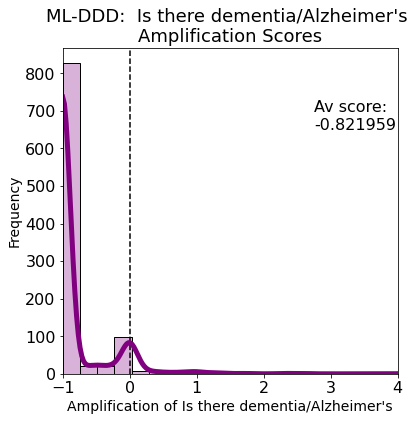

 av amp for Does someone drown: -0.4831111718811595


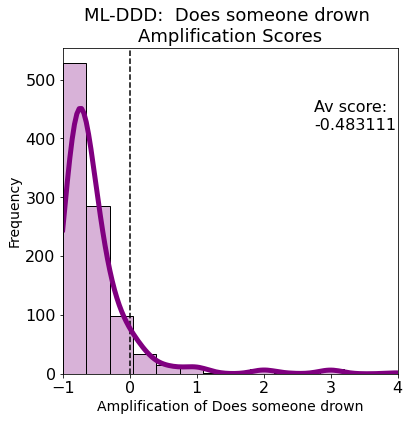

 av amp for Are there razors: -0.7810138816000814


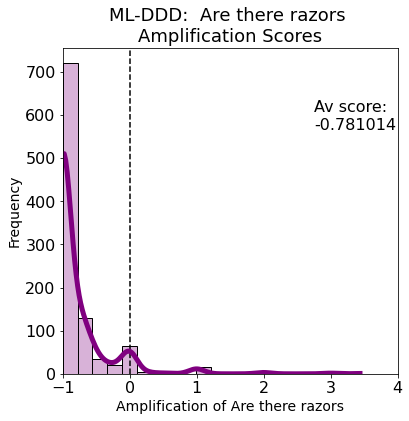

 av amp for Does a kid die: -0.4218645115830252


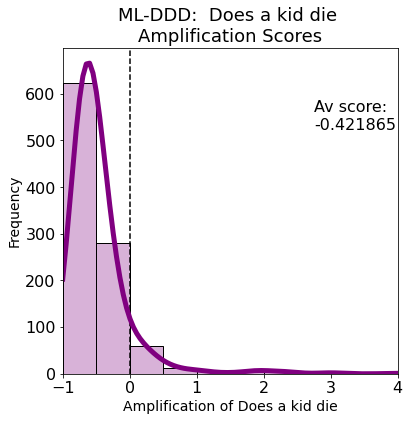

 av amp for Are there ghosts: -0.21568135789753004


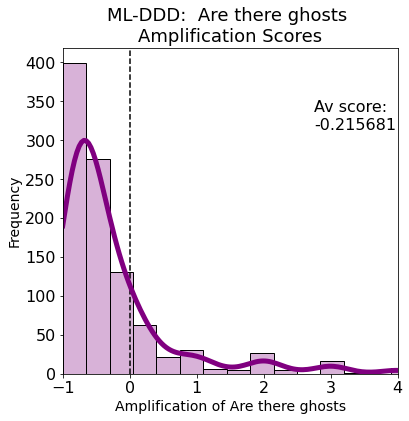

 av amp for Is there hate speech: -0.7135330936323301


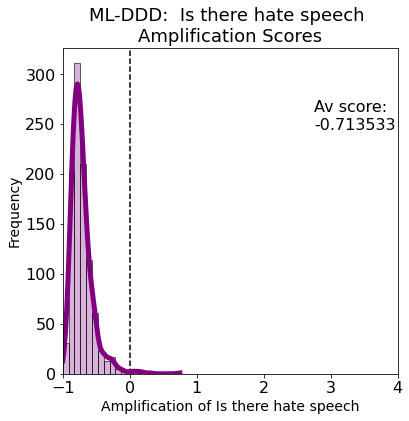

 av amp for Is a minor sexualized: -0.7034584299408171


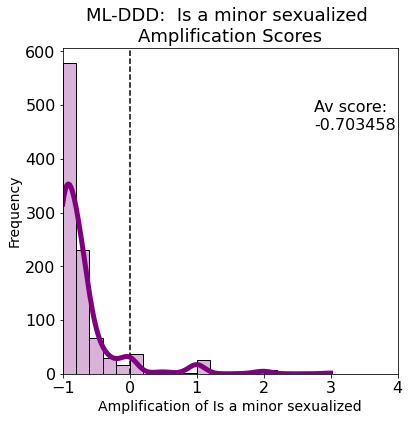

 av amp for Are there homophobic slurs: -0.5193369562310752


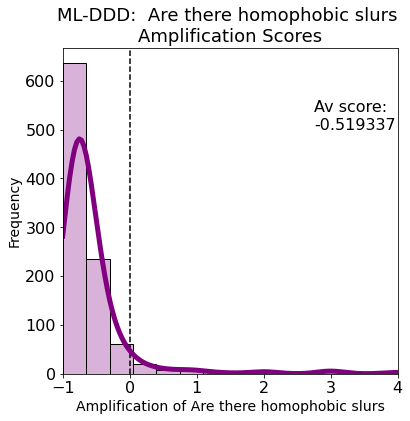

 av amp for Is there audio gore: -0.5526651335922041


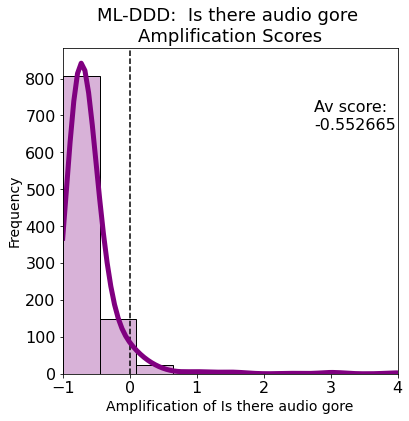

 av amp for Does someone fall down stairs: -0.7475222814607082


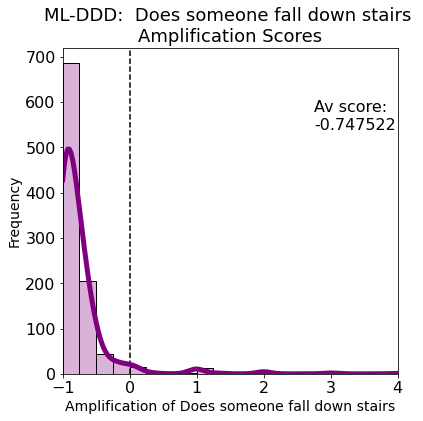

 av amp for Is someone tortured: -0.670685771495555


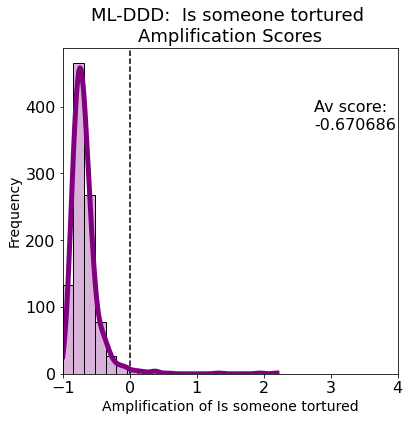

 av amp for Does a baby cry: -0.685220313056174


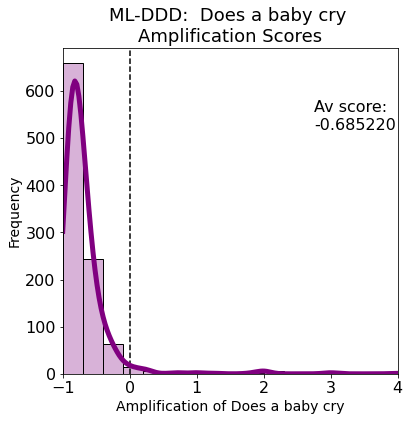

 av amp for Are there bugs: -0.5804239219129899


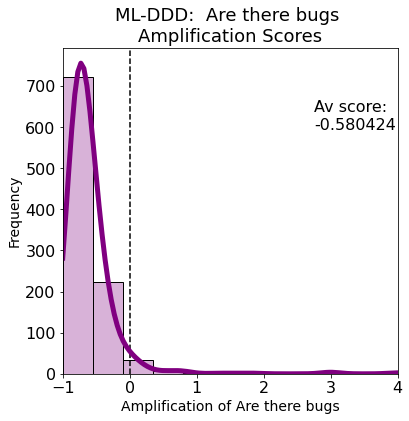

 av amp for Does a car honk or tires screech: -0.8273774604129438


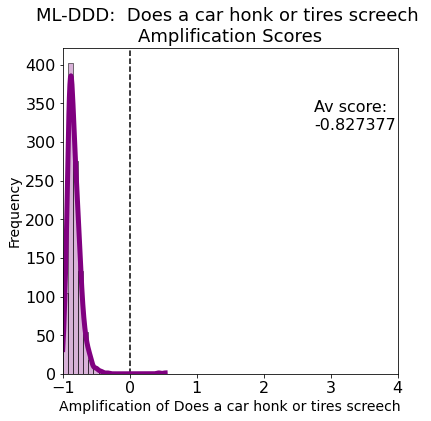

 av amp for Does someone fall to their death: -0.6805954944760125


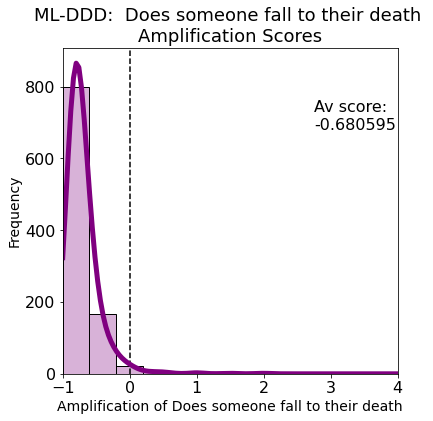

 av amp for Are there babies or unborn children: -0.7162803302175419


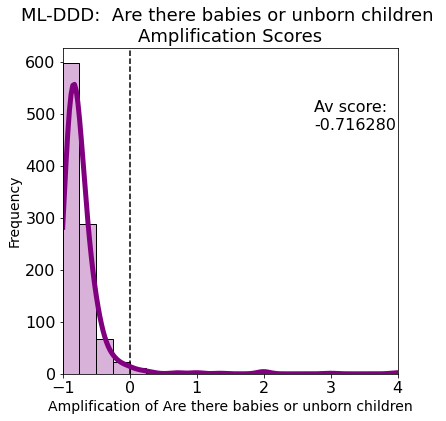

 av amp for Is there bestiality: -0.9820500000000001


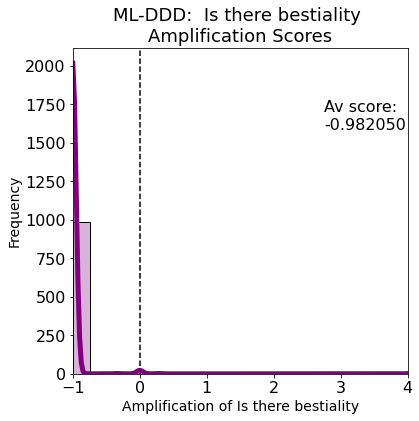

 av amp for Is there shaving/cutting: -0.6560566064920611


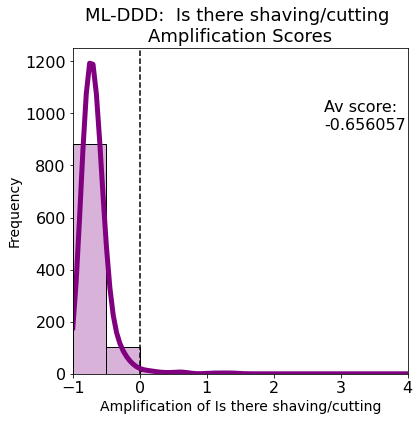

 av amp for Is there excessive gore: -0.46585173774117533


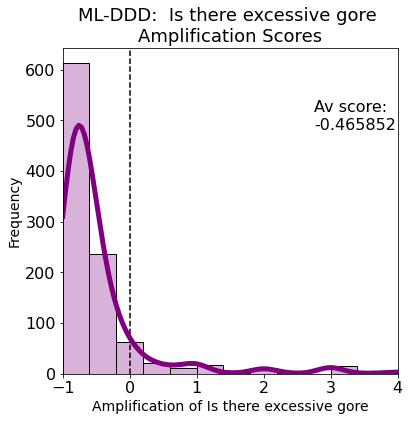

 av amp for Does someone fart or spit: -0.739634980097408


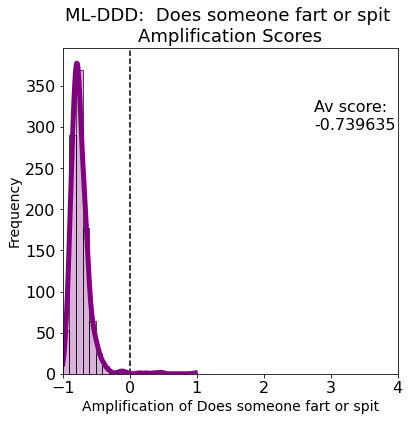

 av amp for Does a pregnant person die: -0.3399462424258231


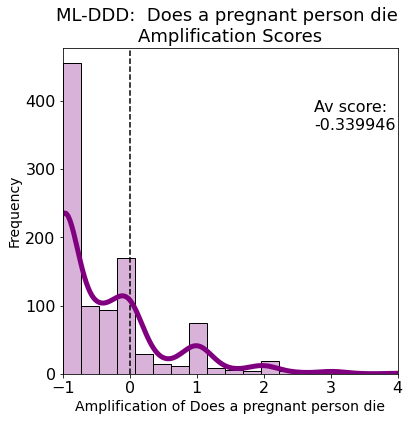

 av amp for Is there cannibalism: -0.30020663744235326


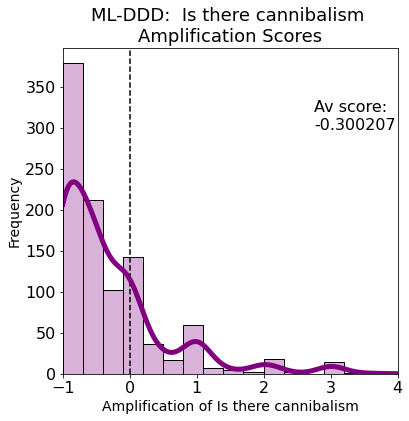

 av amp for Is someone kidnapped: -0.7000486607508207


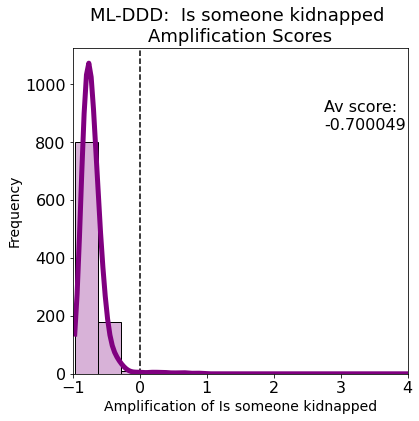

 av amp for Are there mannequins: -0.8574941478354977


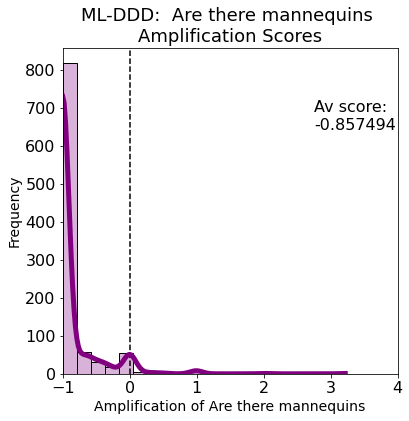

 av amp for Are needles/syringes used: -0.6800637048085301


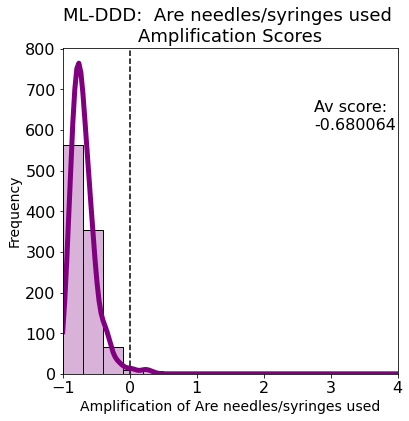

 av amp for Is someone drugged: -0.8015945550529535


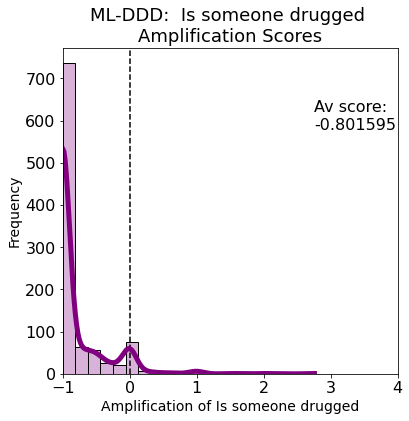

 av amp for Is someone gaslighted: -0.6694442573717889


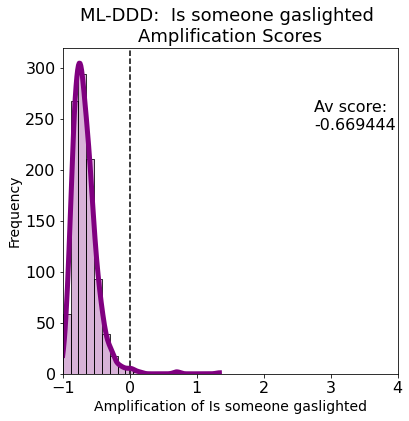

 av amp for Is an infant abducted: -0.7949076571345327


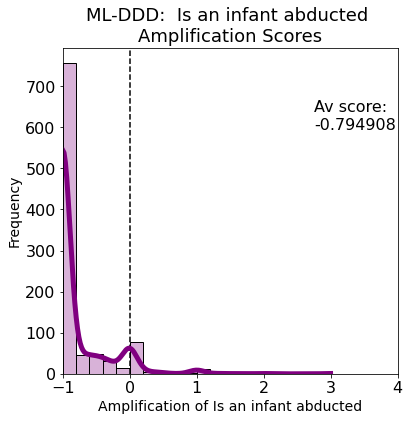

 av amp for Is someone crushed to death: -0.7466356320780534


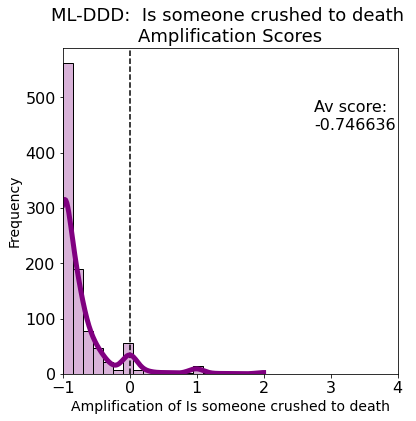

 av amp for Are there nude scenes: -0.7230691245857245


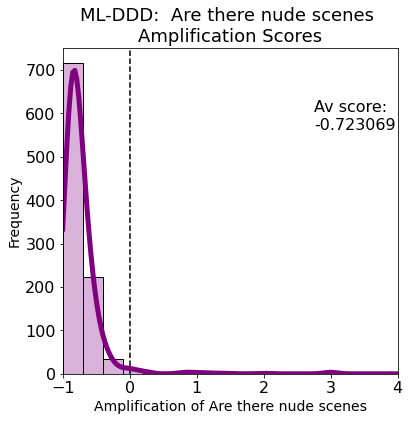

 av amp for Does it have a sad ending: -0.27457512837048903


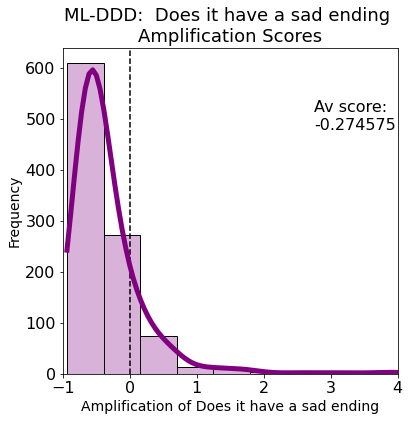

 av amp for Does someone say "I'll kill myself": -0.6736731695249095


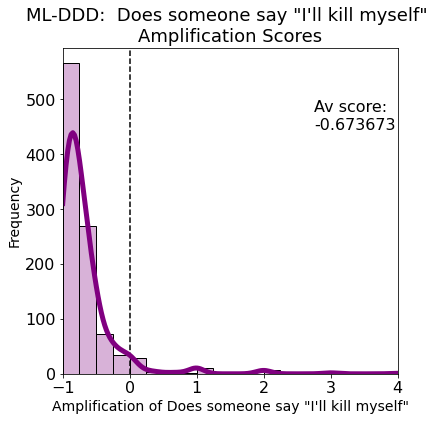

 av amp for Are there n-words: -0.650979542792159


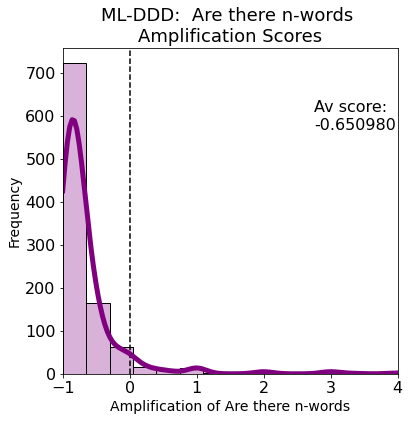

 av amp for Is someone restrained: -0.8117277114875471


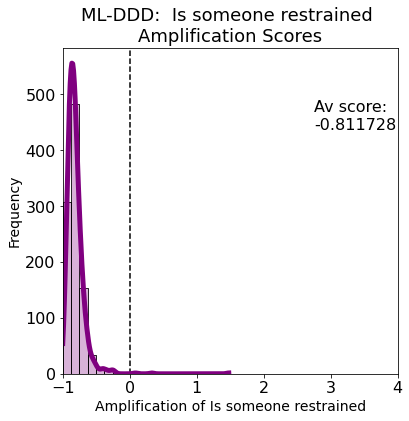

 av amp for Does a dragon die: -0.7407802698412699


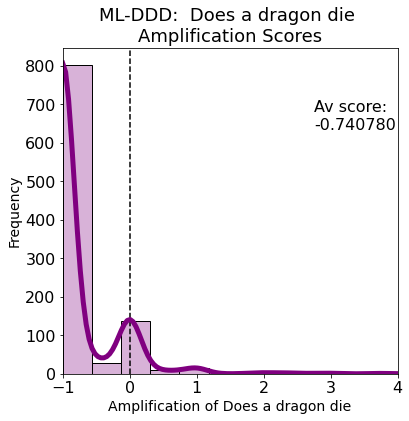

 av amp for Is there copaganda: -0.646544212749241


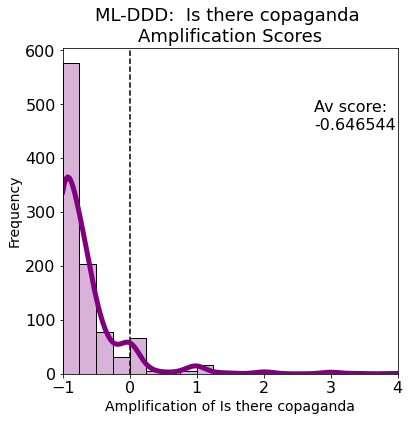

 av amp for Is there gun violence: -0.7145550159774823


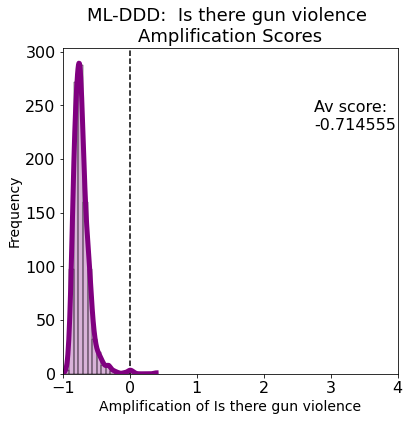

 av amp for Does someone vomit: -0.5247220281552889


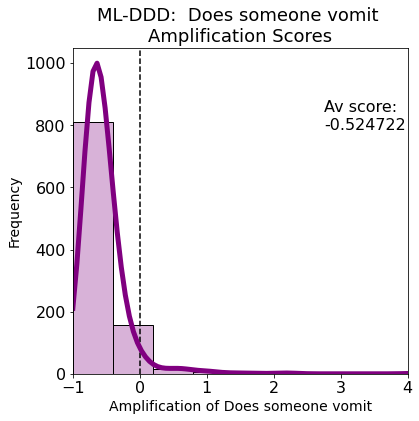

 av amp for Does an LGBT person die: -0.3479953293051309


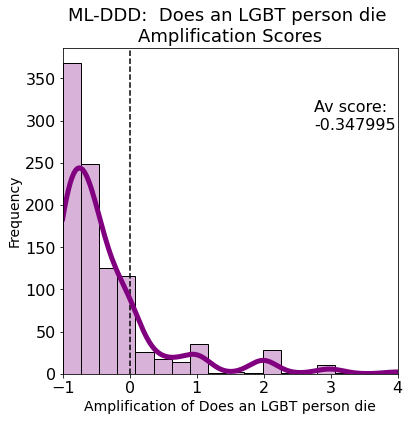

 av amp for Is someone stalked: -0.5489840088124011


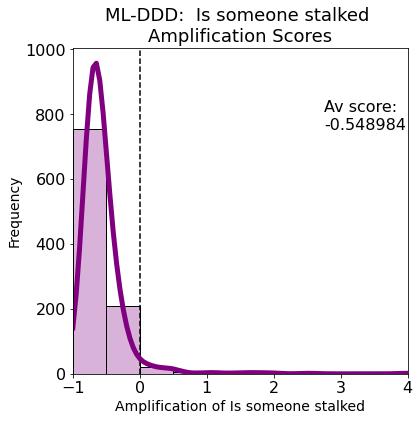

 av amp for Does a non-human character die: -0.9486866666666667


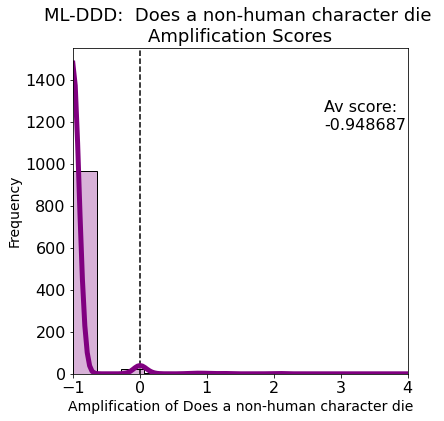

 av amp for Is there antisemitism: -0.6871544939567046


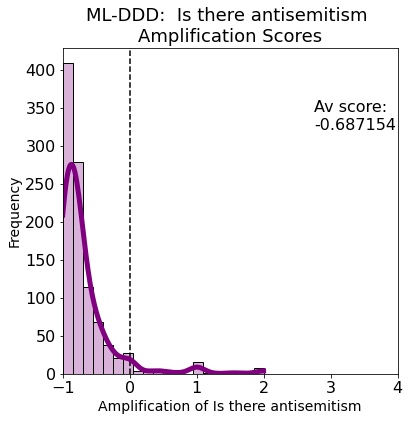

 av amp for Is there a shower scene: -0.6279018430315978


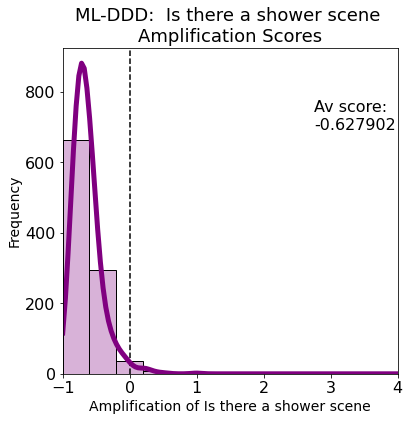

 av amp for Is Santa (et al) spoiled: -0.6890578461538461


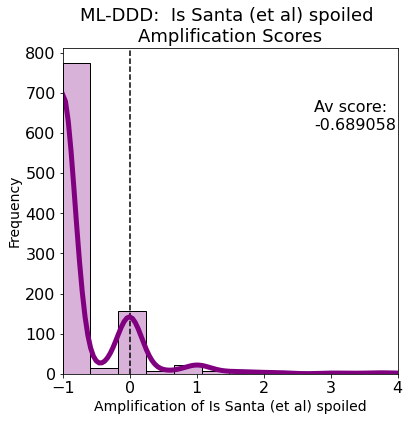

 av amp for Does someone die by suicide: -0.5459577650683842


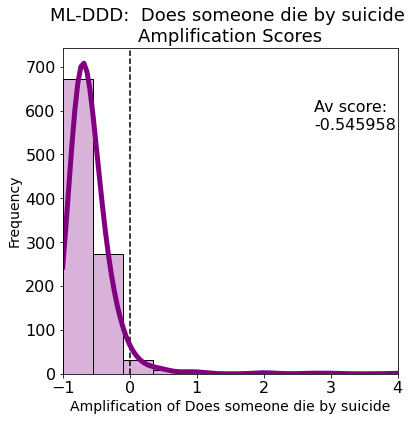

 av amp for Is a male character ridiculed for crying: -0.7849128656716174


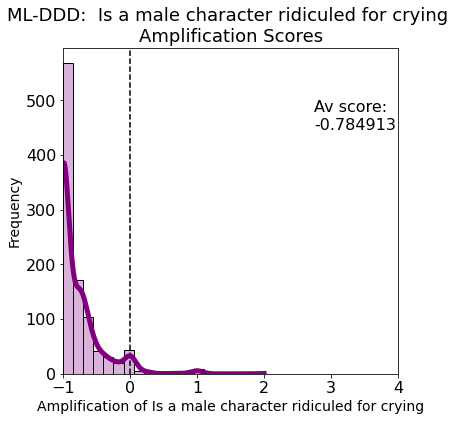

 av amp for Is someone buried alive: -0.4878346544293776


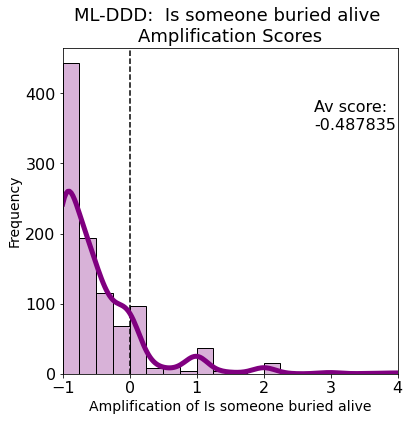

 av amp for Does someone sacrifice themselves: -0.7625697396313373


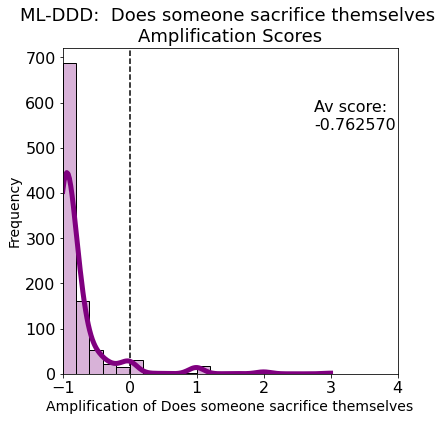

 av amp for Is there sexual content: -0.619881192111798


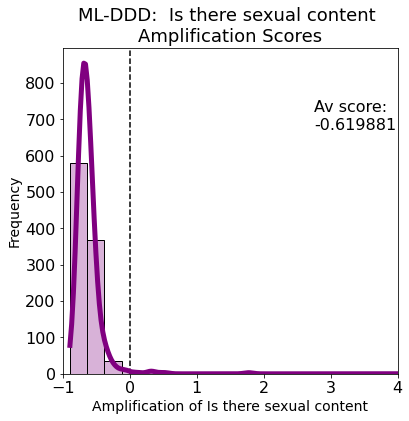

 av amp for Are there incestuous relationships: -0.32773113163964834


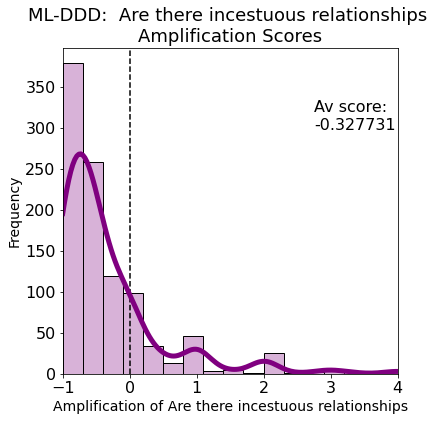

 av amp for Does someone abuse alcohol: -0.5517707547160644


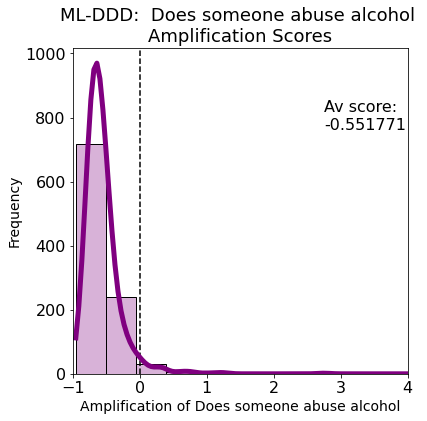

 av amp for Is a mentally ill person violent: -0.6151918829706511


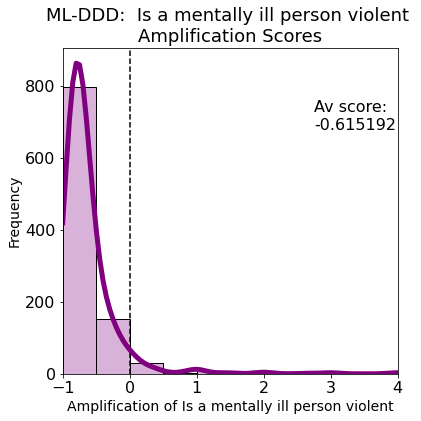

 av amp for Are there flashing lights or images: -0.6215086097970789


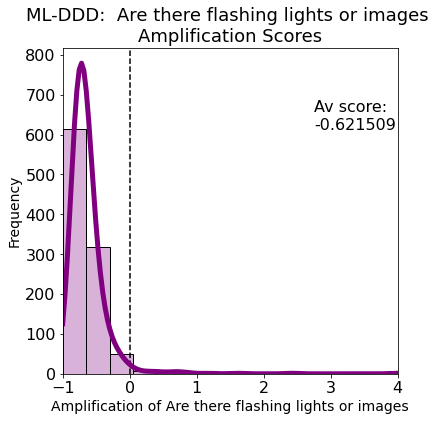

 av amp for Is someone sexually assaulted: -0.595815063027569


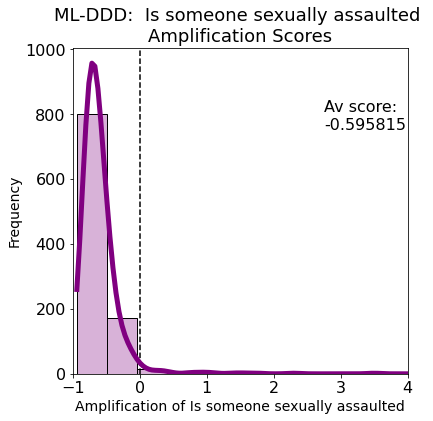

 av amp for Are there "Man in a dress" jokes: -0.7633939568485049


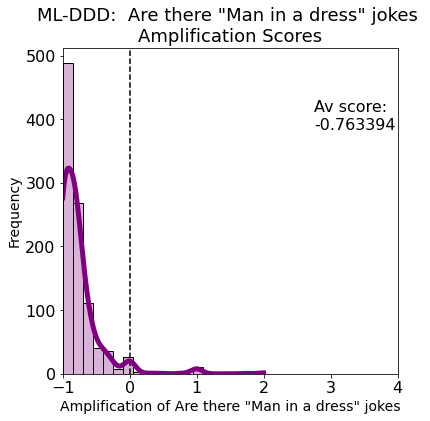

 av amp for Is there a dead animal: -0.653719408171917


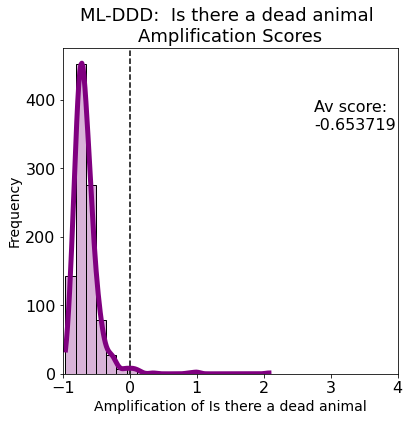

 av amp for Is someone hit by a car: -0.631383560659741


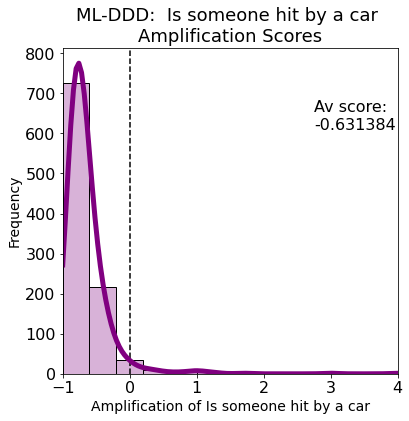

In [60]:
warning_amplification_plots(random_amplification_dfs)

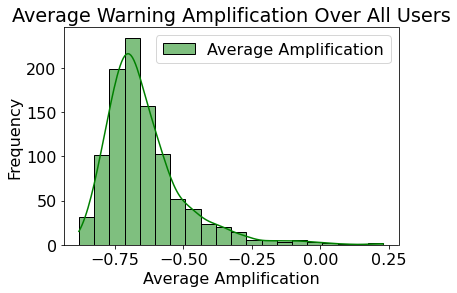

In [61]:
user_amplification_plots(random_amplification_dfs)

### SVD Algorithm

In [62]:
svd_amplification_dfs = amplification_dfs(svd_recs)

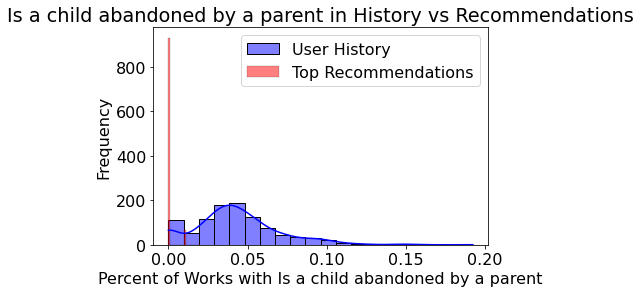

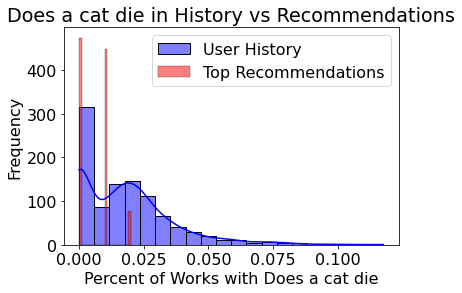

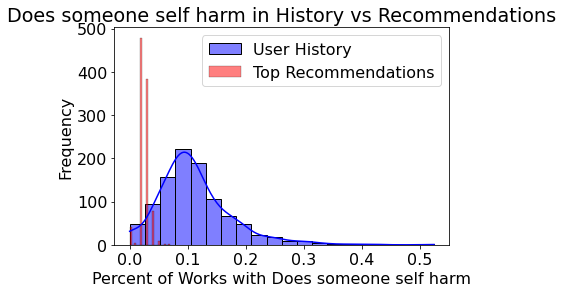

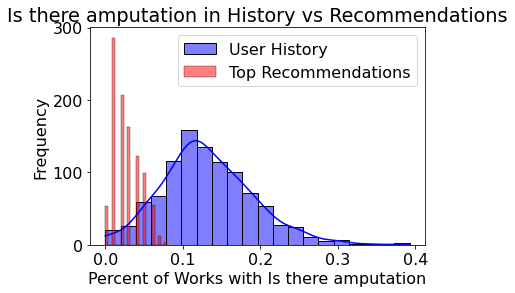

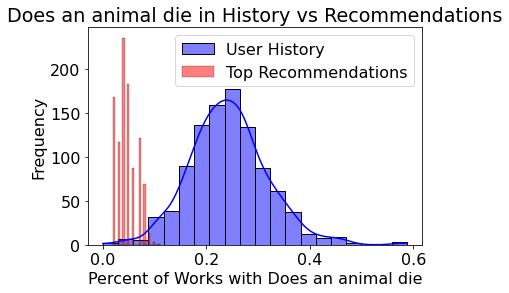

...

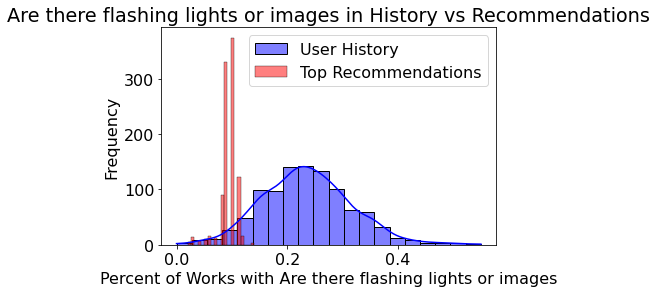

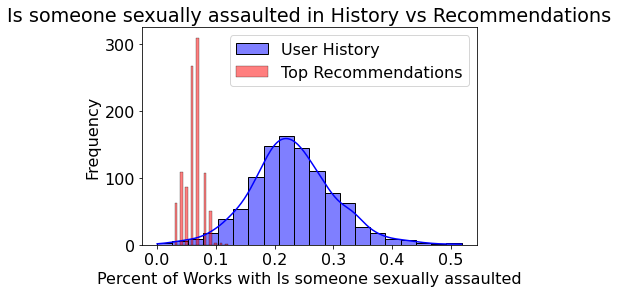

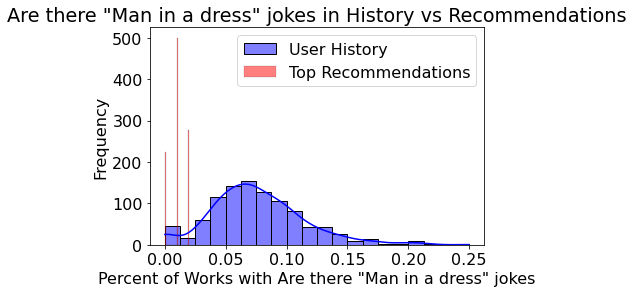

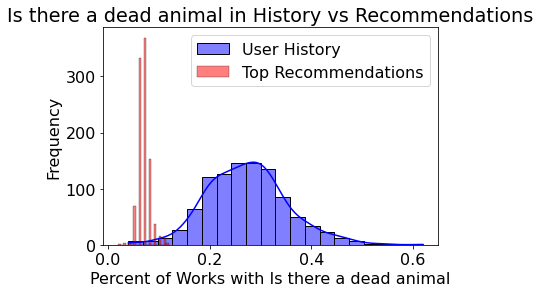

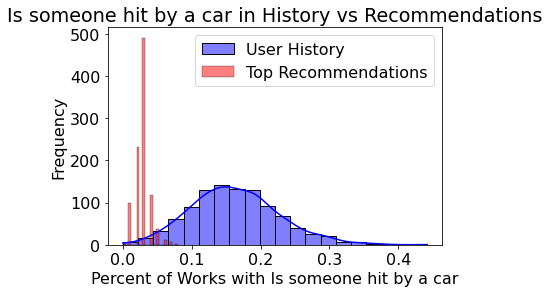

In [63]:
warning_distribution_plots(svd_amplification_dfs)

 av amp for Is a child abandoned by a parent: -0.9623587530479845


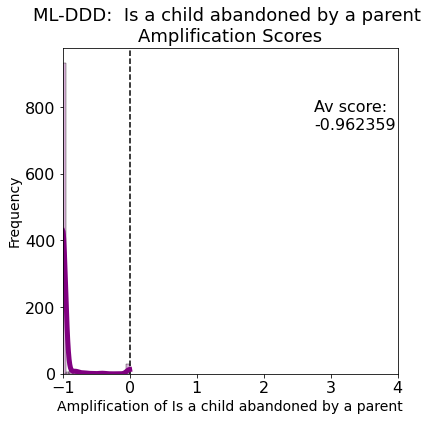

 av amp for Does a cat die: -0.5656025206680955


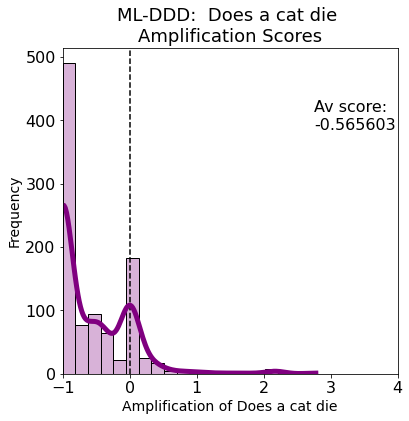

 av amp for Does someone self harm: -0.6388843317473138


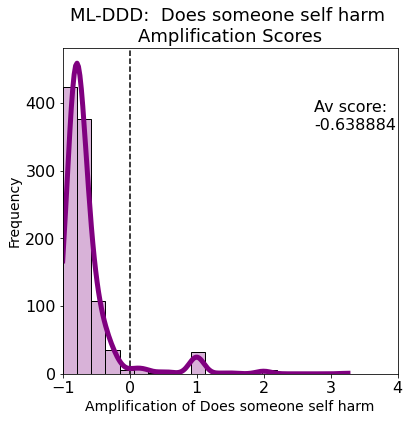

 av amp for Is there amputation: -0.7261956804594674


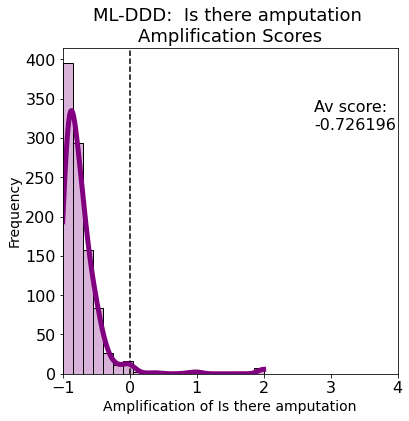

 av amp for Does an animal die: -0.7814624246672698


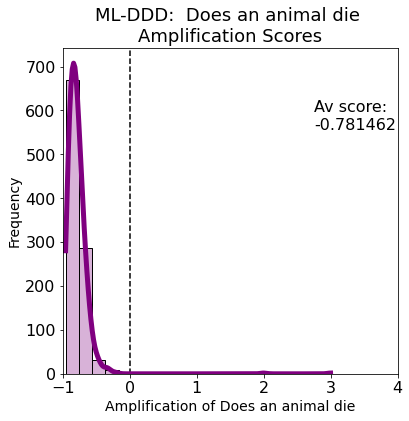

 av amp for Does someone overdose: -0.45642794428855454


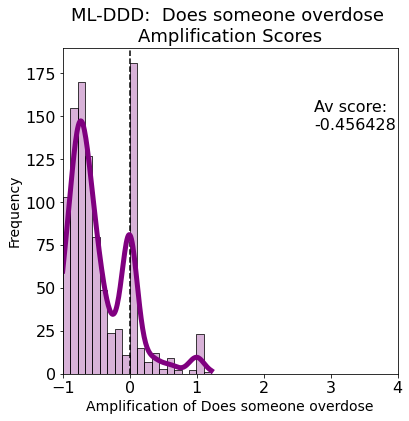

 av amp for Are there snakes: -0.3537324106223396


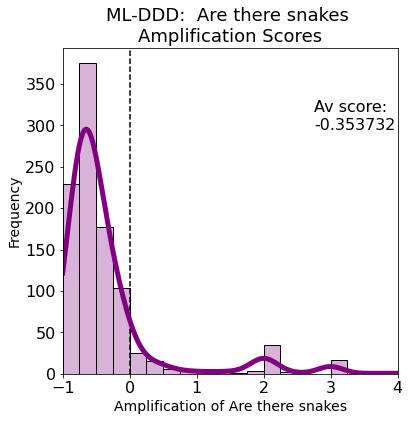

 av amp for Is there Achilles Tendon injury: -0.7006720833333333


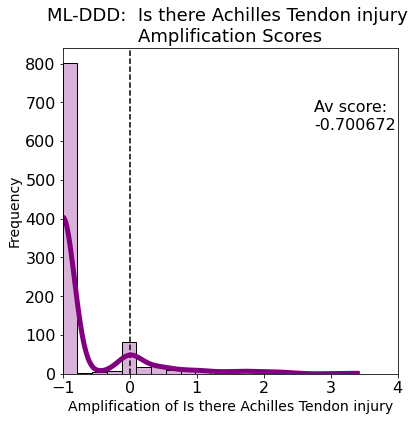

 av amp for Is there a large age gap: -0.8326383294016653


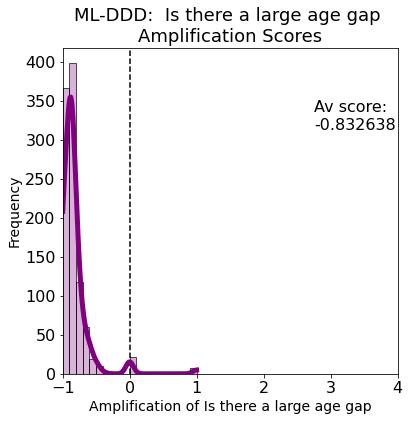

 av amp for Does someone becomes unconscious: -0.9447965205915313


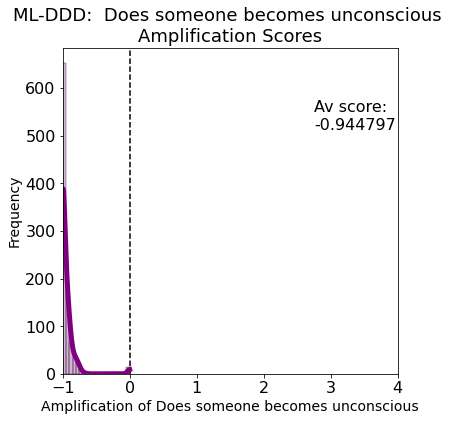

 av amp for Is a baby stillborn: -0.9627471428571428


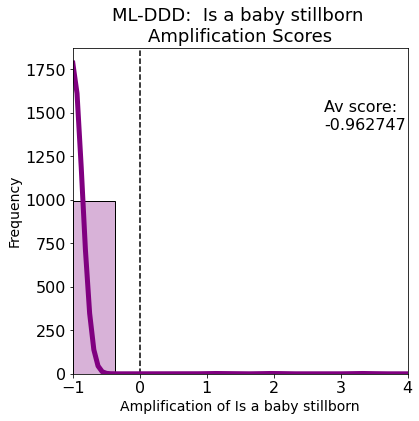

 av amp for Is there eye mutilation: -0.8303278466097421


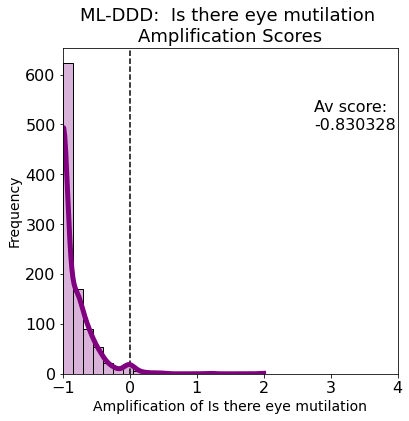

 av amp for Does someone cheat: -0.7532794686665218


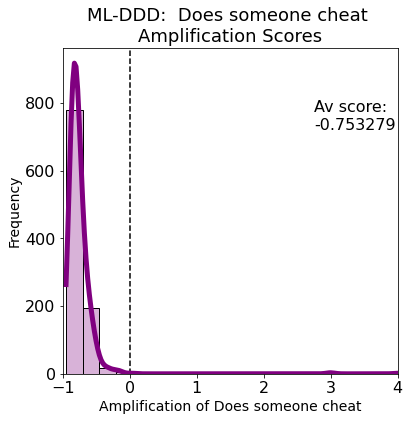

 av amp for Are there 9/11 depictions: -0.9875485227272728


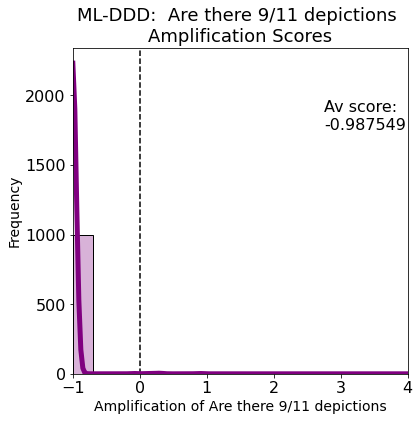

 av amp for Is there childbirth: 0.01639991046667659


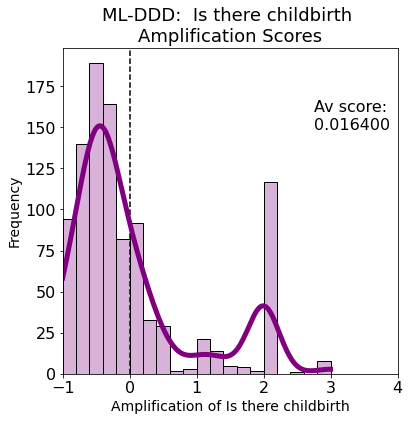

 av amp for Is someone misgendered: -0.5941162453426793


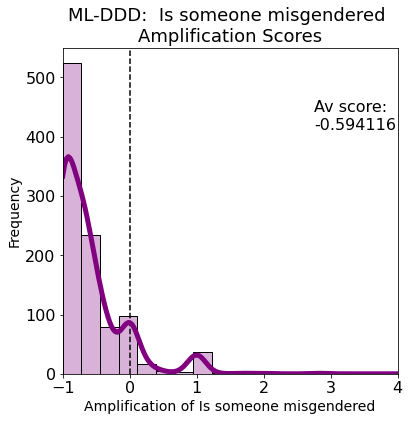

 av amp for Is a minority is misrepresented: -0.9974297087065055


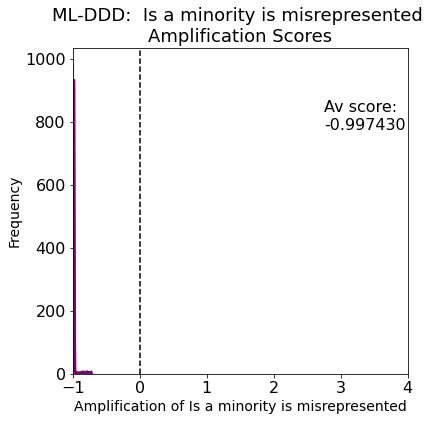

 av amp for Are there fat jokes: -0.925584239068816


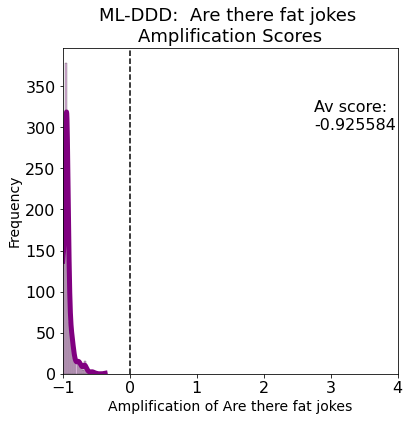

 av amp for Are there anxiety attacks: -0.7959392565953533


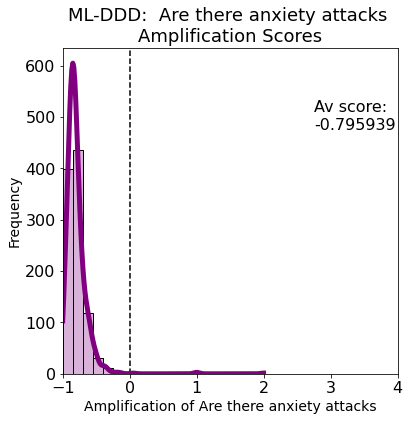

 av amp for Are there spiders: -0.4134343371127097


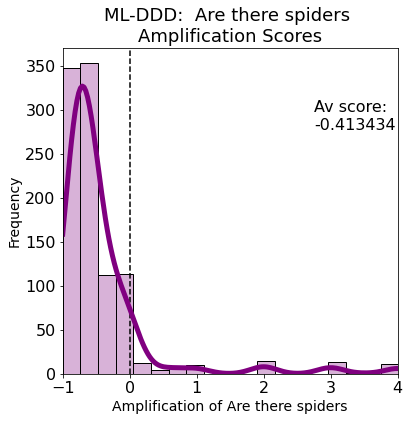

 av amp for Does a car crash: -0.8143149910796186


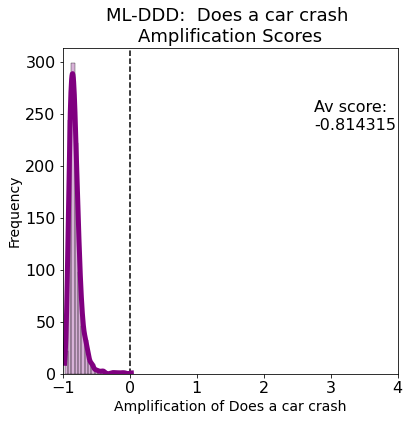

 av amp for Is there domestic violence: -0.7249037417454913


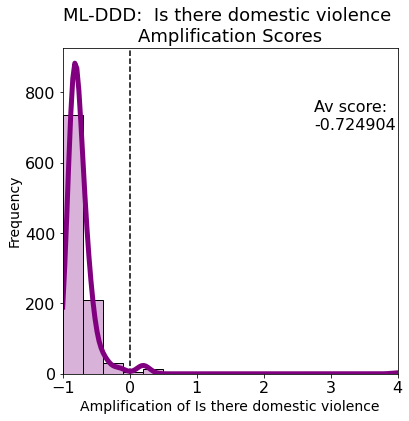

 av amp for Does someone struggle to breathe: -0.7612333390822507


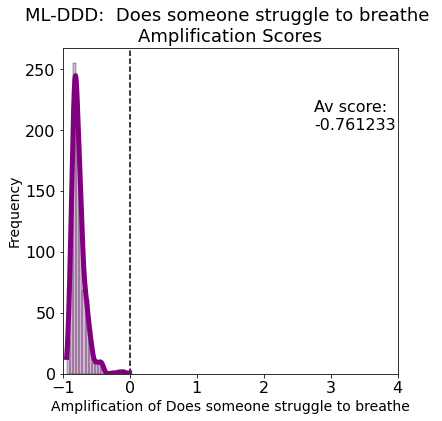

 av amp for Does the abused become the abuser: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


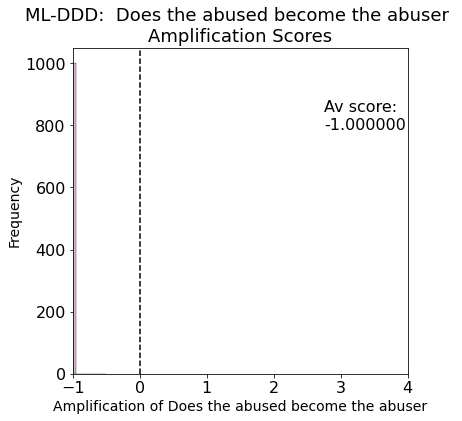

 av amp for Is there a mental institution scene: -0.4720039533526269


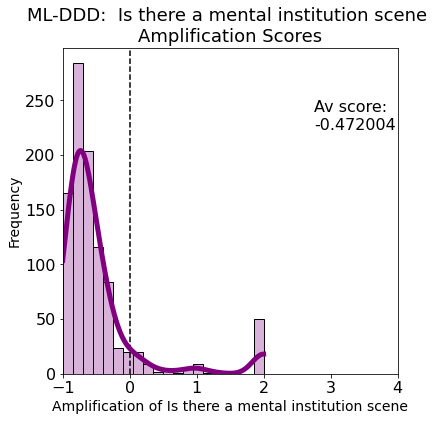

 av amp for Does someone asphyxiate: -0.9076909738731035


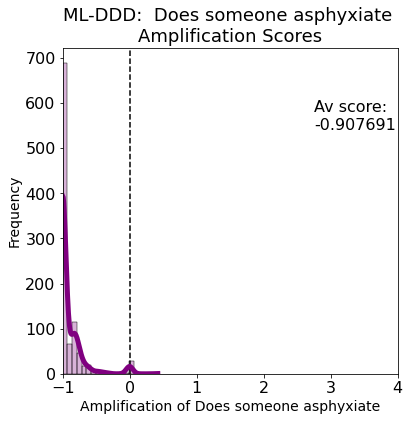

 av amp for Is a child abused: -0.5710619985187966


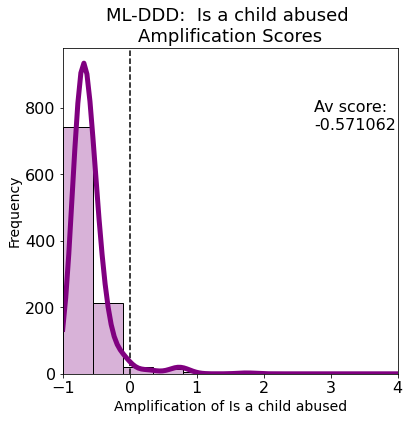

 av amp for Does someone miscarry: -0.9836053516015103


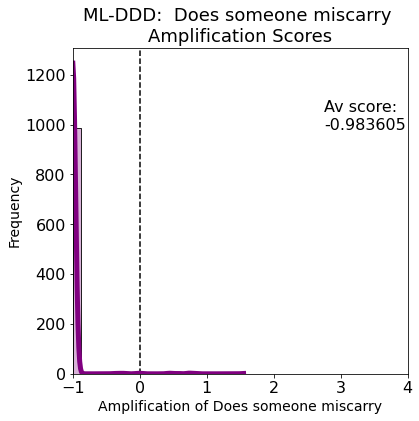

 av amp for Does a pet die: -0.7559995957146334


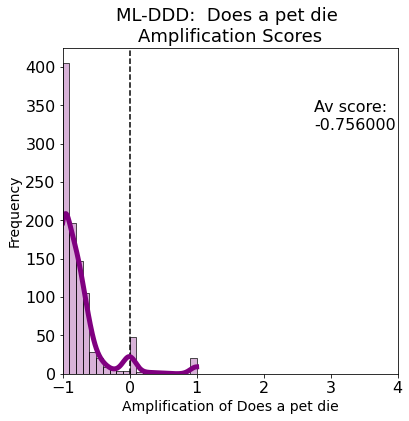

 av amp for Is someone possessed: -0.22142123499696534


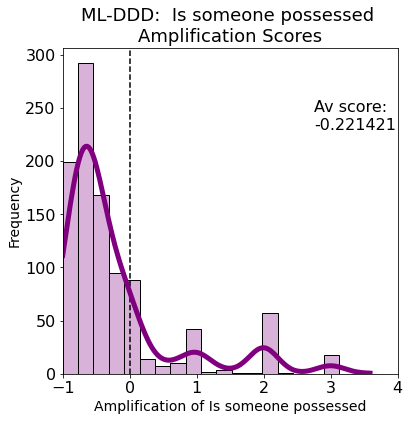

 av amp for Does someone have an eating disorder: -0.9572513473778251


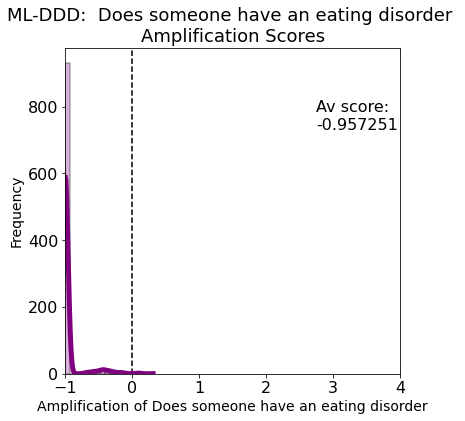

 av amp for Is there body dysphoria: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


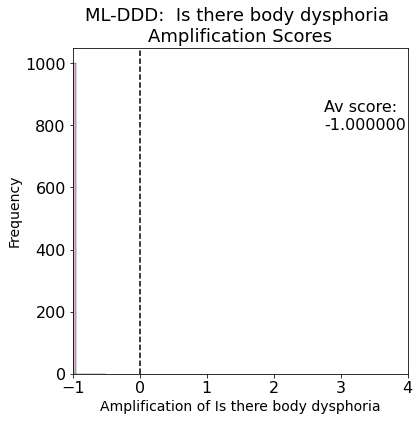

 av amp for Does a horse die: -0.9857833607167789


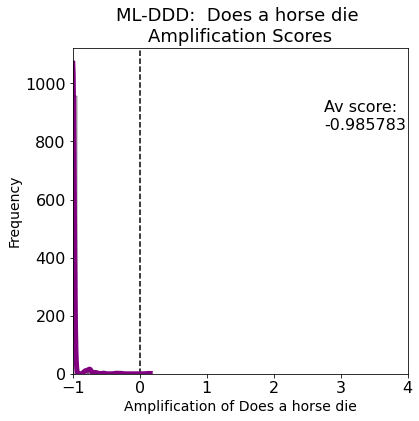

 av amp for Does someone attempt suicide: -0.8286612845042765


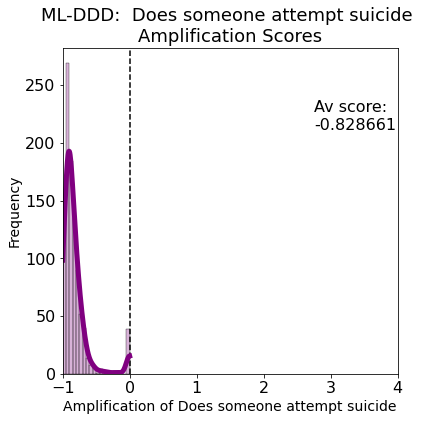

 av amp for Is there a claustrophobic scene: -0.8595426021221597


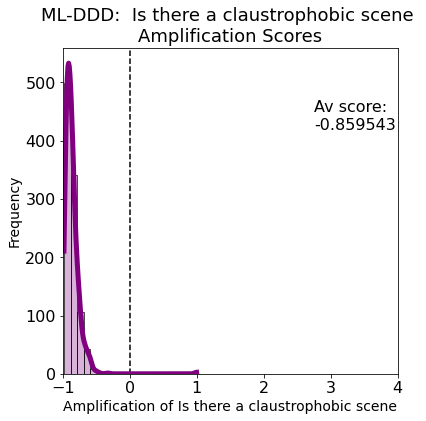

 av amp for Does someone wet/soil themselves: -0.9114122287546924


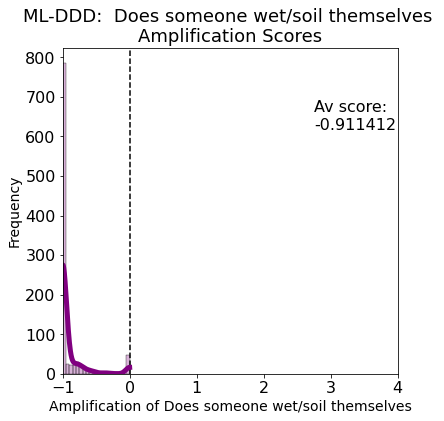

 av amp for Is there obscene language/gestures: -0.876774576247495


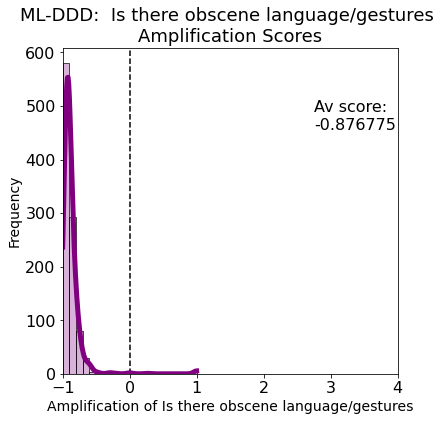

 av amp for Is there shakey cam: -0.5078157110970909


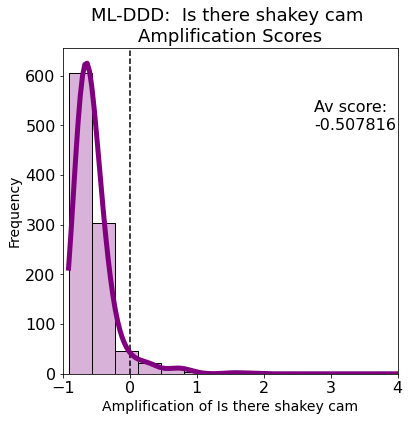

 av amp for Is there misophonia: -0.8648097669687747


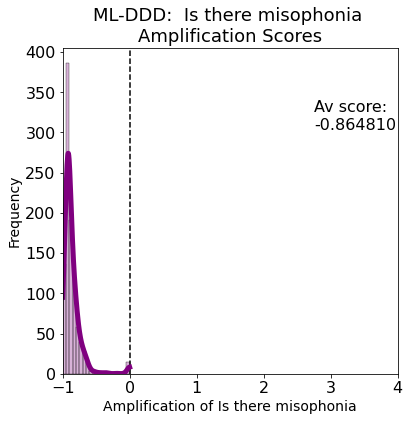

 av amp for Is there a hanging: -0.9297785418999017


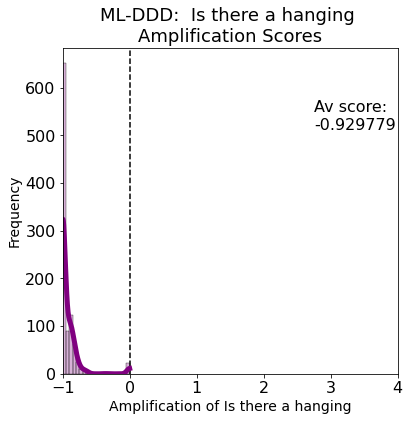

 av amp for Is there blood/gore: -0.7357948555399515


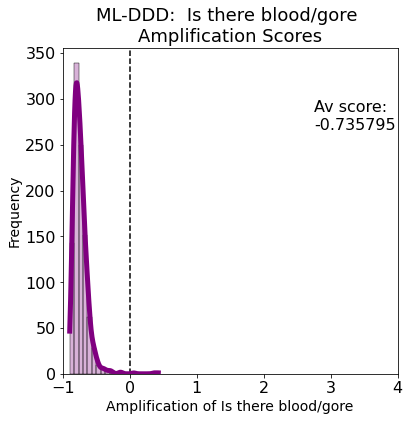

 av amp for Is there genital trauma/mutilation: -0.7361614090509687


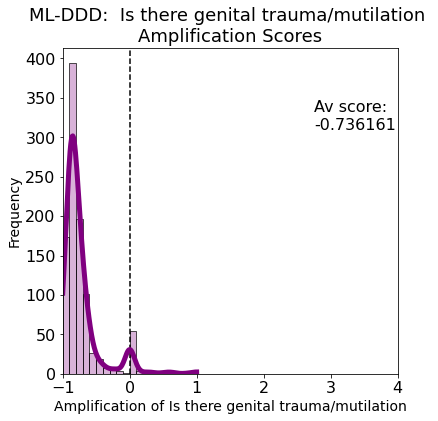

 av amp for Is there dog fighting: -0.5922116587301585


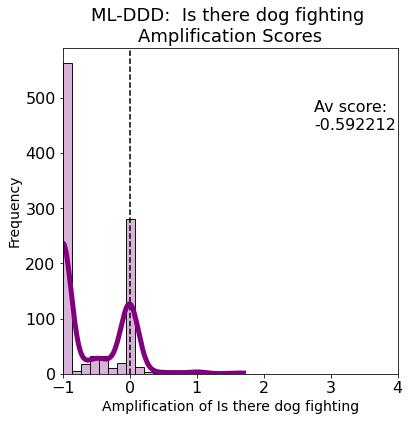

 av amp for Is there addiction: -0.5812359854971111


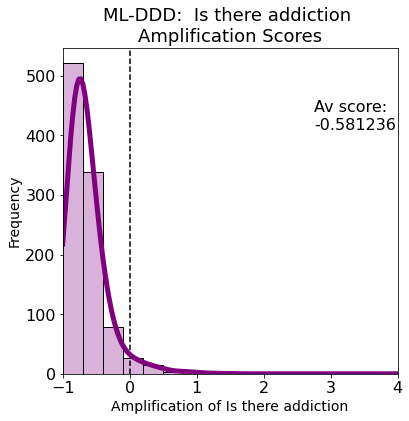

 av amp for Does someone break a bone: -0.7992595612500214


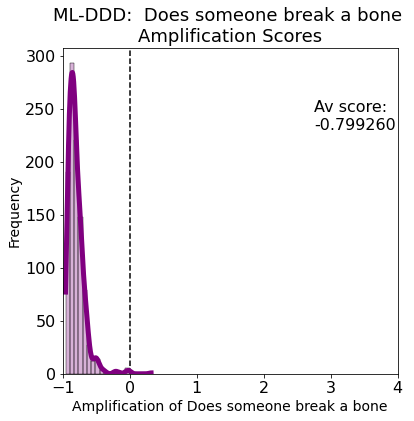

 av amp for Are there abortions: -0.9020179067939115


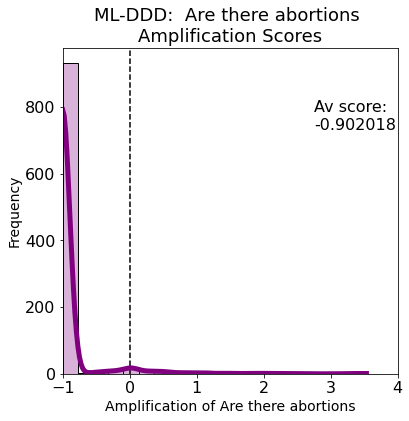

 av amp for Does someone have a chronic illness: -0.7998935004023575


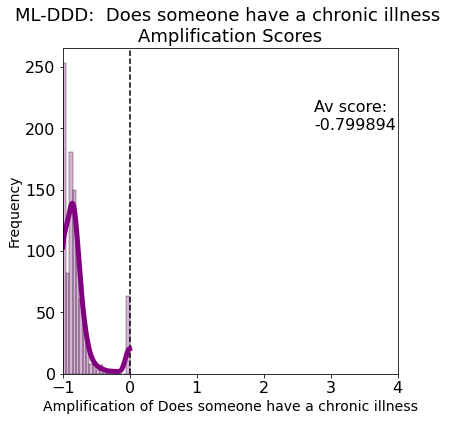

 av amp for Is the R word used: -0.834300586870648


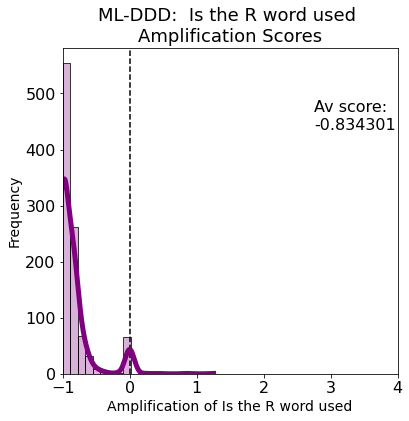

 av amp for Is there finger/toe mutilation: -0.8406997102108796


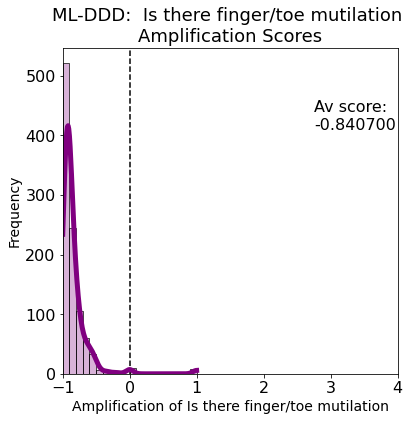

 av amp for Does someone have a seizure: -0.4065893206009252


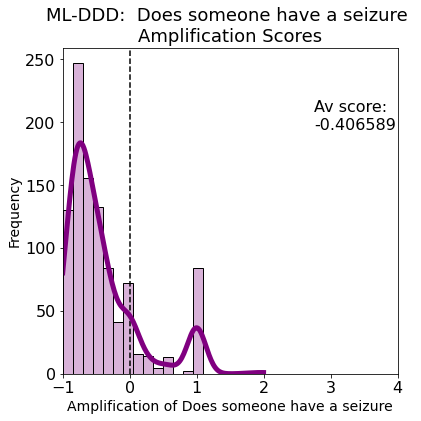

 av amp for Is someone raped onscreen: -0.8596487991954702


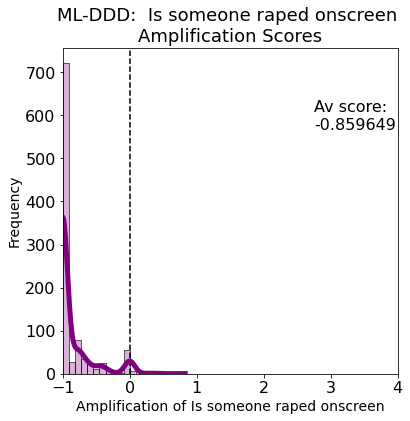

 av amp for Are there clowns: -0.2868706352924985


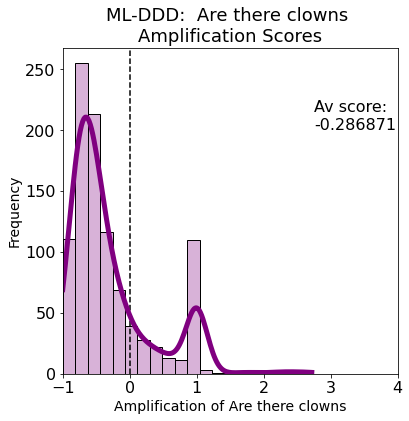

 av amp for Are any teeth damaged: -0.7821637205104454


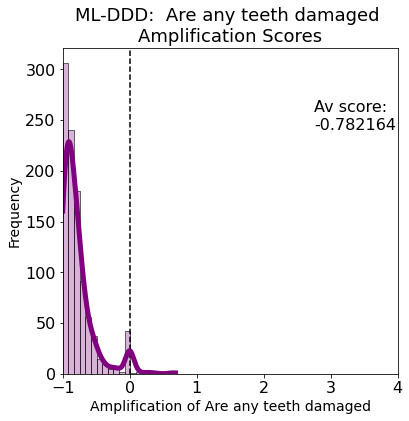

 av amp for Does a parent die: -0.74813706076134


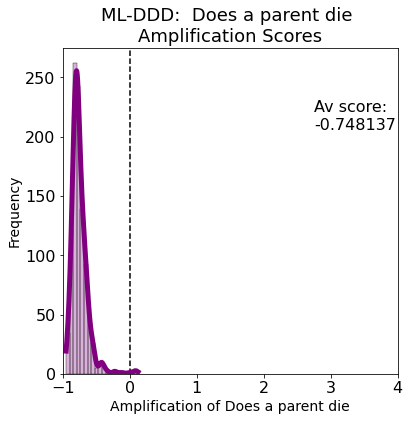

 av amp for Does the dog die: 0.03928078865251038


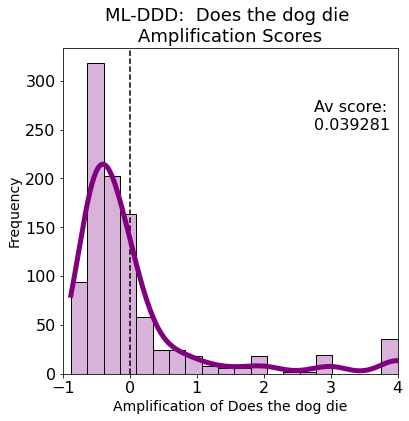

 av amp for Is there body horror: -0.9324008284004159


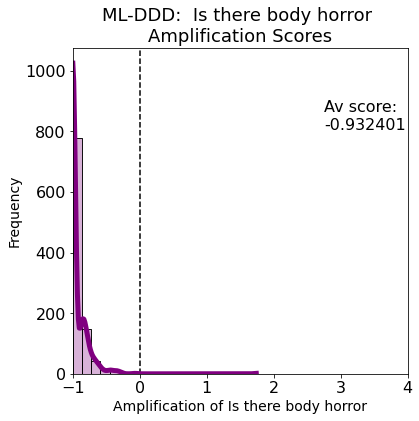

 av amp for Does someone have cancer: -0.30693946354308654


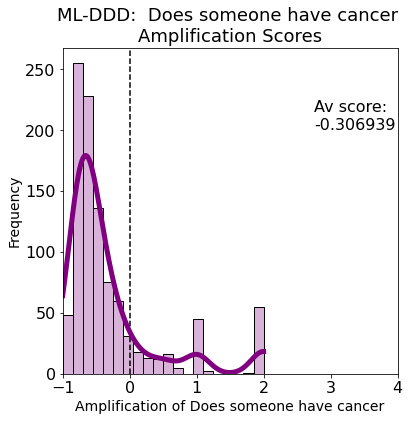

 av amp for Does someone suffer from PTSD: -0.8544932220023574


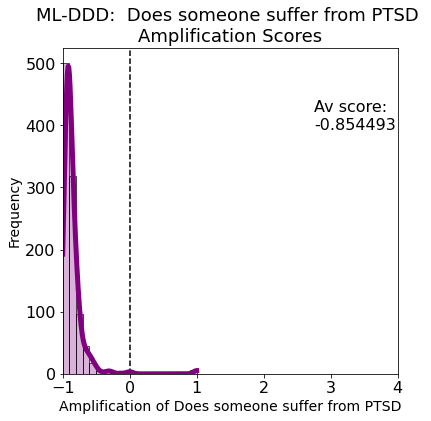

 av amp for Is someone homeless: -0.6386900867335906


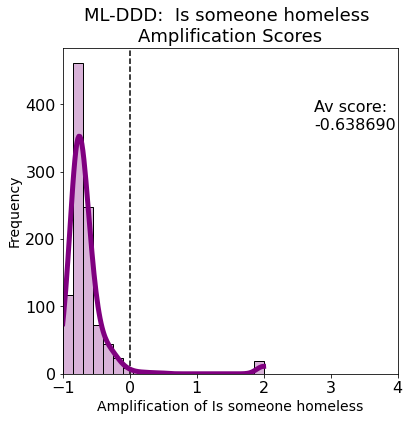

 av amp for Does a head get squashed: -0.7034528077411362


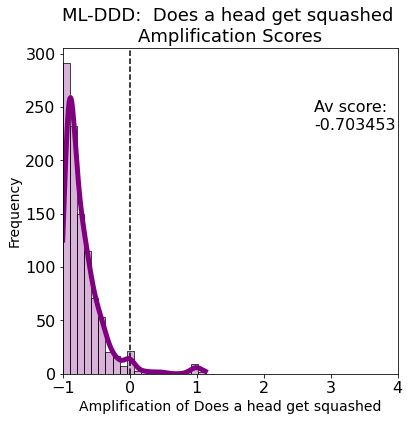

 av amp for Is there autism specific abuse: -0.9982598870967742


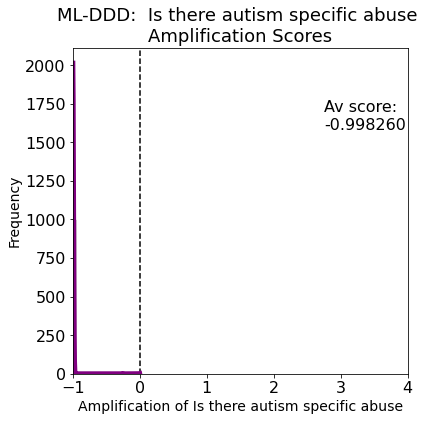

 av amp for Is there a nuclear explosion: -0.7589162554232558


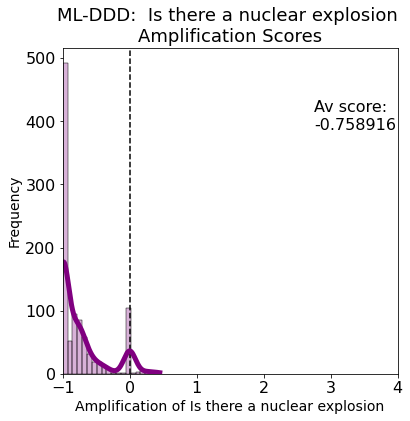

 av amp for Is there a hospital scene: -0.7868820168276385


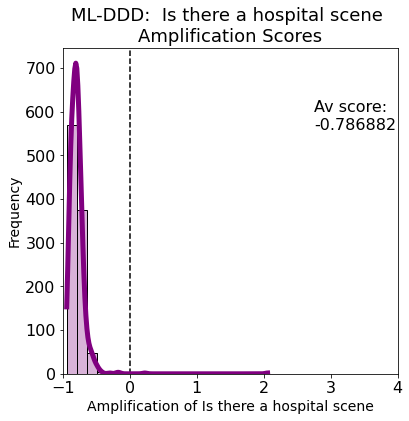

 av amp for Does a plane crash: -0.8241212165431729


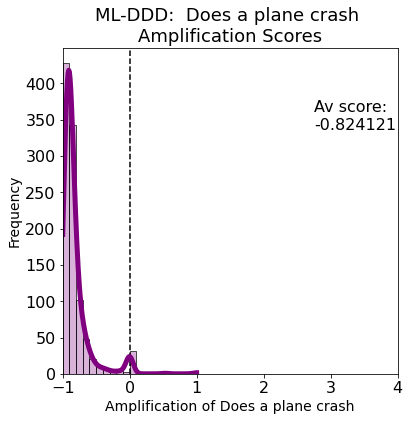

 av amp for Is a child's toy destroyed: -0.335434561332044


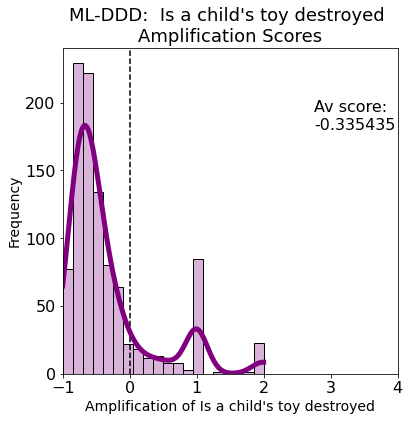

 av amp for Does someone use drugs: -0.71223215399541


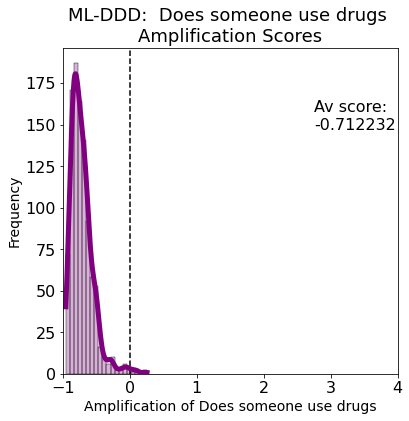

 av amp for Is there ableist language or behavior: -0.7562429670437326


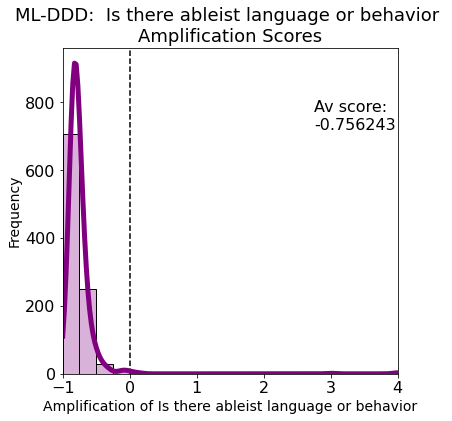

 av amp for Are there fat suits: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


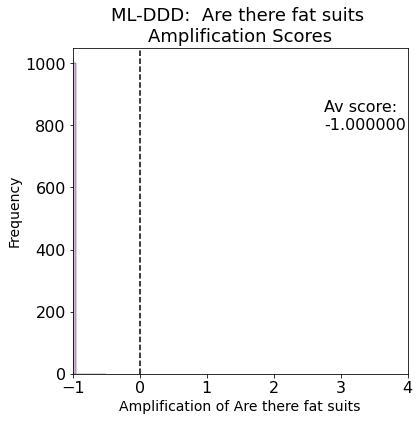

 av amp for Does the black guy die first: -0.9656207251516693


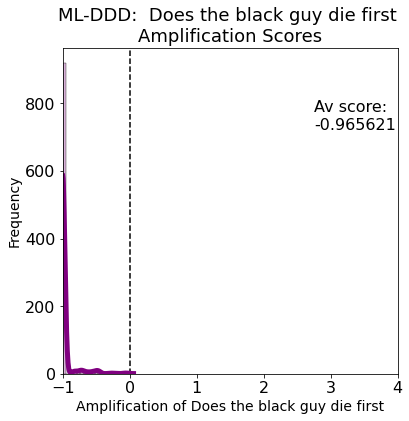

 av amp for Are there jumpscares: -0.6524509473419059


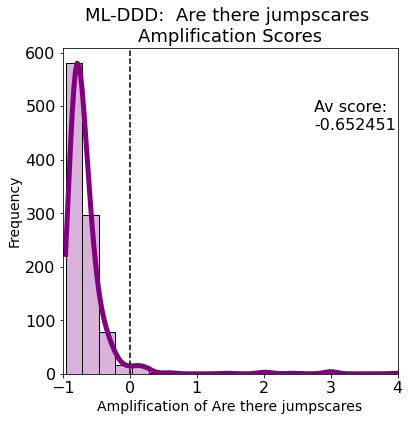

 av amp for Is there D.I.D. misrepresentation: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


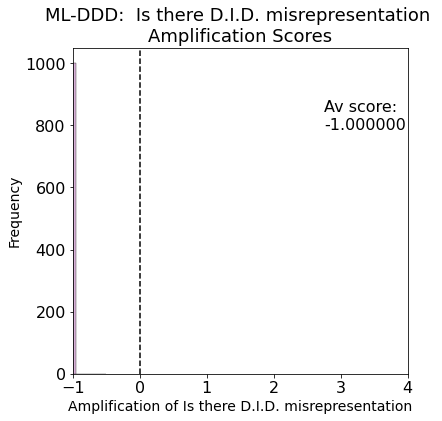

 av amp for Is electro-therapy used: -0.9771142833182144


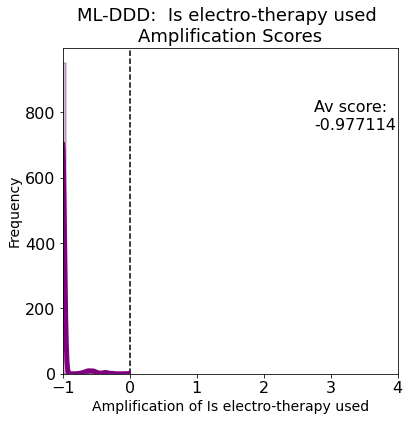

 av amp for Are animals abused: -0.8571163711344856


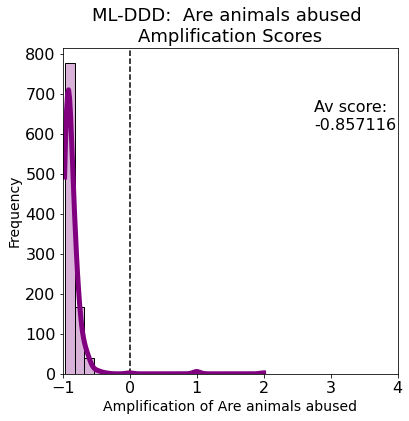

 av amp for Does someone have a stroke: -0.48595166666666667


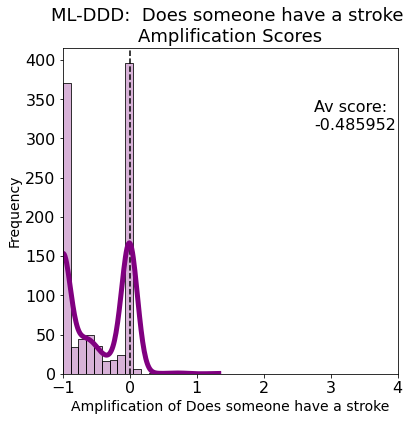

 av amp for Is there bisexual cheating: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


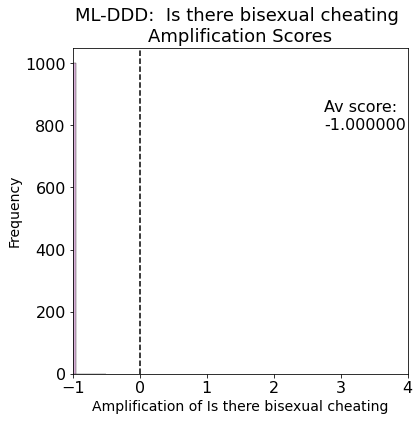

 av amp for Is there body dysmorphia: -0.46584206141614537


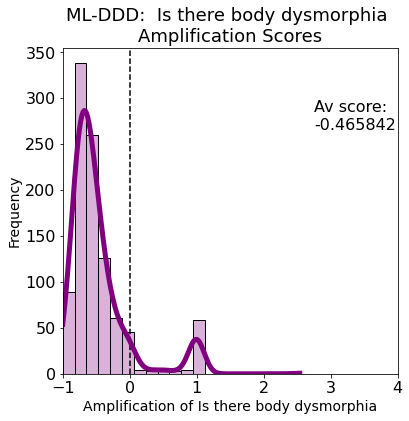

 av amp for Is someone sexually objectified: -0.8241394114583612


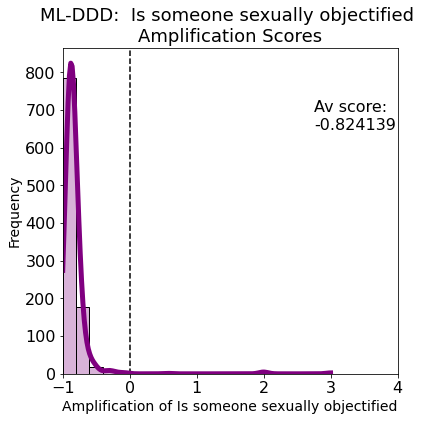

 av amp for Is the fourth wall broken: -0.9936818057307807


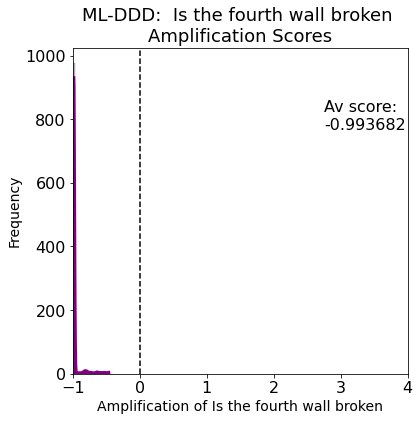

 av amp for Is someone burned alive: -0.7378828112018098


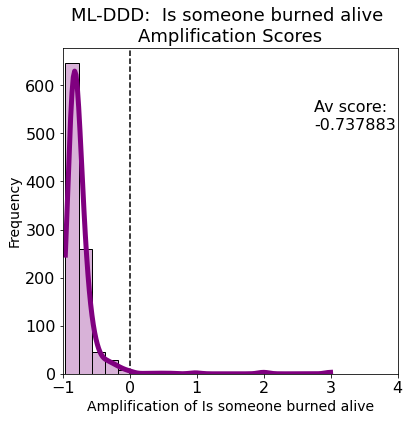

 av amp for Is there aphobia: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


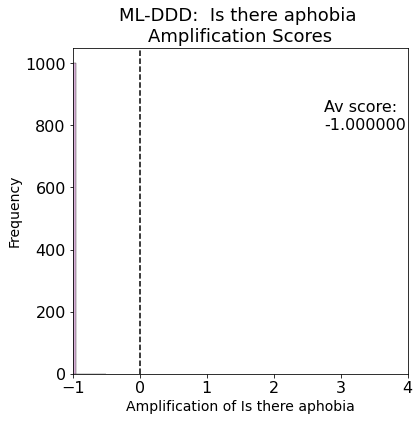

 av amp for Is there dementia/Alzheimer's: -0.4576425000000003


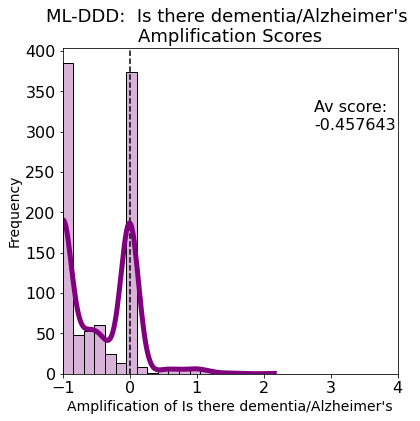

 av amp for Does someone drown: -0.8093779620835925


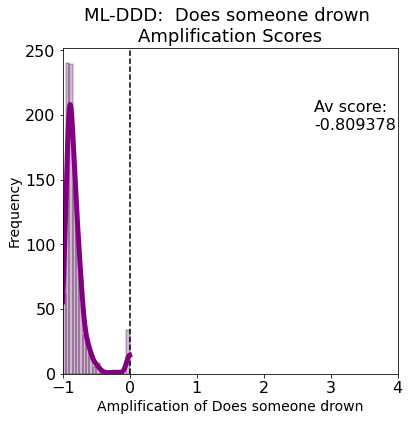

 av amp for Are there razors: -0.997334312797288


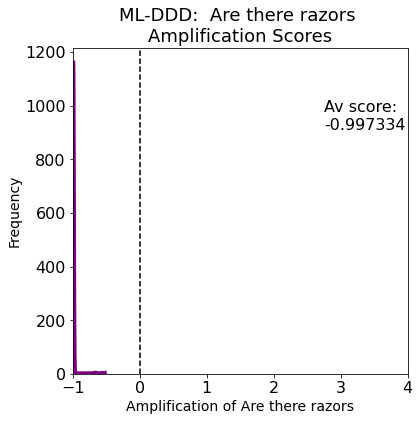

 av amp for Does a kid die: -0.5234740967797411


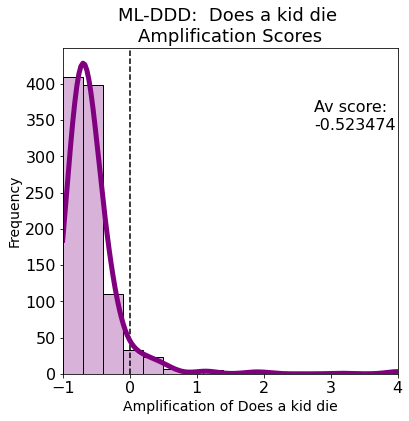

 av amp for Are there ghosts: -0.704746926972003


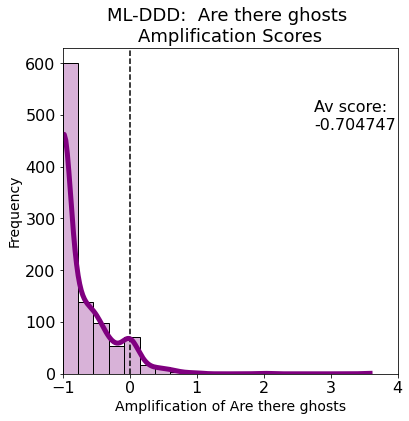

 av amp for Is there hate speech: -0.8538535823128467


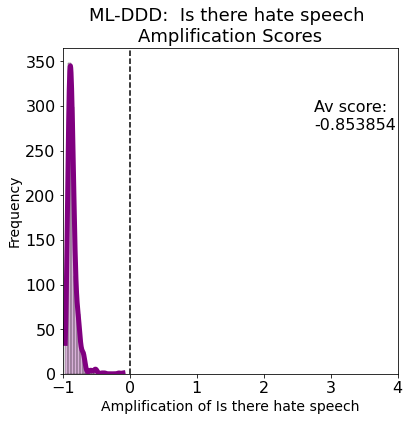

 av amp for Is a minor sexualized: -0.6644837787269717


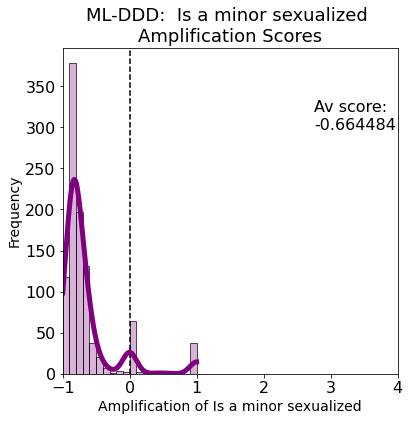

 av amp for Are there homophobic slurs: -0.7309454919858339


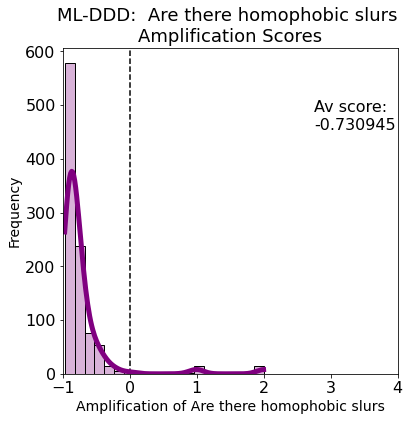

 av amp for Is there audio gore: -0.48648482686102323


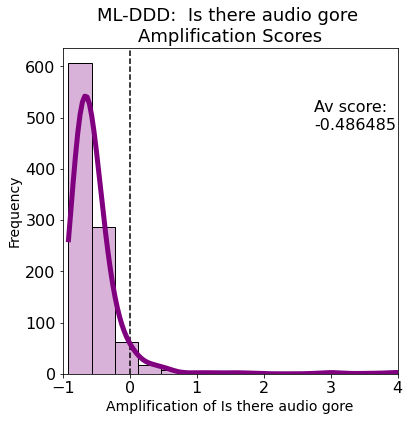

 av amp for Does someone fall down stairs: -0.6028764081915863


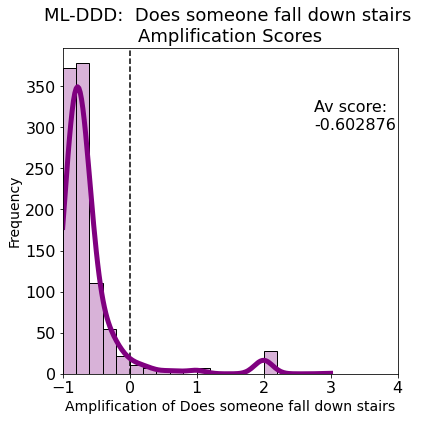

 av amp for Is someone tortured: -0.7336952084941749


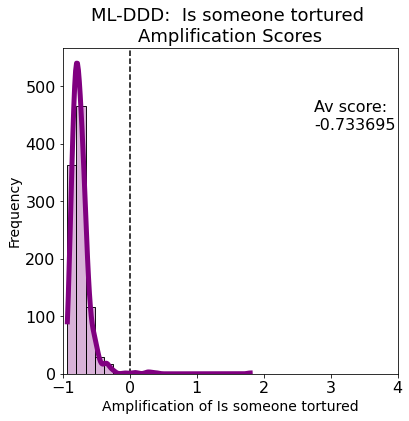

 av amp for Does a baby cry: -0.6445466671582931


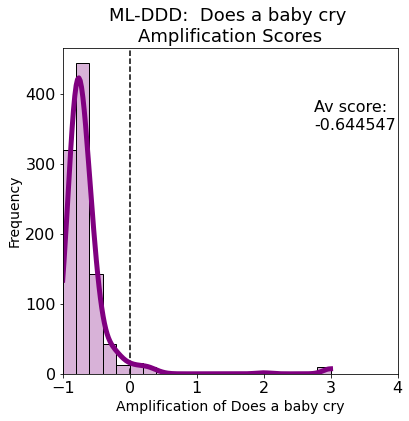

 av amp for Are there bugs: -0.7383856994417007


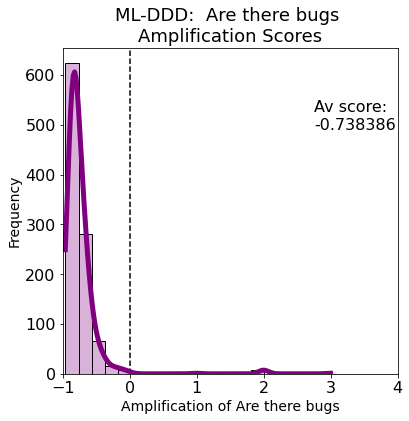

 av amp for Does a car honk or tires screech: -0.9019538861708777


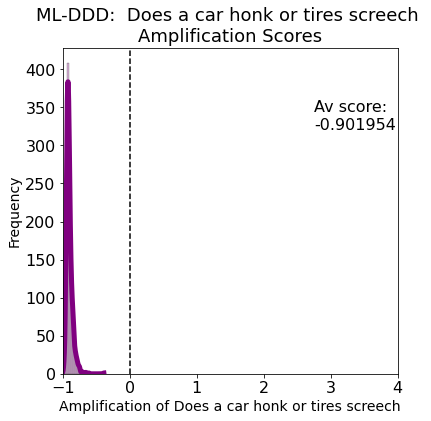

 av amp for Does someone fall to their death: -0.8734457235390851


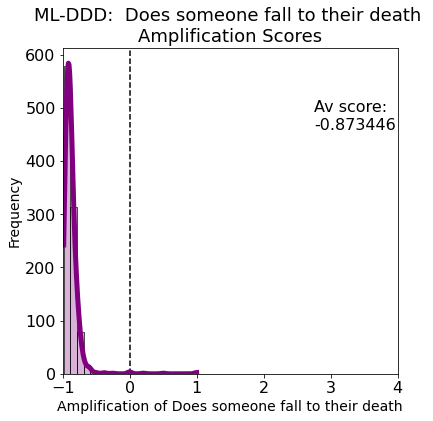

 av amp for Are there babies or unborn children: -0.9239156113315461


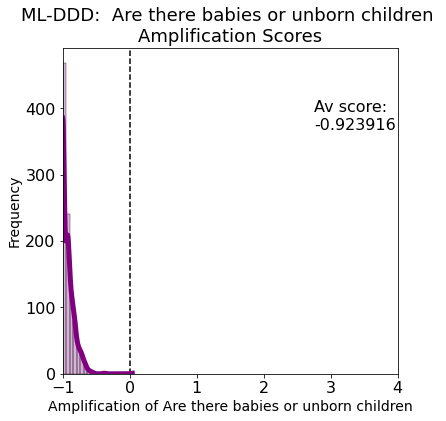

 av amp for Is there bestiality: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


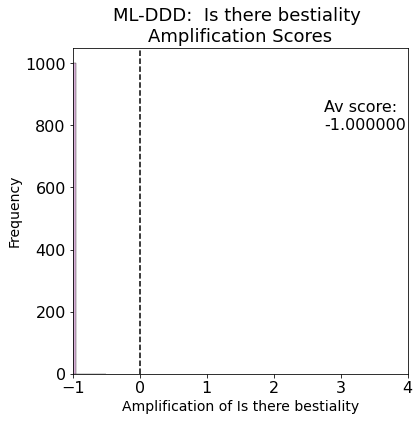

 av amp for Is there shaving/cutting: -0.66544272667965


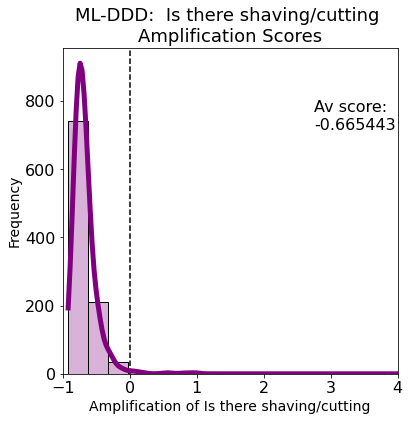

 av amp for Is there excessive gore: -0.48911441313102477


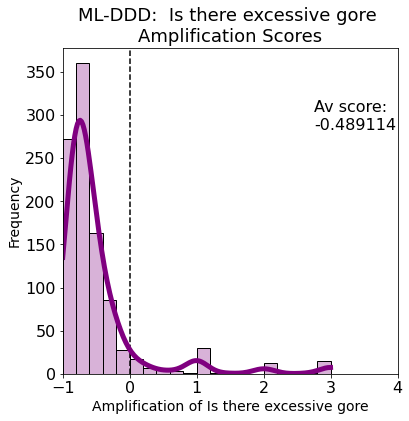

 av amp for Does someone fart or spit: -0.8745384718831396


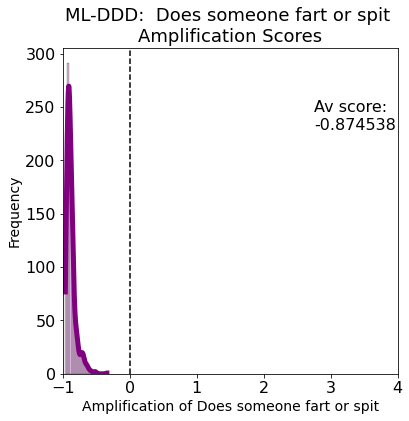

 av amp for Does a pregnant person die: -0.9604945116357327


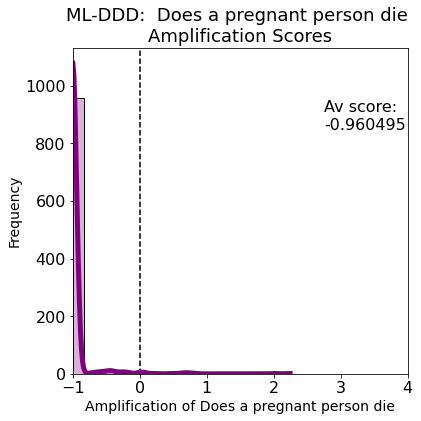

 av amp for Is there cannibalism: -0.7604393701139454


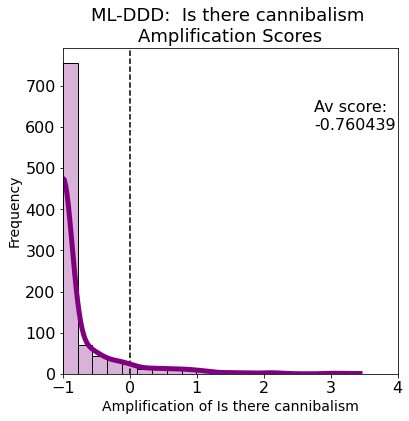

 av amp for Is someone kidnapped: -0.6644870411187277


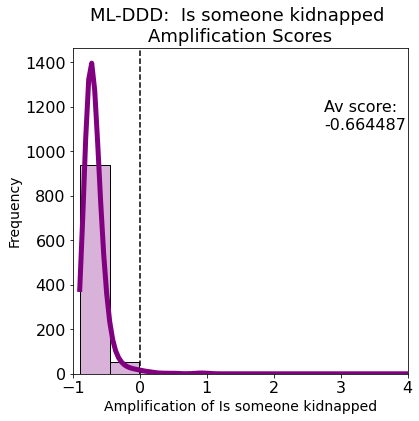

 av amp for Are there mannequins: -0.5246745743795681


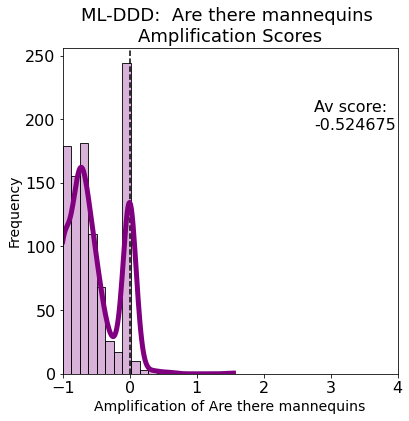

 av amp for Are needles/syringes used: -0.8102879994109704


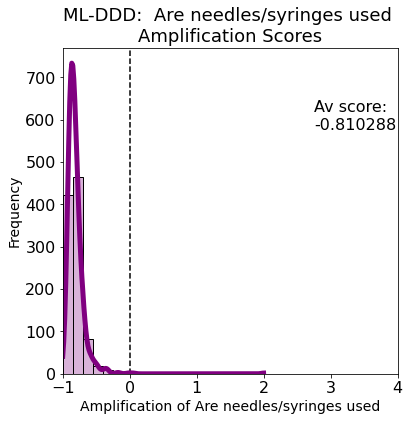

 av amp for Is someone drugged: -0.9070818518518515


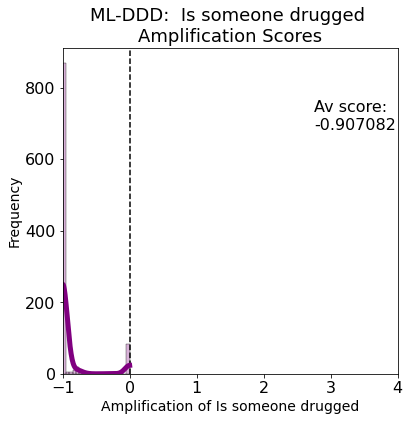

 av amp for Is someone gaslighted: -0.6348610510718431


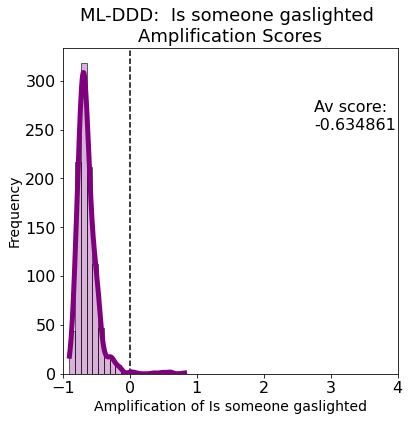

 av amp for Is an infant abducted: -0.15259384623938155


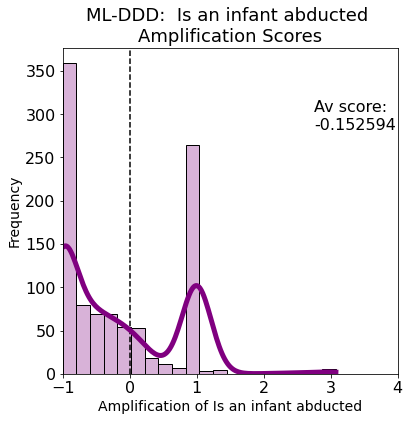

 av amp for Is someone crushed to death: -0.8485584587288575


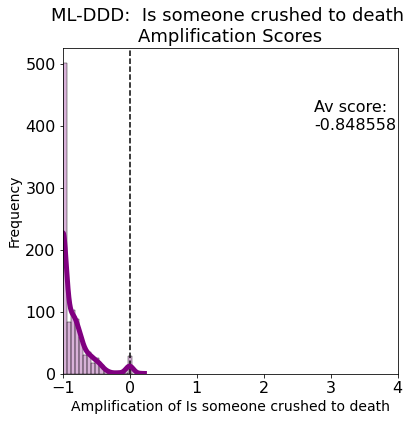

 av amp for Are there nude scenes: -0.8097524386733418


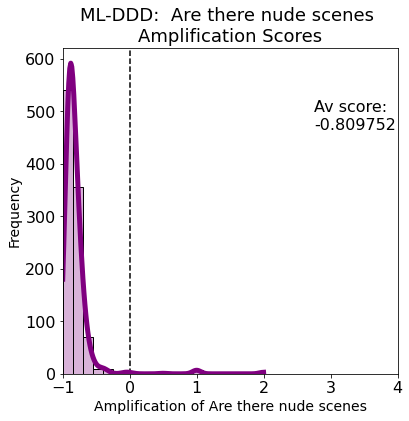

 av amp for Does it have a sad ending: -0.5586875972691467


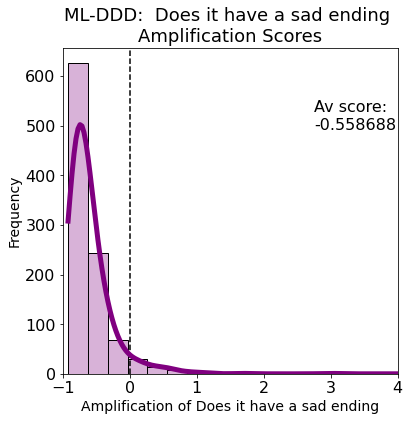

 av amp for Does someone say "I'll kill myself": -0.9488378955248248


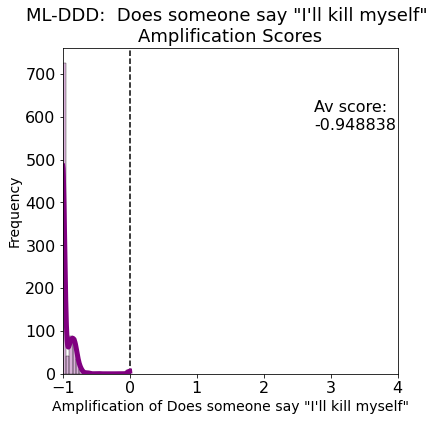

 av amp for Are there n-words: -0.6312290147503479


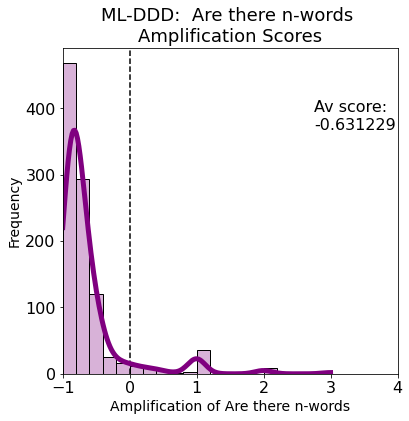

 av amp for Is someone restrained: -0.7822743731189012


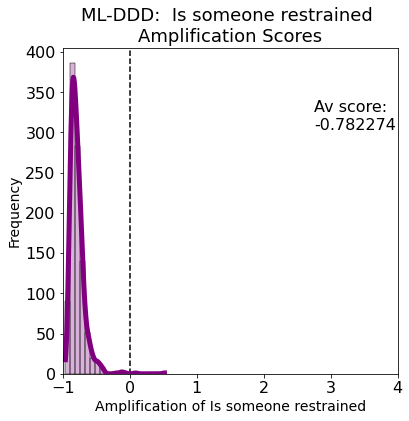

 av amp for Does a dragon die: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


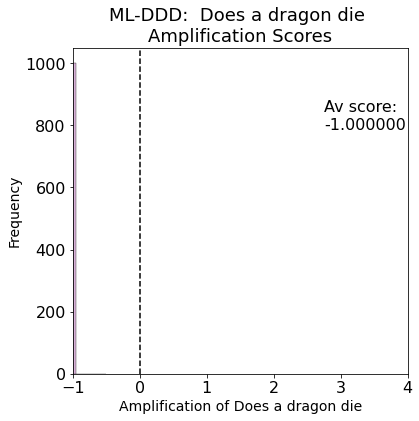

 av amp for Is there copaganda: -0.8625396154013596


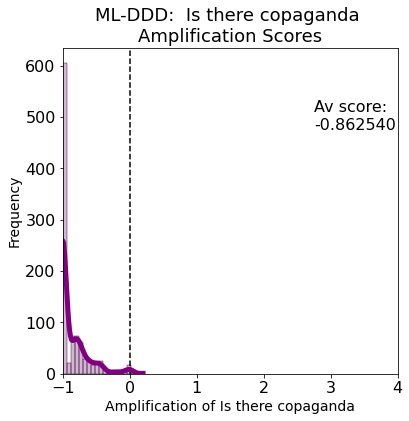

 av amp for Is there gun violence: -0.795115239331581


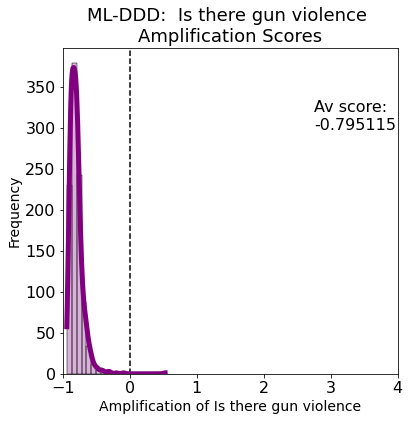

 av amp for Does someone vomit: -0.6710850145848312


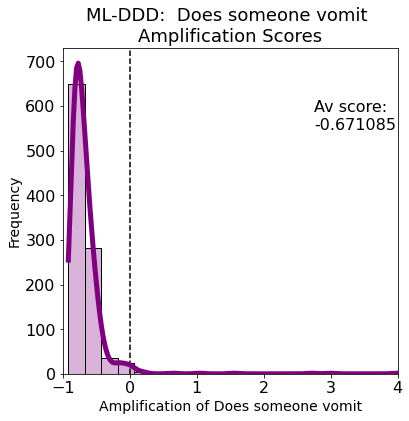

 av amp for Does an LGBT person die: -0.7938251550654282


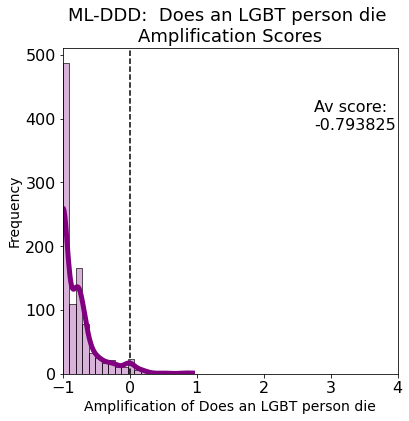

 av amp for Is someone stalked: -0.5572146428801752


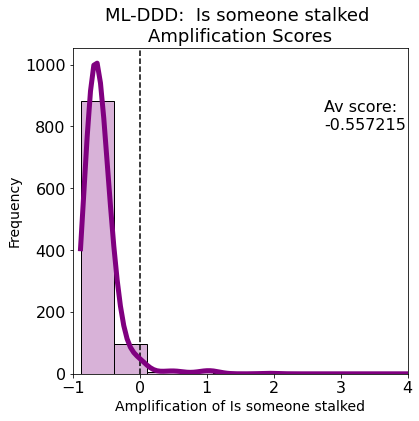

 av amp for Does a non-human character die: -1.0


/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


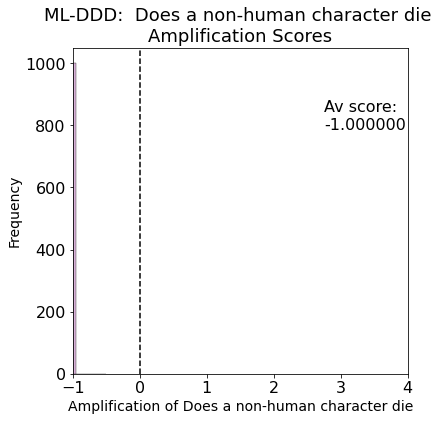

 av amp for Is there antisemitism: -0.9893461588658107


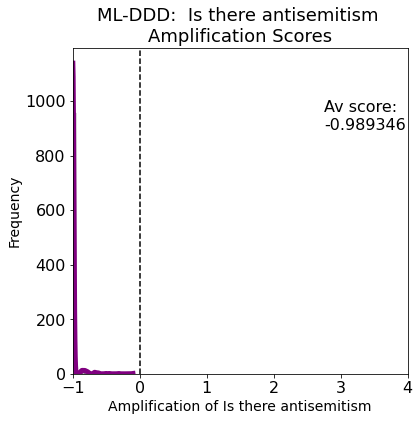

 av amp for Is there a shower scene: -0.7464124768695132


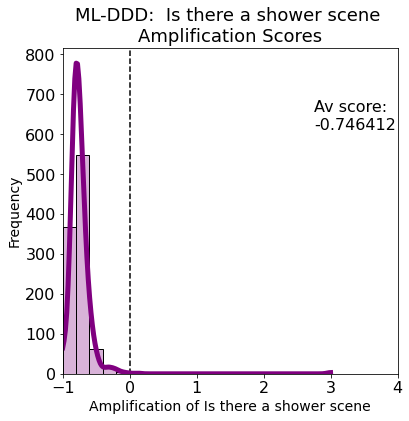

 av amp for Is Santa (et al) spoiled: -0.9504908421855921


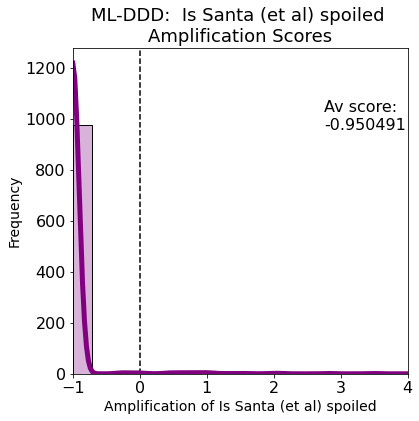

 av amp for Does someone die by suicide: -0.7963901862421354


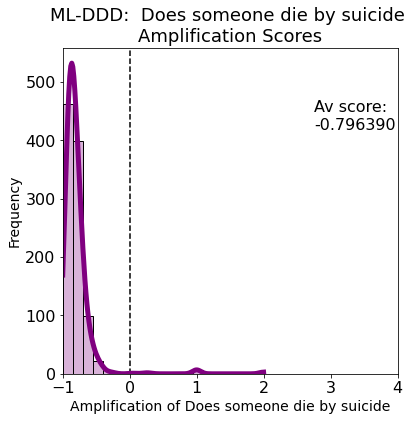

 av amp for Is a male character ridiculed for crying: -0.8978803435588053


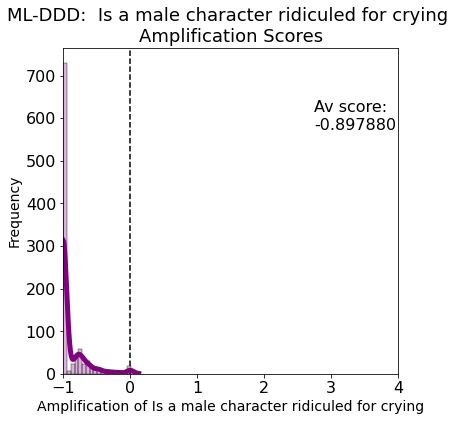

 av amp for Is someone buried alive: -0.37969224693820347


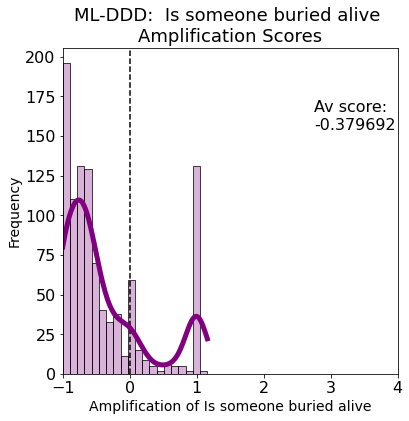

 av amp for Does someone sacrifice themselves: -0.755515365766853


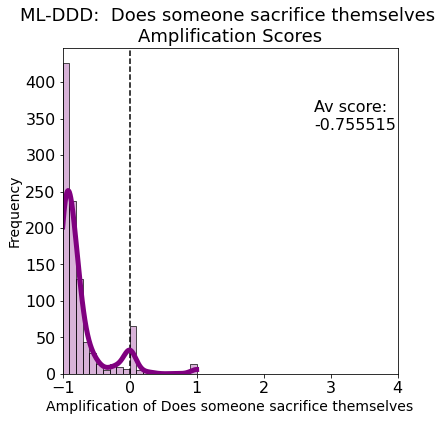

 av amp for Is there sexual content: -0.7306187847765656


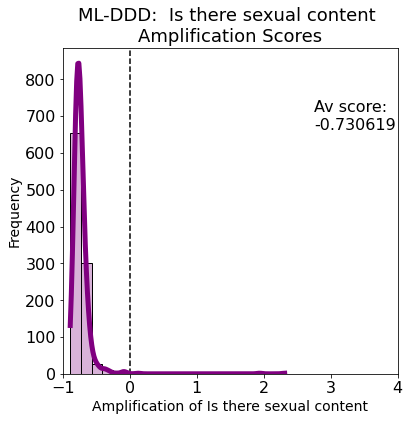

 av amp for Are there incestuous relationships: -0.9930971805836197


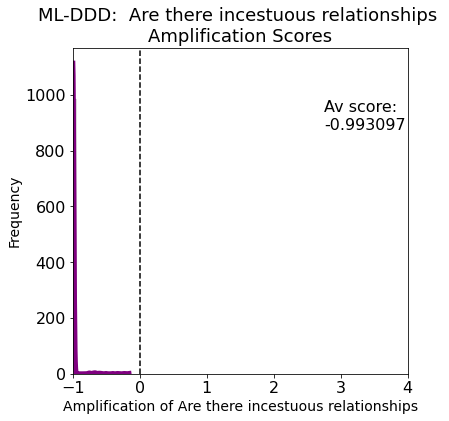

 av amp for Does someone abuse alcohol: -0.6749373507461462


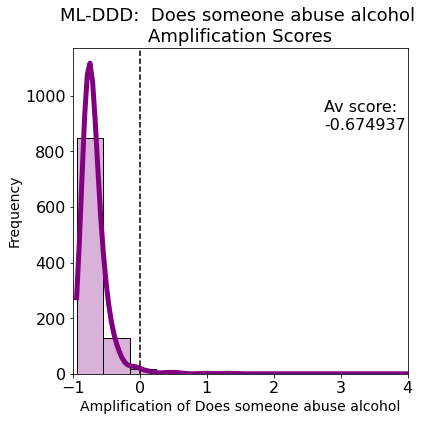

 av amp for Is a mentally ill person violent: -0.6730507473141859


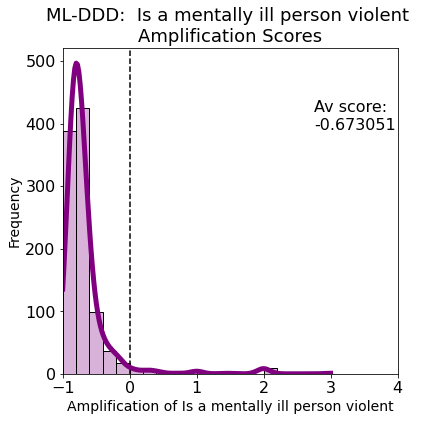

 av amp for Are there flashing lights or images: -0.5155359260751882


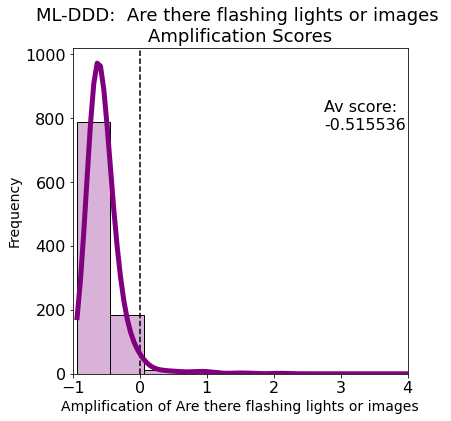

 av amp for Is someone sexually assaulted: -0.6802760434685375


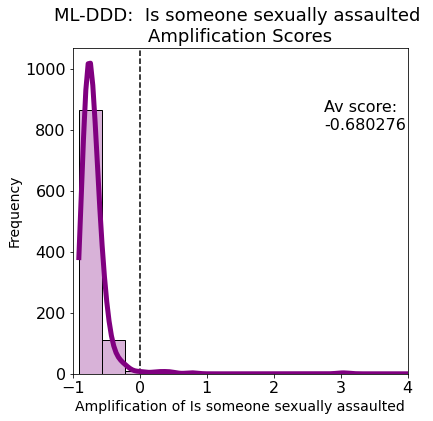

 av amp for Are there "Man in a dress" jokes: -0.780642202959334


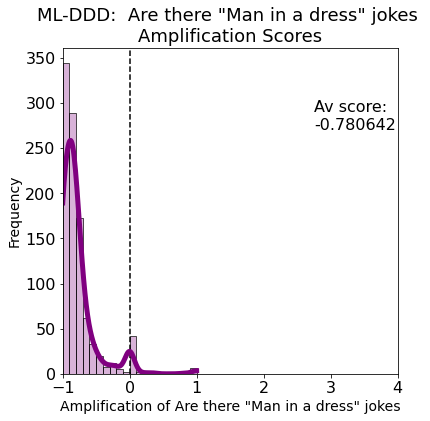

 av amp for Is there a dead animal: -0.722765723160181


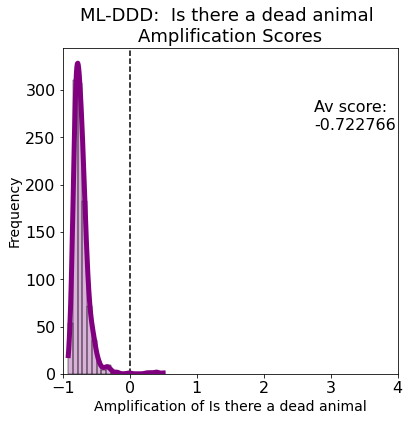

 av amp for Is someone hit by a car: -0.7848527100062194


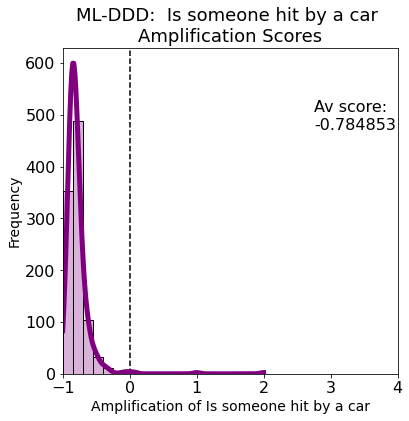

In [64]:
warning_amplification_plots(svd_amplification_dfs)

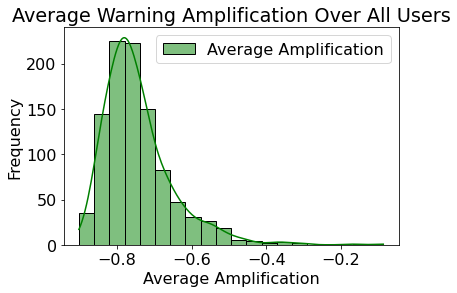

In [65]:
user_amplification_plots(svd_amplification_dfs)

### Overall

Random av amp: -0.6423345944909488
SVD av amp: -0.7444979138909966
Top Pop av amp: 0.7258862089175787


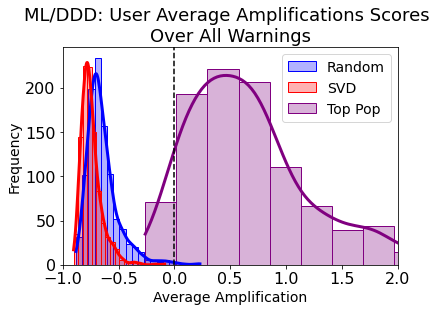

In [75]:
dms = [["Random", random_amplification_dfs, "blue"], ["SVD", svd_amplification_dfs, "red"], ["Top Pop", top_pop_amplification_dfs, "purple"]]

overlay_user_amplifications(dms)

Random av amp for Is there blood/gore: -0.6221856227676763


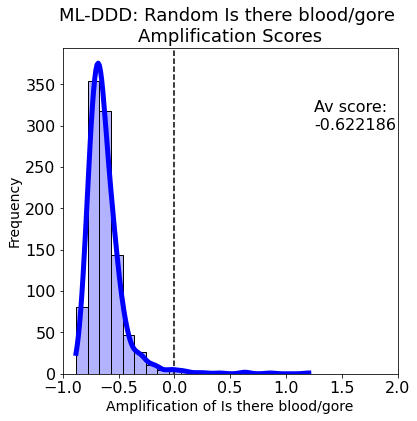

SVD av amp for Is there blood/gore: -0.7357948555399515


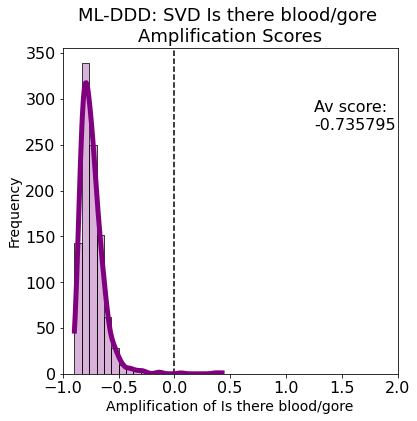

Top Pop av amp for Is there blood/gore: 0.2881515170635059


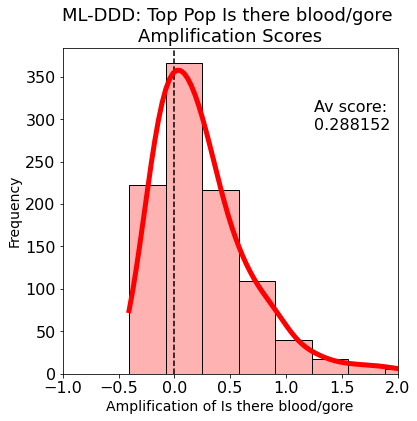

In [70]:
single_warning_amplification("Is there blood/gore", random_amplification_dfs, "Random", "blue", 2)
single_warning_amplification("Is there blood/gore", svd_amplification_dfs, "SVD", "red", 2)
single_warning_amplification("Is there blood/gore", top_pop_amplification_dfs, "Top Pop", "purple", 2)

Random av amp for Is there sexual content: -0.619881192111798


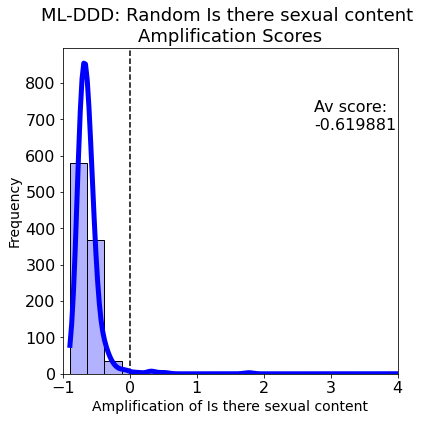

SVD av amp for Is there sexual content: -0.7306187847765656


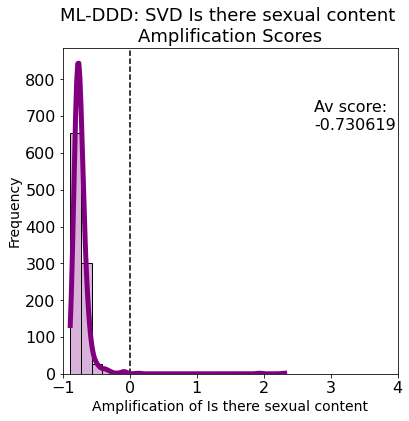

Top Pop av amp for Is there sexual content: 0.2494272186733639


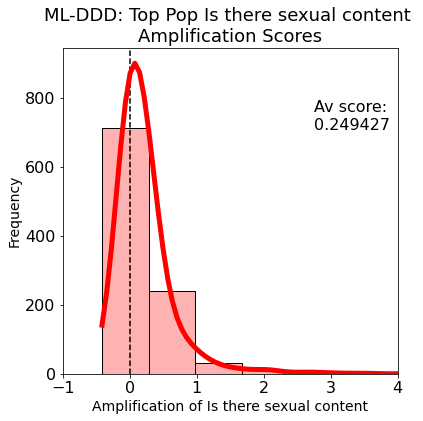

In [68]:
single_warning_amplification("Is there sexual content", random_amplification_dfs, "Random", "blue", 4)
single_warning_amplification("Is there sexual content", svd_amplification_dfs, "SVD", "purple", 4)
single_warning_amplification("Is there sexual content", top_pop_amplification_dfs, "Top Pop", "red", 4)

Random av amp for Does the dog die: -0.04091364262254545


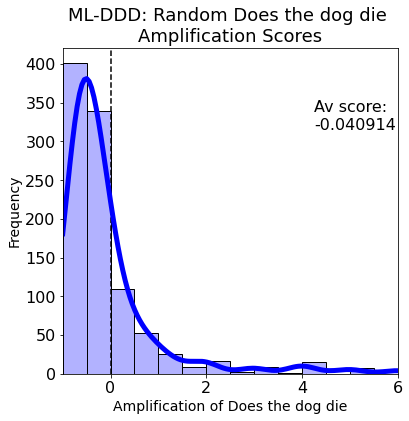

SVD av amp for Does the dog die: 0.03928078865251038


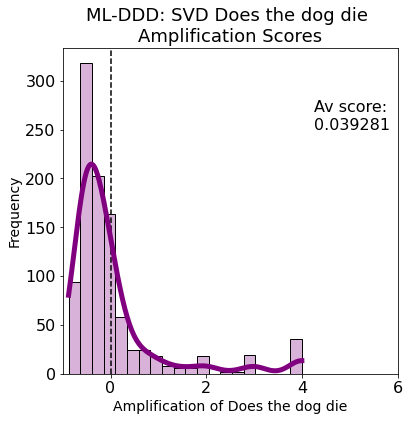

Top Pop av amp for Does the dog die: 0.46264739869529825


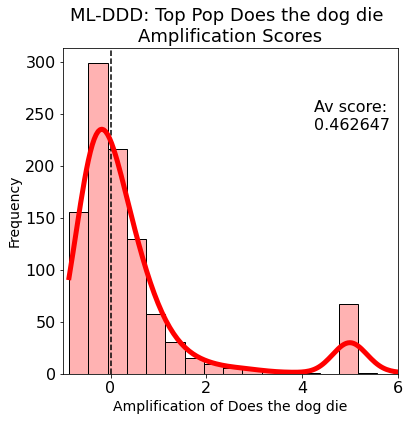

In [69]:
single_warning_amplification("Does the dog die", random_amplification_dfs, "Random", "blue", 6)
single_warning_amplification("Does the dog die", svd_amplification_dfs, "SVD", "purple", 6)
single_warning_amplification("Does the dog die", top_pop_amplification_dfs, "Top Pop", "red", 6)

In [1]:
warning = "Is there blood/gore"
fig, ax = plt.subplots(3, 1, figsize=(6,6))

# AX 0: SVD
data = pd.DataFrame(svd_amplification_dfs[svd_amplification_dfs["warning"] == warning]["data"].iloc[0])
av_amp = data["amplification_scores"].mean()
ax[0].axvline(x = 0, ymin = 0, ymax = 1, color="black", linestyle="dashed")
ax[0].set_xlim(-1, xlim)
ax[0].spines[['right', 'top']].set_visible(False)
ax[0].text(0.75, 0.75, f"Av score: \n{av_amp:2f}", transform = ax[0].transAxes, fontsize=16)
sns.histplot(data=data["amplification_scores"], bins=20, kde=True, line_kws={'lw':5}, color="purple", label='SVD', alpha=0.3, ax=ax[0])
plt.legend()

plt.title(f'ML-DDD: {name} {warning} \nAmplification Scores', fontsize=18)
plt.xlabel(f'Amplification of {warning}', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

fig = plt.gcf()
plt.show()
plt.close()

NameError: name 'plt' is not defined